### Single Run - Final Run


Run on Midway3 partition caslake, the env declaration was required because tensorflow is trash and v2.18 has a breaking bug and i cant actually see the version of tensorflow in the envioronment file only the tensorflow probability version

12 is max allowed hours on caslake

./start_jupyter.sh --ram 163848 --partition caslake --tag 2024.03.1 --max_hours 12 

OOP

All training done with 3 seperate seeds and the best model is chosen on each step as the base model (sometimes radial component likes becoming nonsensical)

- Section 1: All function definitions - Folder Layout, Load Data, etc

- Section 2: Train Dense for Loss Function 
    Chose std: 0.5, see seperate PMT calibration notebook, the stds were centered on this, however, generally the data is a bit odd, the triggered flag from strax was not sufficient to filter out noise, a more sophisticated algorithm for fitting the variances is required but I dont have time for this

Section 3:
- Train Basic Radial LCE component

- Positions Refit 

- Train basics Radial LCE

Section 4:
- Train Only Wall Reflection 

- train both

- Pos refit

- Train both

- Pos Refit

- Train Both 


Section5, model Selection based on resulting Ripley-K:
- Train with anode

- Pos Refit

- Train with anode

- Pos Refit 

- Train with anode 


Currently Im leaving out the following planned layers

- Saturation 

- Top Shielding Mesh


TODO Check where the model gets worse & plot all pos refits, likely adjust anode and perp as seperate layers with perp first and continue from there, also indicatee best model

Also retrain Likelihood again it can do with some overfitting say up to 50 epochs

Wall Reflection is source of loss decrease

Also need to print average loss values during and after pos ref



In [1]:
# Quick Check to be sure
import os
print(os.getcwd())
import socket
print(socket.gethostname())
print(os.path.isdir('/scratch/midway3/fsemler'))

# Change dir
os.chdir('/scratch/midway3/fsemler')
print(os.getcwd())
print(os.listdir(os.getcwd()))

/home/fsemler
midway3-0089.rcc.local
True
/scratch/midway3/fsemler
['layer_definitions.py', '0.3.5.zip', 'Likelihood_Model.keras', 'models', 'monotonic-nn-0.3.5', 'resource_cache', 'data', 'functions.py']


# Section 1

In [2]:
"""
tfp is the wrong version in my own environment el9 or something TODO Write it out 
"""
#import subprocess
#subprocess.run(['pip install tensorflow_probability==0.23'], shell=True)
#%pip install tensorflow_probability==0.23

'\ntfp is the wrong version in my own environment el9 or something TODO Write it out \n'

In [2]:
import os
import zipfile
import urllib.request
import sys

URL = "https://github.com/airtai/monotonic-nn/archive/refs/tags/0.3.5.zip"
ZIP_NAME = "0.3.5.zip"
EXTRACTED_DIR = "/scratch/midway3/fsemler/monotonic-nn-0.3.5"

# Download if not already downloaded
"""
Just do wget urllib isnt working just times out dont think the singularity image has internet priviliges
And
unzip 0.3.5.zip -d monotonic-nn-0.3.5
"""
# Add to sys.path if not already added
if EXTRACTED_DIR not in sys.path:
    print(f"Adding {EXTRACTED_DIR} to sys.path...")
    sys.path.append(EXTRACTED_DIR)

print("Setup complete.")

Adding /scratch/midway3/fsemler/monotonic-nn-0.3.5 to sys.path...
Setup complete.


In [2]:
import tensorflow as tf
tf.keras.activations.get('exp')

ValueError: Unknown activation function 'exp' cannot be deserialized.

In [3]:
import sys, os
import socket
if socket.gethostname() == 'arch-tower':
    os.environ["XENON_CONFIG"] = "/Code/xenon.config"
#import straxen raises an error something like PID not found for tornado 
import numpy as np
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import matplotlib.pyplot as plt
# Monotonically inc/dec Dense Layer 
from airt.keras.layers import MonoDense



sys.path.append(os.path.join(os.getcwd()))

from functions import *
# Note some things are dualy defined layer definitions has the up to date
from layer_definitions import *

# Its refusing to download it so i just pasted it from a kernel where it could
pmt_pos_top = np.array([[-1.38753e+01, -6.40872e+01],[-2.08129e+01, -6.00818e+01],[-2.77506e+01, -5.60763e+01],[-3.46882e+01, -5.20709e+01],[-4.16259e+01, -4.80654e+01],[-4.85635e+01, -4.40600e+01],[-1.67313e-05, -6.40872e+01],[-6.93766e+00, -6.00818e+01],[-1.38753e+01, -5.60763e+01],[-2.08129e+01, -5.20709e+01],[-2.77506e+01, -4.80654e+01],[-3.46882e+01, -4.40600e+01],[-4.16259e+01, -4.00545e+01],[-4.85635e+01, -3.60491e+01],[-5.55012e+01, -3.20436e+01],[ 1.38753e+01, -6.40872e+01],[ 6.93763e+00, -6.00818e+01],[-1.46399e-05, -5.60763e+01],[-6.93766e+00, -5.20709e+01],[-1.38753e+01, -4.80654e+01],[-2.08129e+01, -4.40600e+01],[-2.77506e+01, -4.00545e+01],[-3.46882e+01, -3.60491e+01],[-4.16259e+01, -3.20436e+01],[-4.85635e+01, -2.80382e+01],[-5.55012e+01, -2.40327e+01],[-6.24388e+01, -2.00273e+01],[ 2.08129e+01, -6.00818e+01],[ 1.38753e+01, -5.60763e+01],[ 6.93763e+00, -5.20709e+01],[-1.25485e-05, -4.80654e+01],[-6.93766e+00, -4.40600e+01],[-1.38753e+01, -4.00545e+01],[-2.08129e+01, -3.60491e+01],[-2.77506e+01, -3.20436e+01],[-3.46882e+01, -2.80382e+01],[-4.16259e+01, -2.40327e+01],[-4.85635e+01, -2.00273e+01],[-5.55012e+01, -1.60218e+01],[-6.24388e+01, -1.20164e+01],[ 2.77506e+01, -5.60763e+01],[ 2.08129e+01, -5.20709e+01],[ 1.38753e+01, -4.80654e+01],[ 6.93763e+00, -4.40600e+01],[-1.04571e-05, -4.00545e+01],[-6.93765e+00, -3.60491e+01],[-1.38753e+01, -3.20436e+01],[-2.08129e+01, -2.80382e+01],[-2.77506e+01, -2.40327e+01],[-3.46882e+01, -2.00273e+01],[-4.16259e+01, -1.60218e+01],[-4.85635e+01, -1.20164e+01],[-5.55012e+01, -8.01092e+00],[-6.24388e+01, -4.00547e+00],[ 3.46882e+01, -5.20709e+01],[ 2.77506e+01, -4.80654e+01],[ 2.08129e+01, -4.40600e+01],[ 1.38753e+01, -4.00545e+01],[ 6.93763e+00, -3.60491e+01],[-8.36565e-06, -3.20436e+01],[-6.93765e+00, -2.80382e+01],[-1.38753e+01, -2.40327e+01],[-2.08129e+01, -2.00273e+01],[-2.77506e+01, -1.60218e+01],[-3.46882e+01, -1.20164e+01],[-4.16259e+01, -8.01091e+00],[-4.85635e+01, -4.00546e+00],[-5.55012e+01, -1.44897e-05],[-6.24388e+01,  4.00544e+00],[ 4.16259e+01, -4.80654e+01],[ 3.46882e+01, -4.40600e+01],[ 2.77506e+01, -4.00545e+01],[ 2.08129e+01, -3.60491e+01],[ 1.38753e+01, -3.20436e+01],[ 6.93764e+00, -2.80382e+01],[-6.27423e-06, -2.40327e+01],[-6.93765e+00, -2.00273e+01],[-1.38753e+01, -1.60218e+01],[-2.08129e+01, -1.20164e+01],[-2.77506e+01, -8.01091e+00],[-3.46882e+01, -4.00546e+00],[-4.16259e+01, -1.08673e-05],[-4.85635e+01,  4.00544e+00],[-5.55011e+01,  8.01089e+00],[-6.24388e+01,  1.20163e+01],[ 4.85635e+01, -4.40600e+01],[ 4.16259e+01, -4.00545e+01],[ 3.46882e+01, -3.60491e+01],[ 2.77506e+01, -3.20436e+01],[ 2.08129e+01, -2.80382e+01],[ 1.38753e+01, -2.40327e+01],[ 6.93764e+00, -2.00273e+01],[-4.18282e-06, -1.60218e+01],[-6.93765e+00, -1.20164e+01],[-1.38753e+01, -8.01091e+00],[-2.08129e+01, -4.00546e+00],[-2.77506e+01, -7.24486e-06],[-3.46882e+01,  4.00544e+00],[-4.16259e+01,  8.01089e+00],[-4.85635e+01,  1.20163e+01],[-5.55011e+01,  1.60218e+01],[-6.24388e+01,  2.00272e+01],[ 4.85635e+01, -3.60491e+01],[ 4.16259e+01, -3.20436e+01],[ 3.46882e+01, -2.80382e+01],[ 2.77506e+01, -2.40327e+01],[ 2.08129e+01, -2.00273e+01],[ 1.38753e+01, -1.60218e+01],[ 6.93764e+00, -1.20164e+01],[-2.09141e-06, -8.01090e+00],[-6.93764e+00, -4.00545e+00],[-1.38753e+01, -3.62243e-06],[-2.08129e+01,  4.00545e+00],[-2.77506e+01,  8.01090e+00],[-3.46882e+01,  1.20163e+01],[-4.16259e+01,  1.60218e+01],[-4.85635e+01,  2.00272e+01],[-5.55011e+01,  2.40327e+01],[ 5.55011e+01, -3.20436e+01],[ 4.85635e+01, -2.80382e+01],[ 4.16259e+01, -2.40327e+01],[ 3.46882e+01, -2.00273e+01],[ 2.77506e+01, -1.60218e+01],[ 2.08129e+01, -1.20163e+01],[ 1.38753e+01, -8.01090e+00],[ 6.93764e+00, -4.00545e+00],[-0.00000e+00,  0.00000e+00],[-6.93764e+00,  4.00545e+00],[-1.38753e+01,  8.01090e+00],[-2.08129e+01,  1.20164e+01],[-2.77506e+01,  1.60218e+01],[-3.46882e+01,  2.00273e+01],[-4.16259e+01,  2.40327e+01],[-4.85635e+01,  2.80382e+01],[-5.55011e+01,  3.20436e+01],[ 5.55011e+01, -2.40327e+01],[ 4.85635e+01, -2.00272e+01],[ 4.16259e+01, -1.60218e+01],[ 3.46882e+01, -1.20163e+01],[ 2.77506e+01, -8.01090e+00],[ 2.08129e+01, -4.00545e+00],[ 1.38753e+01,  3.62243e-06],[ 6.93764e+00,  4.00545e+00],[ 2.09141e-06,  8.01090e+00],[-6.93764e+00,  1.20164e+01],[-1.38753e+01,  1.60218e+01],[-2.08129e+01,  2.00273e+01],[-2.77506e+01,  2.40327e+01],[-3.46882e+01,  2.80382e+01],[-4.16259e+01,  3.20436e+01],[-4.85635e+01,  3.60491e+01],[ 6.24388e+01, -2.00272e+01],[ 5.55011e+01, -1.60218e+01],[ 4.85635e+01, -1.20163e+01],[ 4.16259e+01, -8.01089e+00],[ 3.46882e+01, -4.00544e+00],[ 2.77506e+01,  7.24486e-06],[ 2.08129e+01,  4.00546e+00],[ 1.38753e+01,  8.01091e+00],[ 6.93765e+00,  1.20164e+01],[ 4.18282e-06,  1.60218e+01],[-6.93764e+00,  2.00273e+01],[-1.38753e+01,  2.40327e+01],[-2.08129e+01,  2.80382e+01],[-2.77506e+01,  3.20436e+01],[-3.46882e+01,  3.60491e+01],[-4.16259e+01,  4.00545e+01],[-4.85635e+01,  4.40600e+01],[ 6.24388e+01, -1.20163e+01],[ 5.55011e+01, -8.01089e+00],[ 4.85635e+01, -4.00544e+00],[ 4.16259e+01,  1.08673e-05],[ 3.46882e+01,  4.00546e+00],[ 2.77506e+01,  8.01091e+00],[ 2.08129e+01,  1.20164e+01],[ 1.38753e+01,  1.60218e+01],[ 6.93765e+00,  2.00273e+01],[ 6.27423e-06,  2.40327e+01],[-6.93764e+00,  2.80382e+01],[-1.38753e+01,  3.20436e+01],[-2.08129e+01,  3.60491e+01],[-2.77506e+01,  4.00545e+01],[-3.46882e+01,  4.40600e+01],[-4.16259e+01,  4.80654e+01],[ 6.24388e+01, -4.00544e+00],[ 5.55012e+01,  1.44897e-05],[ 4.85635e+01,  4.00546e+00],[ 4.16259e+01,  8.01091e+00],[ 3.46882e+01,  1.20164e+01],[ 2.77506e+01,  1.60218e+01],[ 2.08129e+01,  2.00273e+01],[ 1.38753e+01,  2.40327e+01],[ 6.93765e+00,  2.80382e+01],[ 8.36565e-06,  3.20436e+01],[-6.93763e+00,  3.60491e+01],[-1.38753e+01,  4.00545e+01],[-2.08129e+01,  4.40600e+01],[-2.77506e+01,  4.80654e+01],[-3.46882e+01,  5.20709e+01],[ 6.24388e+01,  4.00547e+00],[ 5.55012e+01,  8.01092e+00],[ 4.85635e+01,  1.20164e+01],[ 4.16259e+01,  1.60218e+01],[ 3.46882e+01,  2.00273e+01],[ 2.77506e+01,  2.40327e+01],[ 2.08129e+01,  2.80382e+01],[ 1.38753e+01,  3.20436e+01],[ 6.93765e+00,  3.60491e+01],[ 1.04571e-05,  4.00545e+01],[-6.93763e+00,  4.40600e+01],[-1.38753e+01,  4.80654e+01],[-2.08129e+01,  5.20709e+01],[-2.77506e+01,  5.60763e+01],[ 6.24388e+01,  1.20164e+01],[ 5.55012e+01,  1.60218e+01],[ 4.85635e+01,  2.00273e+01],[ 4.16259e+01,  2.40327e+01],[ 3.46882e+01,  2.80382e+01],[ 2.77506e+01,  3.20436e+01],[ 2.08129e+01,  3.60491e+01],[ 1.38753e+01,  4.00545e+01],[ 6.93766e+00,  4.40600e+01],[ 1.25485e-05,  4.80654e+01],[-6.93763e+00,  5.20709e+01],[-1.38753e+01,  5.60763e+01],[-2.08129e+01,  6.00818e+01],[ 6.24388e+01,  2.00273e+01],[ 5.55012e+01,  2.40327e+01],[ 4.85635e+01,  2.80382e+01],[ 4.16259e+01,  3.20436e+01],[ 3.46882e+01,  3.60491e+01],[ 2.77506e+01,  4.00545e+01],[ 2.08129e+01,  4.40600e+01],[ 1.38753e+01,  4.80654e+01],[ 6.93766e+00,  5.20709e+01],[ 1.46399e-05,  5.60763e+01],[-6.93763e+00,  6.00818e+01],[-1.38753e+01,  6.40872e+01],[ 5.55012e+01,  3.20436e+01],[ 4.85635e+01,  3.60491e+01],[ 4.16259e+01,  4.00545e+01],[ 3.46882e+01,  4.40600e+01],[ 2.77506e+01,  4.80654e+01],[ 2.08129e+01,  5.20709e+01],[ 1.38753e+01,  5.60763e+01],[ 6.93766e+00,  6.00818e+01],[ 1.67313e-05,  6.40872e+01],[ 4.85635e+01,  4.40600e+01],[ 4.16259e+01,  4.80654e+01],[ 3.46882e+01,  5.20709e+01],[ 2.77506e+01,  5.60763e+01],[ 2.08129e+01,  6.00818e+01],[ 1.38753e+01,  6.40872e+01]]) 
pmt_pos_top = pmt_pos_top.astype('float32')
#pmt_pos_top = straxen.pmt_positions()[straxen.pmt_positions()['array'] == 'top'].loc[:,['x','y']].to_numpy().astype('float32')
pmt_positions = pmt_pos_top[:,0:2]
not_dead_pmts = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 157, 158, 159, 160, 161, 162, 163, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252]
dead_pmts = [28, 108, 121, 144, 156, 164, 177]
n_alive_pmts = len(not_dead_pmts)
n_pmts = len(not_dead_pmts)+len(dead_pmts)


# -------------------------------- Generate Models ----------------------------------------------#
def gen_direct_detect_model(activation_funcs = ['tanh', 'tanh', 'exponential'], dense_units = [2**4, 2**4]):
    # Generate submodels to easily extract them later
    input_1 = tf.keras.layers.Input(shape=(2,), name='xy_1', dtype=tf.float32)
    # Compute Inpute
    pmt_dim1 = tf.keras.layers.RepeatVector(n_alive_pmts, name='Repeat_to_n_pmts')(input_1)
    get_radius = GetRadius((n_alive_pmts, 1), keras.backend.variable(pmt_positions[not_dead_pmts], dtype='float32'), name='Event_PMT_distance')
    get_radius.trainable = False
    event_PMT_Dist = get_radius(pmt_dim1)
    # Flatten so that each element gets the same operations applied
    x_PMT_dist = FlattenArray(name='Flatten_PMT_Dist')(event_PMT_Dist)
    # Do Network
    if dense_units[0] is not None:
        #x_PMT_dist = keras.layers.Dense(dense_units[0], activation=activation_funcs[0], name="PMT_dist_dense_1")(x_PMT_dist)
        x_PMT_dist = MonoDense(dense_units[0], 
                               activation='tanh', 
                               is_convex = False, 
                               is_convcave = False, 
                               monotonicity_indicator = [1],# 1 increasing, -1 non increasing, 0 non monotonic
                               name="PMT_dist_dense_1")(x_PMT_dist)
    if dense_units[1] is not None:
        #x_PMT_dist = keras.layers.Dense(dense_units[1], activation=activation_funcs[1], name="PMT_dist_dense_2")(x_PMT_dist)
        x_PMT_dist = MonoDense(dense_units[1], 
                               activation='tanh', 
                               is_convex = False, 
                               is_convcave = False, 
                               monotonicity_indicator = [1],# 1 increasing, -1 non increasing, 0 non monotonic
                               name="PMT_dist_dense_2")(x_PMT_dist)
    if activation_funcs[2] is not None:
        x_PMT_dist = MonoDense(1, 
                               activation=tf.math.exp, 
                               is_convex = True, 
                               is_convcave = False, 
                               monotonicity_indicator = [-1],# 1 increasing, -1 non increasing, 0 non monotonic
                               name="PMT_dist_dense_2")(x_PMT_dist)
        #x_PMT_dist = keras.layers.Dense(1  , activation=activation_funcs[2], name="PMT_dist_dense_3")(x_PMT_dist)
    # Reshape And Normalize
    x_PMT_dist = ReshapeArray(n_alive_pmts, name='PMTDist_Reshape')(x_PMT_dist)
    x_PMT_dist = NormalizationLayer(name='PMT_dist_norm')(x_PMT_dist)
    model_PMT_Dist = tf.keras.Model(inputs=input_1, outputs=x_PMT_dist, name="PMTDistance_Pattern_Response")
    return model_PMT_Dist


class RadialLCELayer(keras.layers.Layer):
    """Compute radial LCE
    
    Wall terms keep failing the fit 

    Input (n_patterns, n_pmts), rho
    Output (n_patterns, n_pmts) with LCE/PMT
    """
    def __init__(self, guess,**kwargs):
        super().__init__(**kwargs)
        # Decay + fudge
        self.guess = guess
        self.call = tensorflow.function(self.call)
        return 
    
    
    def lce_map(self,rho, p, d, a, b):
        # Last parameter filled role of linear addition and multiplier -> Pointless removed
        # Not sure using tensorflow funcs actually makes thsi faster or just less legible
        # also I came when i removed c to test something I+1 was easier than finding all the invocations
        return (
             tensorflow.math.divide((1 - b), tensorflow.math.pow((1 + tensorflow.math.square(rho/d)), p) )
            + tensorflow.math.multiply(a,  rho )
            + b
        )
    
    def build(self, input_shape):
        self.params = self.add_weight(
            name='lce_params', 
            shape=(len(self.guess)),
            initializer=keras.initializers.Constant(
                np.array(self.guess)),
                trainable=True)
        super().build(input_shape)
    
    def call(self, X, training=None):
        """
        Debug function as loss's are on order e16
        """
        gp = self.params
        return self.lce_map(X, gp[0],gp[1],gp[2],gp[3])

    def compute_output_shape(self, input_shape):
        return (input_shape[0], input_shape[1])

def gen_direct_detect_model_rLCE(activation_funcs = ['tanh', 'tanh', 'exponential'], dense_units = [2**4, 2**4]):
    """Added since the direct detection component always ends up predicting nonsense"""
    # Generate submodels to easily extract them later
    input_1 = tf.keras.layers.Input(shape=(2,), name='xy_1', dtype=tf.float32)
    # Compute Inpute
    pmt_dim1 = tf.keras.layers.RepeatVector(n_alive_pmts, name='Repeat_to_n_pmts')(input_1)
    get_radius = GetRadius((n_alive_pmts, 1), keras.backend.variable(pmt_positions[not_dead_pmts], dtype='float32'), name='Event_PMT_distance')
    get_radius.trainable = False
    event_PMT_Dist = get_radius(pmt_dim1)
    # Flatten so that each element gets the same operations applied
    x_PMT_dist = RadialLCELayer(guess= [1.6266745e+00,  9.4918861e+00, -4.2176653e-05,  7.7804564e-03,])(event_PMT_Dist)
    model_PMT_Dist = tf.keras.Model(inputs=input_1, outputs=x_PMT_dist, name="PMTDistance_Pattern_Response")
    return model_PMT_Dist

def gen_reflection_model(activation_funcs = ['tanh', 'tanh', 'exponential'], dense_units = [2**4, 2**4]):
    input_2 = tf.keras.layers.Input(shape=(2,), name='xy_2', dtype=tf.float32)
    # Compute Input
    get_wall_dist = GetWallDist((int(n_alive_pmts)+1, 1), keras.backend.variable(pmt_positions[not_dead_pmts], dtype='float32'), tpc_r= keras.backend.variable(66.4 , dtype='float32'),  name='Event_Wall_distance')
    get_wall_dist.trainable = False
    x_Wall_dist = get_wall_dist(input_2)
    # Do Network
    """
    if dense_units[0] is not None:
        x_Wall_dist = keras.layers.Dense(dense_units[0], activation=activation_funcs[0], name="PMT_wall_dense_1")(x_Wall_dist)
    if dense_units[1] is not None:
        x_Wall_dist = keras.layers.Dense(dense_units[1], activation=activation_funcs[1], name="PMT_wall_dense_2")(x_Wall_dist)
    if activation_funcs[2] is not None:
        x_Wall_dist = keras.layers.Dense(1,    activation=activation_funcs[2], name="PMT_wall_dense_3")(x_Wall_dist)"""
    if dense_units[0] is not None:
        #x_PMT_dist = keras.layers.Dense(dense_units[0], activation=activation_funcs[0], name="PMT_dist_dense_1")(x_PMT_dist)
        x_Wall_dist = MonoDense(dense_units[0], 
                               activation='tanh', 
                               is_convex = False, 
                               is_concave = False, 
                               monotonicity_indicator = [1,1],# 1 increasing, -1 non increasing, 0 non monotonic
                               name="PMT_wall_dense_1")(x_Wall_dist)
    if dense_units[1] is not None:
        #x_PMT_dist = keras.layers.Dense(dense_units[1], activation=activation_funcs[1], name="PMT_dist_dense_2")(x_PMT_dist)
        x_Wall_dist = MonoDense(dense_units[1], 
                               activation='tanh', 
                               is_convex = False, 
                               is_concave = False, 
                               monotonicity_indicator = [1],# 1 increasing, -1 non increasing, 0 non monotonic
                               name="PMT_wall_dense_2")(x_Wall_dist)
    if activation_funcs[2] is not None:
        x_Wall_dist = MonoDense(1, 
                               activation=tf.math.exp, 
                               is_convex = True, 
                               is_concave = False, 
                               monotonicity_indicator = [-1],# 1 increasing, -1 non increasing, 0 non monotonic
                               name="PMT_wall_dense_3")(x_Wall_dist)
    
    # Reshape And Normalize
    x_Wall_dist = ReshapeArray(n_alive_pmts, name='Wall_Reshape')(x_Wall_dist)
    x_Wall_dist = NormalizationLayer(name='Wall_dist_norm')(x_Wall_dist) 
    #x_Wall_dist = keras.layers.Lambda(lambda X: X/(tf.reduce_mean(X, axis=1, keepdims=True)+1e-9))(x_Wall_dist)
    model_Wall_Dist = tf.keras.Model(inputs=input_2, outputs=x_Wall_dist, name="Wall_Reflection_Pattern_Response")
    return model_Wall_Dist

def gen_perp_model(activation_funcs = ['relu', 'relu', 'sigmoid'], dense_units = [2**4, 2**4]):
    input_3 = tf.keras.layers.Input(shape=(2,), name='xy_3', dtype=tf.float32)
    # Compute Input (batch, n_pmts)
    get_perp_inputs = PerpendicularWire_Parametrization(pmt_pos_top[not_dead_pmts], pmt_r=7.62 / 2 , name='Perp_Parametrization')
    get_perp_inputs.trainable = False
    anode_in = get_perp_inputs(input_3)
    #x_anode = keras.layers.Reshape((246,2))(anode_in)
    # Do Network
    x_anode = keras.layers.Dense(dense_units[0],        activation=activation_funcs[0], name="perp_dense_1")(anode_in)
    x_anode = keras.layers.Dense(dense_units[1],        activation=activation_funcs[1], name="perp_dense_2")(x_anode)
    x_anode = keras.layers.Dense(1,                     activation=activation_funcs[2], name="perp_dense_3")(x_anode)
    # Reshape And Normalize
    x_anode = keras.layers.Reshape((246,), name="Perp_Reshape")(x_anode)
    x_anode = NormalizationLayer(name='Perp_norm')(x_anode)
    model_anode = tf.keras.Model(inputs=input_3, outputs=x_anode, name="PerpendicularWire_Pattern_Response")
    return model_anode

def gen_anode_model(activation_funcs = ['relu', 'relu', 'sigmoid'], dense_units = [2**4, 2**4]):
    input_3 = tf.keras.layers.Input(shape=(2,), name='xy_3', dtype=tf.float32)
    # Compute Input (batch, n_pmts)
    get_anode_inputs = Anode_Parametrization(pmt_pos=pmt_pos_top[not_dead_pmts], pmt_r=7.62 / 2 , name='Anode_Parametrization')
    get_anode_inputs.trainable = False
    anode_in = get_anode_inputs(input_3)
    #anode_in = input_3
    #x_anode = keras.layers.Reshape((246,2))(anode_in)
    # Do Network
    x_anode = keras.layers.Dense(dense_units[0],        activation=activation_funcs[0], name="anode_dense_1")(anode_in)
    x_anode = keras.layers.Dense(dense_units[1],        activation=activation_funcs[1], name="anode_dense_2")(x_anode)
    x_anode = keras.layers.Dense(1,                     activation=activation_funcs[2], name="anode_dense_3")(x_anode)
    x_anode = ReshapeArray(n_alive_pmts, name='Anode_Reshape')(x_anode)
    # Reshape And Normalize
    #x_anode = keras.layers.Reshape((246,))(x_anode)
    x_anode = NormalizationLayer(name='Anode_norm')(x_anode)
    model_anode = tf.keras.Model(inputs=input_3, outputs=x_anode, name="Anode_Pattern_Response")
    return model_anode





# -------------------------------- Generate Models ----------------------------------------------#
def check_layer_exists(model, layer_name):
    for layer in model.layers:
        if layer.name == layer_name:
            return True
    return False


def gen_model(seed=0, use_radial_lce = True, starting_model=None, include_wall = False, include_perp = False, include_anode = False):
    """
    Generates all models in every possible Configuration
    """
    # Quick input verfification
    if include_anode:
        assert include_perp, "If you want to include anode you need to include perpendicular"
        assert include_wall, "If you want to include anode you need to include wall"
    if include_perp:
        assert include_wall, "If you want to include perpendicular you need to include wall"

    # Set Seed
    tf.keras.utils.set_random_seed(seed)

    # Inputs  
    input_xy = tf.keras.layers.Input(shape=(2,), name='xy', dtype=tf.float32)
    input_pattern = tf.keras.layers.Input(shape=(246,), name='pattern', dtype=tf.float32)

    # Direct Detection
    if not use_radial_lce:
        x_PMT_dist_ =  gen_direct_detect_model(activation_funcs = ['tanh', 'tanh', 'exponential'], dense_units = [2**4, 2**4])
    else:
        x_PMT_dist_ = gen_direct_detect_model_rLCE()
    if starting_model is not None:
        if check_layer_exists(starting_model, 'PMTDistance_Pattern_Response'):
            # Now there may be two different groupings
            try:
                x_PMT_dist_.set_weights(starting_model.get_layer('PMTDistance_Pattern_Response').get_weights())
            except:
                pass
    to_be_multiplied = [x_PMT_dist_(input_xy)]

    # Reflection
    if include_wall:
        x_Wall_dist_ = gen_reflection_model(activation_funcs = ['tanh', 'tanh', 'exponential'], dense_units = [2**4, 2**4])
        if starting_model is not None:
            if check_layer_exists(starting_model, 'Wall_Reflection_Pattern_Response'):
                x_Wall_dist_.set_weights(starting_model.get_layer('Wall_Reflection_Pattern_Response').get_weights())
        to_be_multiplied += [x_Wall_dist_(input_xy)]
        
    # Perpendicular
    if include_perp:
        x_perp_ = gen_perp_model(activation_funcs = ['relu', 'relu', 'sigmoid'], dense_units = [2**4, 2**4])
        if starting_model is not None:
            if check_layer_exists(starting_model, 'PerpendicularWire_Pattern_Response'):
                x_perp_.set_weights(starting_model.get_layer('PerpendicularWire_Pattern_Response').get_weights())
        to_be_multiplied += [x_perp_(input_xy)]

    # Anode
    if include_anode:
        x_anode_ = gen_anode_model(activation_funcs = ['relu', 'relu', 'sigmoid'], dense_units = [2**4, 2**4])
        if starting_model is not None:
            if check_layer_exists(starting_model, 'Anode_Pattern_Response'):
                x_anode_.set_weights(starting_model.get_layer('Anode_Pattern_Response').get_weights())
        to_be_multiplied += [x_anode_(input_xy)]

    # Combine Each Contribution 
    mult = MultiplicationLayer((246, ), 
                                include_wall=include_wall,
                                include_perp=include_perp,
                                include_anode=include_anode, 
                                name='MultiplicationLayer')
    if starting_model is not None:
        if check_layer_exists(starting_model, 'MultiplicationLayer'):
            mult.set_weights(starting_model.get_layer('MultiplicationLayer').get_weights())
    mult = mult(to_be_multiplied) 

    # I0 Layer
    i0out = I0Layer(n_alive_pmts, init_val=1, name='i0')(mult)

    # Normalize
    pattern = NormalizationLayer(name='normalization')(i0out)

    # Add Loss layer
    res = LossLayerWDense(model_path="Likelihood_Model.keras", switching_signal=40)(pattern,input_pattern)
    
    model = tf.keras.Model(inputs=(input_xy, input_pattern), outputs=res)

    return model 


# -------------------------------- Miscellaneous ----------------------------------------------#

def do_grid_search(pos, pattern, model, min_resolution):
    new_pos = pos.copy()
    floss = np.mean(model.predict({'xy':new_pos, 'pattern':pattern}), axis=-1)
    factor = 0
    while (1/(2**factor)) >= min_resolution:
        for i in [-1,0,1]:
            for j in [-1,0,1]:
                loss = np.mean(model.predict({'xy':new_pos+(np.array([[i,j]])/(2**factor)), 'pattern':pattern}), axis=-1)
                bmap = loss < floss
                new_pos[bmap] += np.array([i, j]) / (2**factor)
                floss[bmap] = loss[bmap]
        factor += 1
    return new_pos

def make_encoder(model, x, y):
    n_to_update = len(x)
    input_x = keras.layers.Input(shape=(1,))
    # Position embedding
    m = keras.layers.Embedding(n_to_update, 2, input_length = 1, name='embed_pos')(input_x)
    # Pattern Embedding
    pat = keras.layers.Embedding(n_to_update, n_alive_pmts, input_length = 1, name='embed_pat')(input_x)
    m = keras.layers.Flatten()(m)
    pat = keras.layers.Flatten()(pat)
    m = model({'xy': m, 'pattern':pat})
    rlce_encoder = keras.models.Model(inputs= input_x, outputs=m, name="Position_Updater")
    # radial mc 
    rlce_encoder.layers[-1].trainable = False
    rlce_encoder.get_layer('embed_pos').set_weights([x])
    rlce_encoder.get_layer('embed_pat').set_weights([y])
    rlce_encoder.get_layer('embed_pat').trainable = False
    return rlce_encoder

def train_and_update_pos(positions, patterns, model, loss_function, epochs=20, n_iter = 5, verbose=1):
    early_stopping = tensorflow.keras.callbacks.EarlyStopping(
        monitor='loss',
        restore_best_weights=False,
        patience=4,    
        min_delta=0.05,
        mode='min',    
        verbose=1      
    )
    reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
        monitor='loss', 
        mode = 'min',
        factor=0.5,     
        patience=2,     
        min_delta=0.05, 
        min_lr=1e-3,    
        verbose=1       
    )
    pos_updater = make_encoder(model, positions, patterns)
    # Inspecting the degree of change
    n_tot = len(positions)
    new_pos = tensorflow.identity(positions)
    loss    = tf.reduce_mean(model.predict({'xy': positions, 'pattern':patterns}), axis=-1)
    print(tf.math.reduce_mean(loss))
    for i in range(n_iter):
        print("Jagged iter {}".format(i))
        # tensorflow_probability requires tensorflow >= 2.16 we have == 2.15
        # Random dist gives max deviation root{2}*pmt_radius (~70% of diameter)
        noise_pos = tensorflow.identity(positions) + np.random.rand(*new_pos.numpy().shape) * 1
        # Update and fit encoder model positions
        pos_updater.get_layer('embed_pos').set_weights([noise_pos])
        # Compile and fit
        pos_updater.compile(loss= loss_function, optimizer = keras.optimizers.Adam(learning_rate=1e-1))
        pos_updater.fit(x = np.arange(n_tot), y = patterns, 
                        epochs = epochs, batch_size = 2**12,
                        callbacks=[early_stopping,reduce_lr], verbose = verbose) 
        noise_pos = pos_updater.get_layer('embed_pos').get_weights()[0]
        # Check result of new pos
        jittered_loss = tf.math.reduce_mean(pos_updater.predict(np.arange(n_tot)),axis=-1)

        better = jittered_loss < loss
        loss =    tensorflow.where(better, jittered_loss, loss) 
        print(tf.math.reduce_mean(loss))
        new_pos = tensorflow.where(tensorflow.expand_dims(better, axis=-1), noise_pos, new_pos) 

    return new_pos


def check_radial_behavior(model, plot_return = False):
    """
    Returns true if the fitted model is strictly decreasing with radius
    - Ie expected behavior for radial LCE 
    """
    r = np.linspace(0, 100, 100)
    # We have to create a submodel to extract the dense layers
    inputs = tf.keras.layers.Input(shape=(1,))
    # Pass the new input directly through the dense layers
    try:
        x = model.get_layer("PMTDistance_Pattern_Response").get_layer("PMT_dist_dense_1")(inputs)
        x = model.get_layer("PMTDistance_Pattern_Response").get_layer("PMT_dist_dense_2")(x)
        x = model.get_layer("PMTDistance_Pattern_Response").get_layer("PMT_dist_dense_3")(x)
    except:
        x = model.get_layer("PMTDistance_Pattern_Response").get_layer([i.name for i in model.get_layer("PMTDistance_Pattern_Response").layers if 'radial_lce_layer' in i.name][0])(inputs)

    # Build a testing submodel
    dense_submodel = tf.keras.Model(inputs=inputs, outputs=x)
    res = dense_submodel.predict(r)[:,0]
    if plot_return:
        return r, res
    # Check that res is strictly decreasing
    return np.all(np.diff(res) < 0) 

def check_Wall_behavior(model, plot_return = False):
    """
    Returns true if the fitted model is strictly decreasing with both distances
    - Ie expected behavior for radial LCE 
    """
    r = np.linspace(0.5, 100, 100)
    r1 = np.full_like(r, 10)

    combined = np.column_stack((r, r1))
    # We have to create a submodel to extract the dense layers
    inputs = tf.keras.layers.Input(shape=(2,))
    # Pass the new input directly through the dense layers
    x = model.get_layer("Wall_Reflection_Pattern_Response").get_layer("PMT_wall_dense_1")(inputs)
    x = model.get_layer("Wall_Reflection_Pattern_Response").get_layer("PMT_wall_dense_2")(x)
    x = model.get_layer("Wall_Reflection_Pattern_Response").get_layer("PMT_wall_dense_3")(x)

    # Build a testing submodel
    dense_submodel = tf.keras.Model(inputs=inputs, outputs=x)
    res1 = dense_submodel.predict(combined)[:,0]
    res2 = dense_submodel.predict(combined[:, [1, 0]])[:,0]
    if plot_return:
        return r, res1, res2
    # Check that res is strictly decreasing
    return (np.all(np.diff(res1) < 0) & np.all(np.diff(res2) < 0))

2025-03-23 03:13:45.695142: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-03-23 03:13:46.281535: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-23 03:13:46.281569: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-23 03:13:46.317412: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-23 03:13:46.397995: I tensorflow/core/platform/cpu_feature_guar

Instructions for updating:
experimental_relax_shapes is deprecated, use reduce_retracing instead


In [4]:
# ----------------------------- Folder Layout ----------------------------------------------#
curr_path = os.getcwd()
data_path = os.path.join(curr_path, 'data')
model_path = os.path.join(curr_path, 'models')
if not os.path.exists(model_path): os.makedirs(model_path)
pos_refit_path = os.path.join(data_path, 'pos_refit')
if not os.path.exists(pos_refit_path): os.makedirs(pos_refit_path)
# For grid search
# We want fine enough for anode shadow to be resolved so at least 0.025 cm 
# -> Using 0.015625
min_resolution = (1/2)**6
 
# -------------------------------- Load Data ----------------------------------------------#
def tmp(path):
    # SR2 Processed data 
    tmp = []
    for i in os.listdir(path):
        if not os.path.isdir(os.path.join(path, i)):
            tmp +=  [np.load(os.path.join(path, i))['arr_0']]
    tmp = np.concatenate(tmp)
    return np.column_stack([tmp['s2_x_cnf'], tmp['s2_y_cnf']]), tmp['s2_area_per_channel'][:,not_dead_pmts]

pos, patterns = tmp(data_path)

# Filter obious faulty
bmap = ((patterns<0).any(axis=1) | np.all(np.isclose(patterns, patterns[:,0,None]), axis=1))
pos = pos[~bmap]
patterns = patterns[~bmap]
np.save(os.path.join(pos_refit_path, 'negative_bmap.npy'), bmap)


tf.keras.mixed_precision.set_global_policy('float32')
n = len(pos)
indices = np.arange(n)
np.random.shuffle(indices)

np.save(os.path.join(pos_refit_path, 'n_shuffled.npy'), indices)

train_split = 0.8
train_idx = indices[:int(train_split*n)]
val_idx = indices[int(train_split*n):]


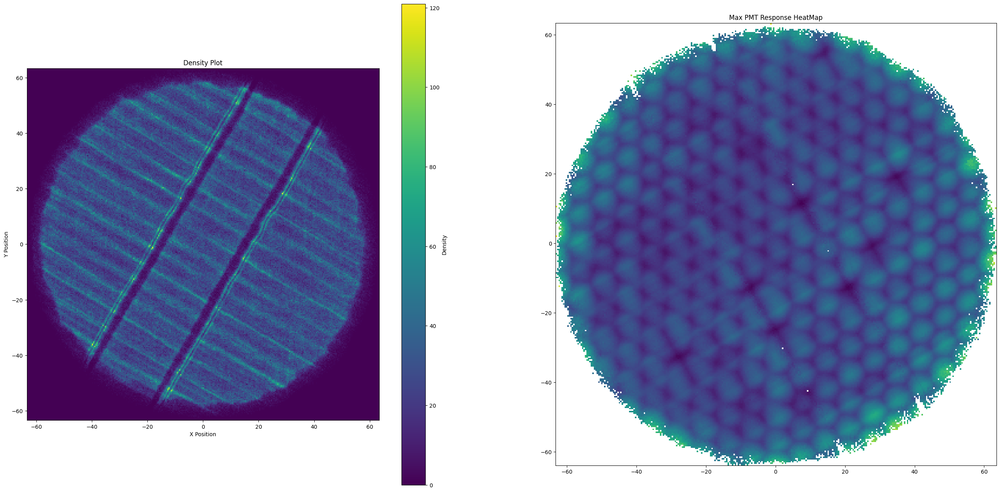

In [9]:
fig, ax = plt.subplots(1,2, figsize=(32,16))

do_density_plot(ax=ax[0], pos=pos, bins=300, title="Density Plot")
# Do maximum PMT ratio plot
def tmp():
    from scipy.stats import binned_statistic_2d
    tmp_patterns = np.max(patterns.astype('float32') / np.sum(patterns.astype('float32'), axis=-1, keepdims= True), axis=-1)
    ret = binned_statistic_2d(pos[:,0],pos[:,1], tmp_patterns, bins=300)
    ax[1].imshow(ret.statistic.T, extent=[ret.x_edge[0], ret.x_edge[-1],ret.y_edge[0], ret.y_edge[-1]])
    ax[1].set_title("Max PMT Response HeatMap")
tmp()

# Section 2

Train Likelihood Dense Network

In [14]:
import numpy as np
import scipy.stats as stats
p_dpe = 0.2
sigma_1pe = 0.5
min_pe = 0

def truncnorm_pdf(x, mean=1, std=sigma_1pe, left_clip=min_pe):
    # Truncated normal dist|
    return stats.truncnorm.pdf(
        x,
        (left_clip - mean)/std, float('inf'),
        loc=mean, scale=std)

def true_pdf(x, mu, max_sigma=4, std = sigma_1pe):
    """
    Probability density function for:
    - x: Expectation
    - mu : Observation 

    Computes number of Photoelectrons and photons without double photoelectron emission 

    Creates integer lists to compute likelihoods for each integer position within sigma for each

    Computes the truncated norm PDF for the observed signal vs each possible expected mean and standard deviation pair

    Does the same for Binomial for double photoelectron emission for difference photon to photelectron

    And for Poisson distribution of observed photons 

    Sums the entire thing after multiplication 
    """
    # Full dist
    n_pe_mle = np.clip(x, 0, None)
    n_ph_mle = np.clip(x / (1 + p_dpe), 0, None)
    
    n_ph = np.arange(1, n_ph_mle + max_sigma * n_ph_mle**0.5 + 2).reshape(-1, 1)
    n_pe = np.arange(1, n_pe_mle + max_sigma * n_pe_mle**0.5 + 2).reshape(1, -1)
    
    a = truncnorm_pdf(x, mean=n_pe, std=std * n_pe**0.5)
    b = stats.binom.pmf(n_pe - n_ph, n_ph, p_dpe)
    c = stats.poisson.pmf(n_ph, mu)

    return (a * b * c).sum()

def loglikelihood_prediction_scalar(x, mu):
    """Instead of predicting the likelihood ratio lets predict log likelihood and just evaluate this twice"""
    return np.log(true_pdf(x, mu)) 

loglikelihood_prediction = np.vectorize(loglikelihood_prediction_scalar, )


def train_Dense_Model():
    x = np.linspace(0.1, 40.0, 1000, dtype=np.float32)
    X, Y = np.meshgrid(x, x)
    # Flatten
    X = X.reshape(-1,1)
    Y = Y.reshape(-1,1)
    data = np.hstack([X, Y]).astype(np.float32)
    del X, Y
    Y =np.zeros(data.shape[0])
    # Need to do this batched
    chunk_size = 100
    for i in range(0, data.shape[0], chunk_size):
        if (i + chunk_size) < data.shape[0]:
            Y[i:i+chunk_size] = loglikelihood_prediction(data[i:i+chunk_size,0], data[i:i+chunk_size,1])
        else:
            Y[i:] = loglikelihood_prediction(data[i:,0], data[i:,1])
    Y = loglikelihood_prediction(data[:,0], data[:,1])
    Y = -Y
    data = np.array(data[~np.isinf(Y)])
    Y = np.array(Y[~np.isinf(Y)])

    import tensorflow as tf
    from tensorflow import keras
    from tensorflow.keras import layers

    model = keras.Sequential([
        layers.Input(shape=(2,)),
        layers.Dense(64, activation='relu', input_shape=(2, )),
        layers.Dense(128, activation='relu'),
        layers.Dense(64, activation='relu'),
        layers.Dense(32, activation='sigmoid'),
        layers.Dense(1, activation='exponential'),
    ])
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001),
              loss='mape', metrics=['mae'])
    model.fit(data, Y, epochs=100, batch_size=1024)
    model.save("Likelihood_Model.keras")

train_Dense_Model()

KeyboardInterrupt: 

# Section 3

Train Radial    

In [11]:
# Pretrain model on Radial LCE with MSE

"""
Basically just generate data points between 0 and 120

TODO Also Add normalization to 0 to 1 for each non discretized layer
"""

'\nBasically just generate data points between 0 and 120\n\nTODO Also Add normalization to 0 to 1 for each non discretized layer\n'

In [6]:
# First train - Ignore the warning its cause the var doesnt have any purpose here
def loss_function(y_true, y_pred):
    return y_pred

def tmp(seed, pos, patterns):
    X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
    X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]
    direct_detection_model = gen_model(seed=seed, starting_model=None, include_wall = False, include_perp = False, include_anode = False)

    direct_detection_model.compile(optimizer=Adam(learning_rate=0.00001), 
                            loss=loss_function,
                            metrics=[])
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=2, min_delta=0.1, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=1, min_delta=0.2)

    direct_detection_model.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=1, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=2**10,
                        )
    return direct_detection_model

seeds = np.random.randint(0, 100000, 3)
seeds = seeds.tolist()
print('Seeds:')
print(seeds)
direct_detection_models = {}

# we want to start with noisy data
pos += np.random.normal(loc=0, scale=1, size=pos.shape)

for seed in seeds:
    direct_detection_models[seed] = tmp(seed, pos, patterns)
    direct_detection_models[seed].save_weights(os.path.join(model_path, f'Section_3_1_direct_detection_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(direct_detection_models[seed]):
        loss = np.mean(direct_detection_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
direct_detection_model = direct_detection_models[best_model[0]]

Seeds:
[47190, 57054, 29651]
11238/11238 [==============================] - 58s 5ms/step
Best Model seed 47190 with validation loss 1.1392337083816528
[47190, 1.1392337]


In [7]:
#direct_detection_model = gen_model(seed=seed, starting_model=None, include_wall = False, include_perp = False, include_anode = False)
pos = train_and_update_pos(pos, patterns, direct_detection_model,loss_function, epochs=20, n_iter = 3, verbose=1)
np.save(os.path.join(pos_refit_path, 'pos_refit_1_Section_3.npy'), pos)

56188/56188 [==============================] - 303s 5ms/step
tf.Tensor(1.1393301, shape=(), dtype=float32)
Jagged iter 0
Epoch 1/20
439/439 [==============================] - 498s 1s/step - loss: 1.1436 - lr: 0.1000
Epoch 2/20
439/439 [==============================] - 497s 1s/step - loss: 1.1204 - lr: 0.1000
Epoch 3/20
439/439 [==============================] - ETA: 0s - loss: 1.1093
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
439/439 [==============================] - 498s 1s/step - loss: 1.1093 - lr: 0.1000
Epoch 4/20
439/439 [==============================] - 498s 1s/step - loss: 1.1063 - lr: 0.0500
Epoch 5/20
439/439 [==============================] - ETA: 0s - loss: 1.1046
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
439/439 [==============================] - 497s 1s/step - loss: 1.1046 - lr: 0.0500
Epoch 5: early stopping
56188/56188 [==============================] - 280s 5ms/step
tf.Tensor(1.101345, shape=(), dtype=flo

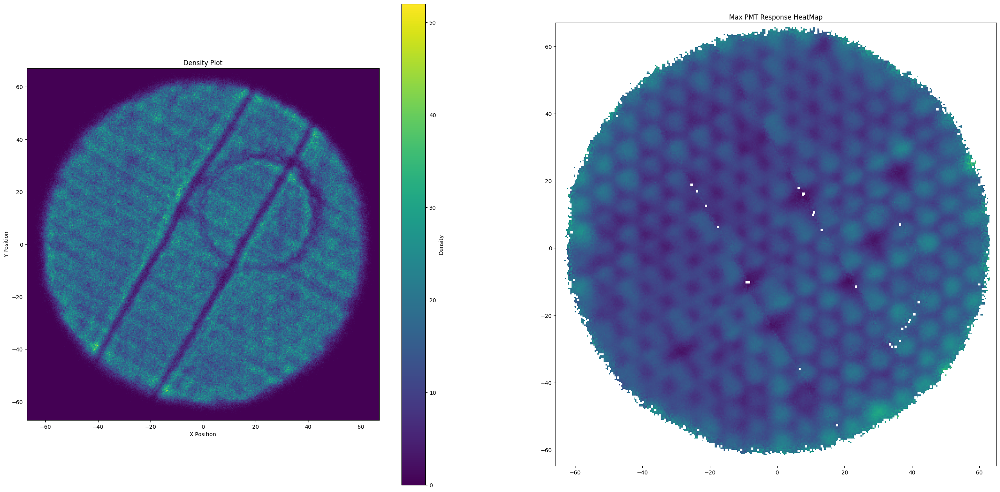

In [8]:
fig, ax = plt.subplots(1,2, figsize=(32,16))

do_density_plot(ax=ax[0], pos=pos, bins=400, title="Density Plot")
# Do maximum PMT ratio plot
def tmp2():
    from scipy.stats import binned_statistic_2d
    tmp_patterns = np.max(patterns.astype('float32') / np.sum(patterns.astype('float32'), axis=-1, keepdims= True), axis=-1)
    ret = binned_statistic_2d(pos[:,0],pos[:,1], tmp_patterns[:len(pos)], bins=400)
    ax[1].imshow(ret.statistic.T, extent=[ret.x_edge[0], ret.x_edge[-1],ret.y_edge[0], ret.y_edge[-1]])
    ax[1].set_title("Max PMT Response HeatMap")
tmp2()

In [18]:
# Train Again
seeds = np.random.randint(0, 100000, 3).tolist()
print(seeds)
direct_detection_models = {}

for seed in seeds:
    direct_detection_models[seed] = tmp(seed, pos.numpy(),patterns)
    direct_detection_models[seed].save_weights(os.path.join(model_path, f'Section_3_2_direct_detection_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(direct_detection_models[seed]):
        loss = np.mean(direct_detection_models[seed].predict({'xy':pos.numpy()[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
direct_detection_model = direct_detection_models[best_model[0]]

[16647, 72940, 45105]
11238/11238 [==============================] - 57s 5ms/step
Best Model seed 16647 with validation loss 1.0990453958511353
[16647, 1.0990454]


In [19]:
#direct_detection_model = gen_model(seed=seed, starting_model=None, include_wall = False, include_perp = False, include_anode = False)
pos = train_and_update_pos(pos.numpy(), patterns, direct_detection_model,loss_function, epochs=20, n_iter = 3, verbose=1)
np.save(os.path.join(pos_refit_path, 'pos_refit_2_Section_3.npy'), pos)

56188/56188 [==============================] - 288s 5ms/step
tf.Tensor(1.099058, shape=(), dtype=float32)
Jagged iter 0
Epoch 1/20
439/439 [==============================] - 498s 1s/step - loss: 1.1063 - lr: 0.1000
Epoch 2/20
439/439 [==============================] - 497s 1s/step - loss: 1.1022 - lr: 0.1000
Epoch 3/20
439/439 [==============================] - ETA: 0s - loss: 1.1027
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
439/439 [==============================] - 497s 1s/step - loss: 1.1027 - lr: 0.1000
Epoch 4/20
439/439 [==============================] - 497s 1s/step - loss: 1.1036 - lr: 0.0500
Epoch 5/20
439/439 [==============================] - ETA: 0s - loss: 1.1019
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
439/439 [==============================] - 497s 1s/step - loss: 1.1019 - lr: 0.0500
Epoch 5: early stopping
56188/56188 [==============================] - 279s 5ms/step
tf.Tensor(1.0974016, shape=(), dtype=flo

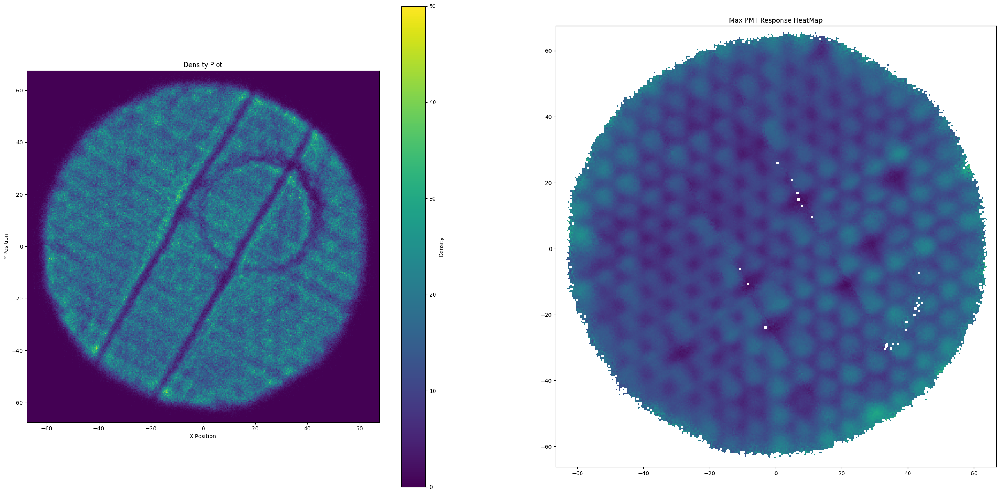

In [20]:
fig, ax = plt.subplots(1,2, figsize=(32,16))

do_density_plot(ax=ax[0], pos=pos, bins=400, title="Density Plot")
# Do maximum PMT ratio plot
def tmp2():
    from scipy.stats import binned_statistic_2d
    tmp_patterns = np.max(patterns.astype('float32') / np.sum(patterns.astype('float32'), axis=-1, keepdims= True), axis=-1)
    ret = binned_statistic_2d(pos[:,0],pos[:,1], tmp_patterns[:len(pos)], bins=400)
    ax[1].imshow(ret.statistic.T, extent=[ret.x_edge[0], ret.x_edge[-1],ret.y_edge[0], ret.y_edge[-1]])
    ax[1].set_title("Max PMT Response HeatMap")
tmp2()

In [21]:
# Train Again
seeds = np.random.randint(0, 100000, 3).tolist()
print(seeds)
direct_detection_models = {}

for seed in seeds:
    direct_detection_models[seed] = tmp(seed, pos.numpy(),patterns)
    direct_detection_models[seed].save_weights(os.path.join(model_path, f'Section_3_2_direct_detection_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(direct_detection_models[seed]):
        loss = np.mean(direct_detection_models[seed].predict({'xy':pos.numpy()[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
direct_detection_model = direct_detection_models[best_model[0]]

[83516, 68821, 21336]
11238/11238 [==============================] - 59s 5ms/step
Best Model seed 21336 with validation loss 1.0967557430267334
[21336, 1.0967557]


56188/56188 [==============================] - 281s 5ms/step
1.121477
56188/56188 [==============================] - 285s 5ms/step
1.0918937
56188/56188 [==============================] - 284s 5ms/step
1.0895927


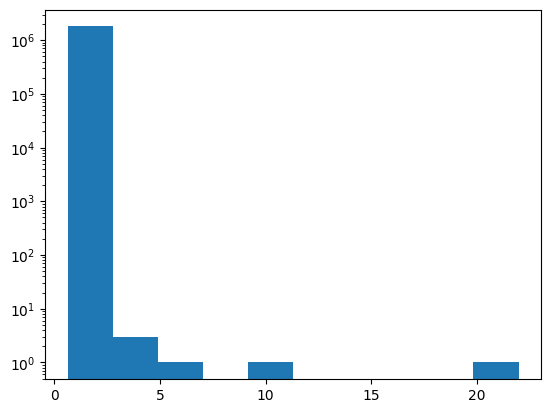

In [5]:
"""
Here all data is reloaded and evaluated with the final model 
"""
seed = 21336
direct_detection_model = gen_model(seed=seed, starting_model=None, include_wall = False, include_perp = False, include_anode = False)
direct_detection_model.load_weights(os.path.join(model_path, f'Section_3_2_direct_detection_model_{seed}.h5'))
# OG Set
def tmp(path):
    # SR2 Processed data 
    tmp = []
    for i in os.listdir(path):
        if not os.path.isdir(os.path.join(path, i)):
            tmp +=  [np.load(os.path.join(path, i))['arr_0']]
    tmp = np.concatenate(tmp)
    pos, patterns = np.column_stack([tmp['s2_x_cnf'], tmp['s2_y_cnf']]), tmp['s2_area_per_channel'][:,not_dead_pmts]

    bmap = ((patterns<0).any(axis=1) | np.all(np.isclose(patterns, patterns[:,0,None]), axis=1))
    pos = pos[~bmap]
    patterns = patterns[~bmap]
    return pos, patterns 
pos, patterns = tmp(data_path)
loss_dist = tf.math.reduce_mean(direct_detection_model.predict({"xy":pos,"pattern":patterns}), axis=-1)
print(np.sort(loss_dist)[len(loss_dist)//2])
pos = np.load(os.path.join(pos_refit_path, 'pos_refit_1_Section_3.npy'))
loss_dist = tf.math.reduce_mean(direct_detection_model.predict({"xy":pos,"pattern":patterns}), axis=-1)
print(np.sort(loss_dist)[len(loss_dist)//2])
pos = np.load(os.path.join(pos_refit_path, 'pos_refit_2_Section_3.npy'))
loss_dist = tf.math.reduce_mean(direct_detection_model.predict({"xy":pos,"pattern":patterns}), axis=-1)
print(np.sort(loss_dist)[len(loss_dist)//2])
plt.hist(loss_dist, bins = 200)
plt.yscale('log')

KeyboardInterrupt: 

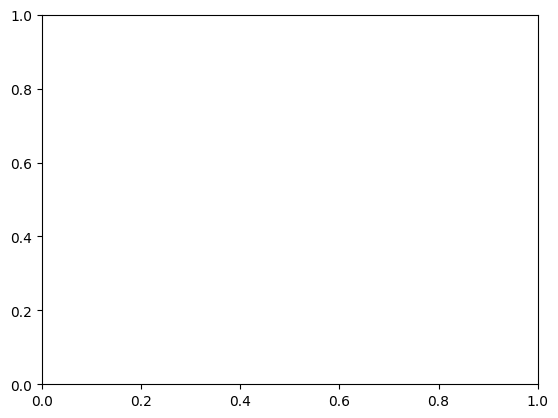

In [6]:
plt.hist(loss_dist, bins = 200)
plt.yscale('log')

# Section 4

Train Wall 


TODO Modify Dense network to be monotonically decreasing and then retrain, if it works can be done for radial LCE as well

article from monotonic.airt.ai/0.1.0/InDepth seems fairly decent and on arxiv Constrained Monotonic Neural Networks is i think hte corresponding paper 

Type1 Seems most reasonable but reread it Also figure out hwo to properly use the abcd parameters

In [14]:
seed = 21336
direct_detection_model = gen_model(seed=seed, starting_model=None, include_wall = False, include_perp = False, include_anode = False)
direct_detection_model.load_weights(os.path.join(model_path, f'Section_3_2_direct_detection_model_{seed}.h5'))
pos = np.load(os.path.join(pos_refit_path, 'pos_refit_2_Section_3.npy'))


In [19]:
"""
First pass only wall, do not train reflection
Then refit
Then refit wall and reflection
Then refit
Then refit wall and reflection
Then Section5
"""
def loss_function(y_true, y_pred):
    return y_pred

def tmp(seed, pos, patterns):
    X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
    X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]
    reflection_model = gen_model(seed=seed, starting_model=direct_detection_model, include_wall = True, include_perp = False, include_anode = False)
    
    reflection_model.get_layer('PMTDistance_Pattern_Response').trainable = False
    reflection_model.get_layer('i0').trainable = False
    
    reflection_model.compile(optimizer=Adam(learning_rate=0.001), 
                            loss=loss_function,)
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=2, min_delta=0.1, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=1, min_delta=0.2)

    reflection_model.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=1024,
                        )
    return reflection_model

seeds = np.random.randint(0, 100000, 3).tolist()
print('Seeds:')
print(seeds)
reflection_models = {}

for seed in seeds:
    reflection_models[seed] = tmp(seed, pos, patterns)
    reflection_models[seed].save_weights(os.path.join(model_path, f'Section_4_1_reflection_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(reflection_models[seed]) and check_Wall_behavior(reflection_models[seed]):
        loss = np.mean(reflection_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
reflection_model = reflection_models[best_model[0]]

Seeds:
[45262, 20426, 39809]
Epoch 1/100
1405/1405 [==============================] - 552s 392ms/step - loss: 1.1676 - val_loss: 1.1129 - lr: 0.0010
Epoch 2/100
1405/1405 [==============================] - 548s 390ms/step - loss: 1.1055 - val_loss: 1.1039 - lr: 0.0010
Epoch 3/100
1405/1405 [==============================] - 549s 391ms/step - loss: 1.1040 - val_loss: 1.1039 - lr: 1.0000e-04
Epoch 1/100
1405/1405 [==============================] - 551s 391ms/step - loss: 1.1707 - val_loss: 1.1130 - lr: 0.0010
Epoch 2/100
1405/1405 [==============================] - 549s 390ms/step - loss: 1.1056 - val_loss: 1.1040 - lr: 0.0010
Epoch 3/100
1405/1405 [==============================] - 548s 390ms/step - loss: 1.1040 - val_loss: 1.1040 - lr: 1.0000e-04
Epoch 1/100
1405/1405 [==============================] - 552s 392ms/step - loss: 1.1663 - val_loss: 1.1117 - lr: 0.0010
Epoch 2/100
1405/1405 [==============================] - 549s 391ms/step - loss: 1.1053 - val_loss: 1.1040 - lr: 0.0010
Epo

In [20]:
best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(reflection_models[seed]) and check_Wall_behavior(reflection_models[seed]):
        loss = np.mean(reflection_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
reflection_model = reflection_models[best_model[0]]

11238/11238 [==============================] - 75s 7ms/step
Best Model seed 39809 with validation loss 1.1117016077041626
[39809, 1.1117016]


In [22]:
# First Wall Pos Refit
pos = train_and_update_pos(pos, patterns, reflection_model,loss_function, epochs=20, n_iter = 3, verbose=1)
np.save(os.path.join(pos_refit_path, 'pos_refit_1_Section_4.npy'), pos)

56188/56188 [==============================] - 379s 7ms/step
tf.Tensor(1.111683, shape=(), dtype=float32)
Jagged iter 0
Epoch 1/20
439/439 [==============================] - 619s 1s/step - loss: 1.1191 - lr: 0.1000
Epoch 2/20
439/439 [==============================] - 617s 1s/step - loss: 1.1154 - lr: 0.1000
Epoch 3/20
439/439 [==============================] - ETA: 0s - loss: 1.1161
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
439/439 [==============================] - 618s 1s/step - loss: 1.1161 - lr: 0.1000
Epoch 4/20
439/439 [==============================] - 618s 1s/step - loss: 1.1170 - lr: 0.0500
Epoch 5/20
439/439 [==============================] - ETA: 0s - loss: 1.1153
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
439/439 [==============================] - 620s 1s/step - loss: 1.1153 - lr: 0.0500
Epoch 5: early stopping
56188/56188 [==============================] - 390s 7ms/step
tf.Tensor(1.1105093, shape=(), dtype=flo

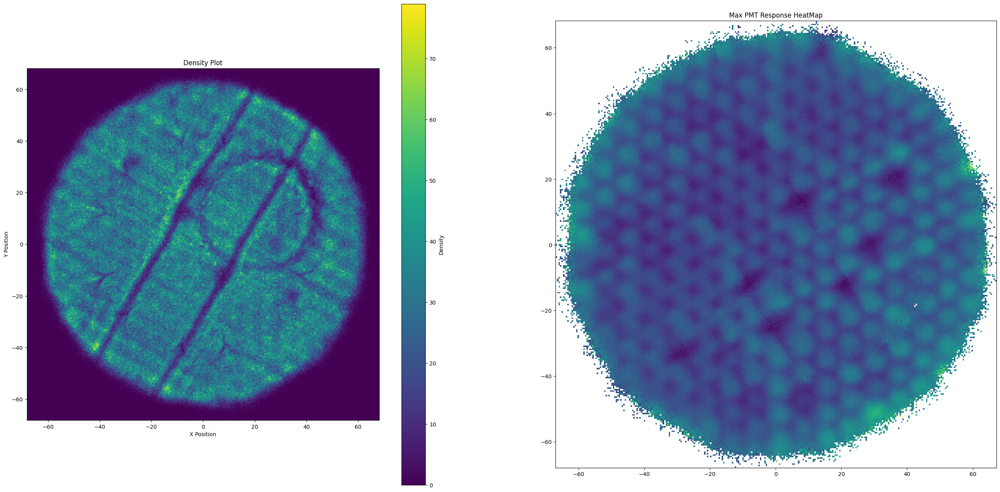

In [23]:
fig, ax = plt.subplots(1,2, figsize=(32,16))

do_density_plot(ax=ax[0], pos=pos, bins=300, title="Density Plot")
# Do maximum PMT ratio plot
def tmp2():
    from scipy.stats import binned_statistic_2d
    tmp_patterns = np.max(patterns.astype('float32') / np.sum(patterns.astype('float32'), axis=-1, keepdims= True), axis=-1)
    ret = binned_statistic_2d(pos[:,0],pos[:,1], tmp_patterns, bins=300)
    ax[1].imshow(ret.statistic.T, extent=[ret.x_edge[0], ret.x_edge[-1],ret.y_edge[0], ret.y_edge[-1]])
    ax[1].set_title("Max PMT Response HeatMap")
tmp2()

In [10]:
pos = np.load(os.path.join(pos_refit_path, 'pos_refit_1_Section_4.npy'))

seed = 39809
reflection_model = gen_model(seed=seed, starting_model=None, include_wall = True, include_perp = False, include_anode = False)
reflection_model.load_weights(os.path.join(model_path, f'Section_4_1_reflection_model_{seed}.h5'))

In [11]:
"""
Second wall and reflection
"""
def loss_function(y_true, y_pred):
    return y_pred
_reflection_model = reflection_model
def tmp(seed, pos, patterns):
    X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
    X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]
    reflection_model = gen_model(seed=seed, starting_model=_reflection_model, include_wall = True, include_perp = False, include_anode = False)
    
    reflection_model.compile(optimizer=Adam(learning_rate=0.00001), 
                            loss=loss_function,)
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=2, min_delta=0.1, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=1, min_delta=0.2)

    reflection_model.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=1024,
                        )
    return reflection_model

seeds = np.random.randint(0, 100000, 1).tolist()
print('Seeds:')
print(seeds)
reflection_models = {}

# Not sure seed actually changes anything here
for seed in seeds:
    reflection_models[seed] = tmp(seed, pos, patterns)
    reflection_models[seed].save_weights(os.path.join(model_path, f'Section_4_2_reflection_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(reflection_models[seed]):
        loss = np.mean(reflection_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
reflection_model = reflection_models[best_model[0]]

Seeds:
[42542]
Epoch 1/100


KeyboardInterrupt: 

In [14]:
# Second Wall Pos Refit
pos = train_and_update_pos(pos, patterns, reflection_model,loss_function, epochs=20, n_iter = 3, verbose=1)
np.save(os.path.join(pos_refit_path, 'pos_refit_2_Section_4.npy'), pos)

56188/56188 [==============================] - 380s 7ms/step
tf.Tensor(1.0922427, shape=(), dtype=float32)
Jagged iter 0
Epoch 1/20
439/439 [==============================] - 629s 1s/step - loss: 1.0999 - lr: 0.1000
Epoch 2/20
439/439 [==============================] - 627s 1s/step - loss: 1.0970 - lr: 0.1000
Epoch 3/20
439/439 [==============================] - ETA: 0s - loss: 1.0980
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
439/439 [==============================] - 627s 1s/step - loss: 1.0980 - lr: 0.1000
Epoch 4/20
439/439 [==============================] - 627s 1s/step - loss: 1.0991 - lr: 0.0500
Epoch 5/20
439/439 [==============================] - ETA: 0s - loss: 1.0973
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
439/439 [==============================] - 627s 1s/step - loss: 1.0973 - lr: 0.0500
Epoch 5: early stopping
56188/56188 [==============================] - 376s 7ms/step
tf.Tensor(1.0916606, shape=(), dtype=fl

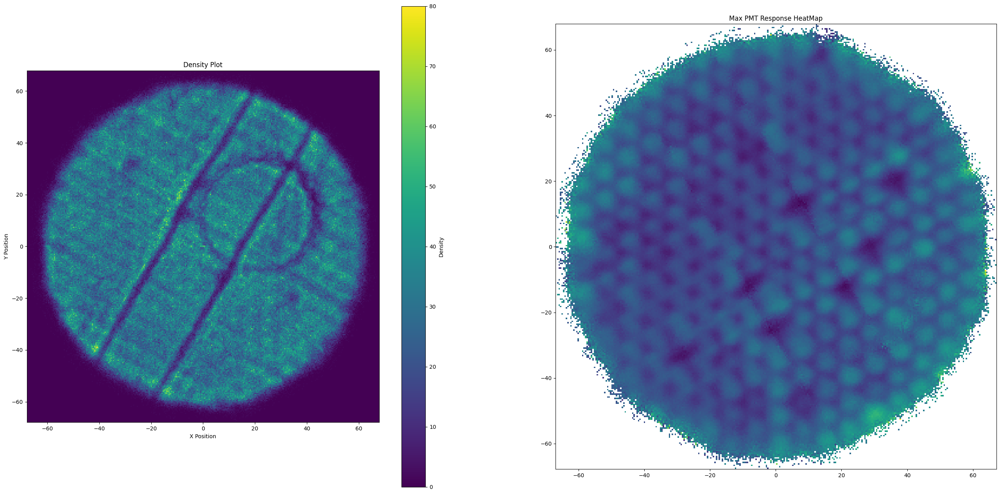

In [15]:
fig, ax = plt.subplots(1,2, figsize=(32,16))

do_density_plot(ax=ax[0], pos=pos, bins=300, title="Density Plot")
# Do maximum PMT ratio plot
def tmp2():
    from scipy.stats import binned_statistic_2d
    tmp_patterns = np.max(patterns.astype('float32') / np.sum(patterns.astype('float32'), axis=-1, keepdims= True), axis=-1)
    ret = binned_statistic_2d(pos[:,0],pos[:,1], tmp_patterns, bins=300)
    ax[1].imshow(ret.statistic.T, extent=[ret.x_edge[0], ret.x_edge[-1],ret.y_edge[0], ret.y_edge[-1]])
    ax[1].set_title("Max PMT Response HeatMap")
tmp2()

In [17]:
"""Second Wall and Reflection Training"""

seeds = np.random.randint(0, 100000, 1).tolist()
print('Seeds:')
print(seeds)
reflection_models = {}

# Not sure seed actually changes anything here
for seed in seeds:
    reflection_models[seed] = tmp(seed, pos.numpy(), patterns)
    reflection_models[seed].save_weights(os.path.join(model_path, f'Section_4_3_reflection_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(reflection_models[seed]):
        loss = np.mean(reflection_models[seed].predict({'xy':pos.numpy()[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
reflection_model = reflection_models[best_model[0]]

Seeds:
[63758]
Epoch 1/100
1405/1405 [==============================] - 579s 411ms/step - loss: 1.0981 - val_loss: 1.0925 - lr: 1.0000e-05
Epoch 2/100
1405/1405 [==============================] - 568s 404ms/step - loss: 1.0875 - val_loss: 1.0854 - lr: 1.0000e-05
Epoch 3/100
11238/11238 [==============================] - 77s 7ms/step
Best Model seed 63758 with validation loss 1.092515468597412
[63758, 1.0925155]


In [22]:
# third Wall Pos Refit
pos = train_and_update_pos(pos, patterns, reflection_model,loss_function, epochs=20, n_iter = 3, verbose=1)
np.save(os.path.join(pos_refit_path, 'pos_refit_3_Section_4.npy'), pos)

56188/56188 [==============================] - 383s 7ms/step
tf.Tensor(1.091956, shape=(), dtype=float32)
Jagged iter 0
Epoch 1/20
439/439 [==============================] - 630s 1s/step - loss: 1.1004 - lr: 0.1000
Epoch 2/20
439/439 [==============================] - 629s 1s/step - loss: 1.0972 - lr: 0.1000
Epoch 3/20
439/439 [==============================] - ETA: 0s - loss: 1.0982
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
439/439 [==============================] - 629s 1s/step - loss: 1.0982 - lr: 0.1000
Epoch 4/20
439/439 [==============================] - 642s 1s/step - loss: 1.0993 - lr: 0.0500
Epoch 5/20
439/439 [==============================] - ETA: 0s - loss: 1.0975
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
439/439 [==============================] - 647s 1s/step - loss: 1.0975 - lr: 0.0500
Epoch 5: early stopping
56188/56188 [==============================] - 377s 7ms/step
tf.Tensor(1.0918374, shape=(), dtype=flo

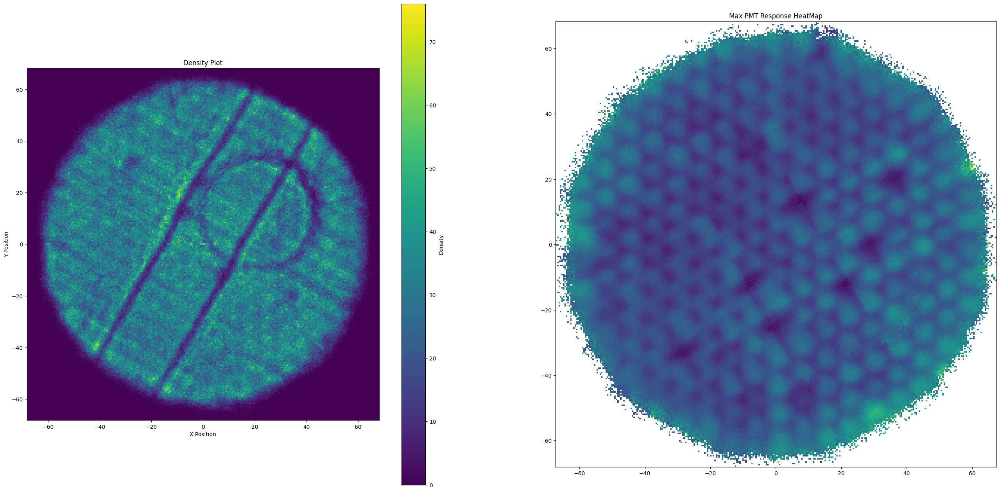

In [23]:
fig, ax = plt.subplots(1,2, figsize=(32,16))

do_density_plot(ax=ax[0], pos=pos, bins=300, title="Density Plot")
# Do maximum PMT ratio plot
def tmp2():
    from scipy.stats import binned_statistic_2d
    tmp_patterns = np.max(patterns.astype('float32') / np.sum(patterns.astype('float32'), axis=-1, keepdims= True), axis=-1)
    ret = binned_statistic_2d(pos[:,0],pos[:,1], tmp_patterns, bins=300)
    ax[1].imshow(ret.statistic.T, extent=[ret.x_edge[0], ret.x_edge[-1],ret.y_edge[0], ret.y_edge[-1]])
    ax[1].set_title("Max PMT Response HeatMap")
tmp2()

In [ ]:
"""Last Wall and Reflection Training"""

seeds = np.random.randint(0, 100000, 3).tolist()
print('Seeds:')
print(seeds)
reflection_models = {}
pos = np.load(os.path.join(pos_refit_path, 'pos_refit_3_Section_4.npy'))
# Not sure seed actually changes anything here
for seed in seeds:
    reflection_models[seed] = tmp(seed, pos, patterns)
    reflection_models[seed].save_weights(os.path.join(model_path, f'Section_4_3_reflection_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(reflection_models[seed]):
        loss = np.mean(reflection_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
reflection_model = reflection_models[best_model[0]]

Seeds:
[78929, 20095, 59084]
Epoch 1/100
1405/1405 [==============================] - 567s 403ms/step - loss: 1.0981 - val_loss: 1.0916 - lr: 1.0000e-05
Epoch 2/100
1405/1405 [==============================] - 565s 402ms/step - loss: 1.0876 - val_loss: 1.0839 - lr: 1.0000e-05
Epoch 3/100
1405/1405 [==============================] - 565s 402ms/step - loss: 1.0836 - val_loss: 1.0832 - lr: 1.0000e-06
Epoch 1/100
1405/1405 [==============================] - 569s 404ms/step - loss: 1.0981 - val_loss: 1.0914 - lr: 1.0000e-05
Epoch 2/100
1405/1405 [==============================] - 566s 403ms/step - loss: 1.0876 - val_loss: 1.0838 - lr: 1.0000e-05
Epoch 3/100
1405/1405 [==============================] - 565s 402ms/step - loss: 1.0836 - val_loss: 1.0831 - lr: 1.0000e-06
Epoch 1/100
1405/1405 [==============================] - 568s 403ms/step - loss: 1.0981 - val_loss: 1.0918 - lr: 1.0000e-05
Epoch 2/100
1405/1405 [==============================] - 563s 401ms/step - loss: 1.0876 - val_loss: 1.0

AttributeError: 'numpy.ndarray' object has no attribute 'numpy'

In [13]:
best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(reflection_models[seed]):
        loss = np.mean(reflection_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
reflection_model = reflection_models[best_model[0]]

11238/11238 [==============================] - 89s 8ms/step
Best Model seed 20095 with validation loss 1.0913903713226318
[20095, 1.0913904]


56188/56188 [==============================] - 448s 8ms/step
1.1149193
56188/56188 [==============================] - 445s 8ms/step
1.0852008
56188/56188 [==============================] - 416s 7ms/step
1.0846424
56188/56188 [==============================] - 453s 8ms/step
1.0845146


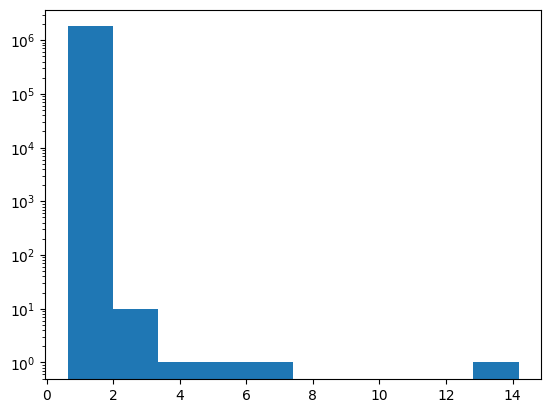

In [16]:
"""
Here all data is reloaded and evaluated with the final model 
"""
seed = 20095
reflection_model = gen_model(seed=seed, starting_model=None, include_wall = True, include_perp = False, include_anode = False)
reflection_model.load_weights(os.path.join(model_path, f'Section_4_3_reflection_model_{seed}.h5'))

# OG Set
def tmp(path):
    # SR2 Processed data 
    tmp = []
    for i in os.listdir(path):
        if not os.path.isdir(os.path.join(path, i)):
            tmp +=  [np.load(os.path.join(path, i))['arr_0']]
    tmp = np.concatenate(tmp)
    pos, patterns = np.column_stack([tmp['s2_x_cnf'], tmp['s2_y_cnf']]), tmp['s2_area_per_channel'][:,not_dead_pmts]

    bmap = ((patterns<0).any(axis=1) | np.all(np.isclose(patterns, patterns[:,0,None]), axis=1))
    pos = pos[~bmap]
    patterns = patterns[~bmap]
    return pos, patterns 

pos, patterns = tmp(data_path)
loss_dist = tf.math.reduce_mean(reflection_model.predict({"xy":pos,"pattern":patterns}), axis=-1)
print(np.sort(loss_dist)[len(loss_dist)//2])
pos = np.load(os.path.join(pos_refit_path, 'pos_refit_1_Section_4.npy'))
loss_dist = tf.math.reduce_mean(reflection_model.predict({"xy":pos,"pattern":patterns}), axis=-1)
print(np.sort(loss_dist)[len(loss_dist)//2])
pos = np.load(os.path.join(pos_refit_path, 'pos_refit_2_Section_4.npy'))
loss_dist = tf.math.reduce_mean(reflection_model.predict({"xy":pos,"pattern":patterns}), axis=-1)
print(np.sort(loss_dist)[len(loss_dist)//2])
pos = np.load(os.path.join(pos_refit_path, 'pos_refit_3_Section_4.npy'))
loss_dist = tf.math.reduce_mean(reflection_model.predict({"xy":pos,"pattern":patterns}), axis=-1)
print(np.sort(loss_dist)[len(loss_dist)//2])
plt.hist(loss_dist)
plt.yscale('log')

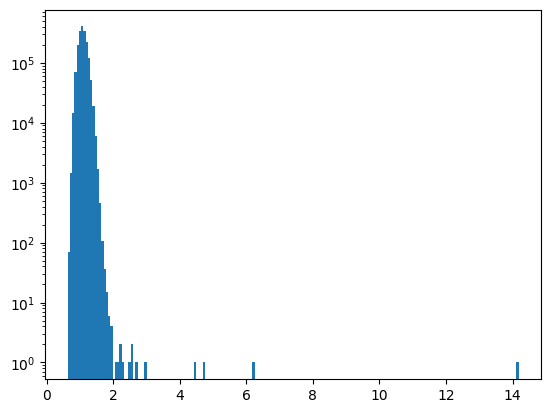

In [17]:
plt.hist(loss_dist, bins = 200)
plt.yscale('log')

In [22]:
loss_dist = loss_dist[loss_dist < 2]

from scipy.stats import chi2
df_fit, loc_fit, scale_fit = chi2.fit(loss_dist, f0=1, fscale=1)

In [23]:
df_fit, loc_fit, scale_fit

(1, 0.6327888942532318, 1)

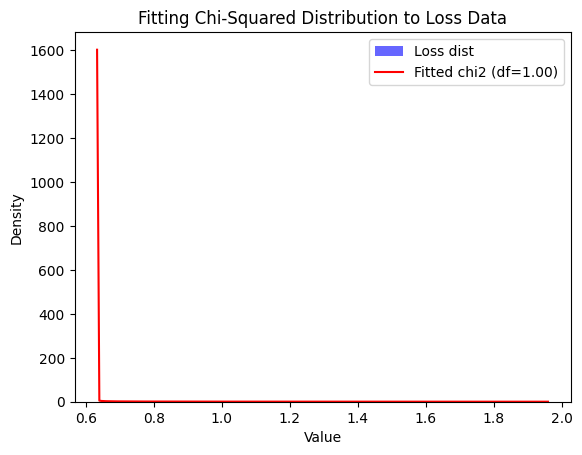

In [24]:
bins = 200

plt.hist(loss_dist, bins=bins, density=True, alpha=0.6, color='blue', label='Loss dist')

# Overlay the fitted chi-squared distribution
x = np.linspace(min(loss_dist), max(loss_dist), bins)
plt.plot(x, chi2.pdf(x, df=df_fit, loc=loc_fit, scale=scale_fit), 'r-', label=f'Fitted chi2 (df={df_fit:.2f})')

plt.xlabel('Value')
plt.ylabel('Density')
plt.legend()
plt.title('Fitting Chi-Squared Distribution to Loss Data')
plt.show()

# Section 5

TODO Cont here if not fail

Train Anode and Perp 

In [18]:
# Currently unsuccessfull
class PerpendicularWire_Parametrization(tf.keras.layers.Layer): 
    """
    Output 0-1 for total amount of wire in the way of Event To PMT
    """
    def __init__(self, pmt_pos, pmt_r, **kwargs):
        super().__init__(**kwargs)
        self.angle = tf.constant(-(np.pi / 3) + (np.pi / 2), dtype=tf.float32, name="angle_PerpendicularWire")
        self.rot_matrix = tf.transpose(tf.stack([[tf.cos(self.angle ), -tf.sin(self.angle )],[tf.sin(self.angle ),  tf.cos(self.angle )]]))
        self.rot_matrix = tf.constant(self.rot_matrix, dtype=tf.float32, name="rot_matrix_PerpendicularWire")
        self.pmt_pos = tf.constant(pmt_pos, dtype=tf.float32, name="pmt_pos_PerpendicularWire") # (n_pmts, 2)
        self.pmt_rot = tf.constant(tf.linalg.matmul(self.pmt_pos, self.rot_matrix), dtype=tf.float32, name="pmt_rot_PerpendicularWire") # (n_pmts, 2)

        # Constant
        self.pmt_r = tf.constant(pmt_r, dtype=tf.float32, name="pmt_r_PerpendicularWire")
        self.tpc_r = tf.constant(66.4, dtype=tf.float32, name="tpc_r_PerpendicularWire")
        self.h = tf.constant(0.027, dtype=tf.float32, name="h_PerpendicularWire")
        self.H = tf.constant(68.58 / 10, dtype=tf.float32, name="H_PerpendicularWire")
        self.anode_r = tf.constant(0.0304 /2, dtype=tf.float32, name="anode_r_PerpendicularWire")
        self.dz = tf.constant(self.h + self.H, dtype=tf.float32, name="dz_PerpendicularWire")

        self.wire_start = tf.reshape(tf.constant([31.8, -31.8, 28.3, -28.3]) - self.anode_r, ( 1, 4))
        self.wire_end = tf.reshape(tf.constant([31.8, -31.8, 28.3, -28.3]) + self.anode_r, (1, 4))

        return

    def build(self, input_shape):
        super().build(input_shape)

    def n_wires_in_way(self, events):
        """
        The logic of this really simple problem keeps confusing me
        So we compute the gradient of the hypotenuse (triangle event site pmt center pmt edge)
        And hten just multiply by height and add / subtract
        
        """
        # (batch, 2)
        events_rot = tf.linalg.matmul(events, self.rot_matrix)
        # (batch, n_pmts)
        grad_minus = tf.math.abs(((self.pmt_rot[:,0]-self.pmt_r) - events_rot[:,0, None]) / self.dz)
        grad_plus = tf.math.abs(((self.pmt_rot[:,0]+self.pmt_r) - events_rot[:,0, None]) / self.dz)
        # Compute bounds on anode mesh height
        bounds_minus = events_rot[:,0, None] - grad_minus * self.h
        bounds_plus = events_rot[:,0, None] + grad_plus * self.h
        """
        Overlap = min( 0, (min(x_1end, x_2end) - max(x_1start, x_2start)) )
        """
        start_overlap = tf.maximum(tf.expand_dims(bounds_minus,axis=-1), self.wire_start)    # (batch, n_pmts, 4)
        end_overlap   = tf.minimum(tf.expand_dims(bounds_plus,axis=-1), self.wire_end)       # (batch, n_pmts, 4)
        overlap       = tf.maximum(0.0, end_overlap - start_overlap) # (batch, n_pmts, 4)

        # Return Fraction of Wire in the way 
        return tf.math.reduce_sum(overlap, axis=-1, keepdims=True) / (2 * self.anode_r)

    def call(self, x):
        return self.n_wires_in_way(x)

In [21]:
"""
Train with anode
Pos Refit
Train with anode
Pos Refit 
Train with anode 
"""
def loss_function(y_true, y_pred):
    return y_pred

def tmp(seed, pos, patterns):
    X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
    X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]
    full_model = gen_model(seed=seed, starting_model=reflection_model, include_wall = True, include_perp = True, include_anode = True)
    
    full_model.get_layer('PMTDistance_Pattern_Response').trainable = False
    full_model.get_layer('Wall_Reflection_Pattern_Response').trainable = False
    full_model.get_layer('MultiplicationLayer').trainable = False
    full_model.get_layer('i0').trainable = False
    
    full_model.compile(optimizer=Adam(learning_rate=0.001), 
                            loss=loss_function,)
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, min_delta=0.1, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=5, min_delta=0.2)

    full_model.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=1024,
                        )
    return full_model

seeds = np.random.randint(0, 100000, 3).tolist()
print('Seeds:')
print(seeds)
full_models = {}

for seed in seeds:
    full_models[seed] = tmp(seed, pos.numpy(), patterns)
    full_models[seed].save_weights(os.path.join(model_path, f'Section_5_1_full_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(full_models[seed]):
        loss = np.mean(full_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
full_model = full_models[best_model[0]]

Seeds:
[70505, 44110, 82910]
Epoch 1/100
  80/1405 [>.............................] - ETA: 8:06 - loss: 1.0963

KeyboardInterrupt: 

In [24]:
# First Pos Refit
pos = train_and_update_pos(pos, patterns, full_model,loss_function, epochs=20, n_iter = 3, verbose=1)
np.save(os.path.join(pos_refit_path, 'pos_refit_1_Section_5.npy'), pos)

839/839 [==============================] - 5s 6ms/step


In [ ]:
fig, ax = plt.subplots(1,2, figsize=(32,16))

do_density_plot(ax=ax[0], pos=pos, bins=300, title="Density Plot")
# Do maximum PMT ratio plot
def tmp2():
    from scipy.stats import binned_statistic_2d
    tmp_patterns = np.max(patterns.astype('float32') / np.sum(patterns.astype('float32'), axis=-1, keepdims= True), axis=-1)
    ret = binned_statistic_2d(pos[:,0],pos[:,1], tmp_patterns, bins=300)
    ax[1].imshow(ret.statistic.T, extent=[ret.x_edge[0], ret.x_edge[-1],ret.y_edge[0], ret.y_edge[-1]])
    ax[1].set_title("Max PMT Response HeatMap")
tmp2()

In [25]:
def tmp(seed, pos, patterns):
    X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
    X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]
    full_model = gen_model(seed=seed, starting_model=direct_detection_model, include_wall = True, include_perp = True, include_anode = True)
    
    full_model.compile(optimizer=Adam(learning_rate=0.0001), 
                            loss=loss_function,)
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=2, min_delta=0.1, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=1, min_delta=0.2)

    full_model.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=1024,
                        )
    return full_model

seeds = np.random.randint(0, 100000, 3).tolist()
print('Seeds:')
print(seeds)
full_models = {}

for seed in seeds:
    full_models[seed] = tmp(seed, pos, patterns)
    full_models[seed].save_weights(os.path.join(model_path, f'Section_5_2_full_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(full_models[seed]):
        loss = np.mean(full_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
full_model = full_models[best_model[0]]

Seeds:
[53739, 38455, 28172]
Epoch 1/100
21/21 [==============================] - 12s 447ms/step - loss: 3.6216 - val_loss: 2.4616 - lr: 0.0010
Epoch 2/100
21/21 [==============================] - 9s 416ms/step - loss: 1.9954 - val_loss: 1.6545 - lr: 0.0010
Epoch 3/100
21/21 [==============================] - 9s 418ms/step - loss: 1.5252 - val_loss: 1.4366 - lr: 0.0010
Epoch 4/100
21/21 [==============================] - 9s 418ms/step - loss: 1.3883 - val_loss: 1.3573 - lr: 0.0010
Epoch 5/100
21/21 [==============================] - 9s 420ms/step - loss: 1.3500 - val_loss: 1.3519 - lr: 1.0000e-04
Epoch 1/100
21/21 [==============================] - 12s 439ms/step - loss: 3.6824 - val_loss: 2.3785 - lr: 0.0010
Epoch 2/100
21/21 [==============================] - 9s 408ms/step - loss: 1.9067 - val_loss: 1.5576 - lr: 0.0010
Epoch 3/100
21/21 [==============================] - 9s 410ms/step - loss: 1.4487 - val_loss: 1.3766 - lr: 0.0010
Epoch 4/100
21/21 [==============================] - 

In [26]:
# First Pos Refit
pos = train_and_update_pos(pos, patterns, full_model,loss_function, epochs=20, n_iter = 3, verbose=1)
np.save(os.path.join(pos_refit_path, 'pos_refit_2_Section_5.npy'), pos)

839/839 [==============================] - 6s 7ms/step


In [ ]:
fig, ax = plt.subplots(1,2, figsize=(32,16))

do_density_plot(ax=ax[0], pos=pos, bins=300, title="Density Plot")
# Do maximum PMT ratio plot
def tmp2():
    from scipy.stats import binned_statistic_2d
    tmp_patterns = np.max(patterns.astype('float32') / np.sum(patterns.astype('float32'), axis=-1, keepdims= True), axis=-1)
    ret = binned_statistic_2d(pos[:,0],pos[:,1], tmp_patterns, bins=300)
    ax[1].imshow(ret.statistic.T, extent=[ret.x_edge[0], ret.x_edge[-1],ret.y_edge[0], ret.y_edge[-1]])
    ax[1].set_title("Max PMT Response HeatMap")
tmp2()

In [27]:
seeds = np.random.randint(0, 100000, 3).tolist()
print('Seeds:')
print(seeds)
full_models = {}

for seed in seeds:
    full_models[seed] = tmp(seed, pos, patterns)
    full_models[seed].save_weights(os.path.join(model_path, f'Section_5_2_full_model_{seed}.h5'))

best_model = [-1,1e9]
for seed in seeds:
    # CHeck that function decreases with radius
    if check_radial_behavior(full_models[seed]):
        loss = np.mean(full_models[seed].predict({'xy':pos[val_idx], 'pattern':patterns[val_idx]}))
        if loss < best_model[1]:
            best_model = [seed, loss]
print('Best Model seed {} with validation loss {}'.format(best_model[0], best_model[1]))
print(best_model)
full_model = full_models[best_model[0]]

Seeds:
[3267, 88035, 72880]
Epoch 1/100
21/21 [==============================] - 12s 445ms/step - loss: 4.4623 - val_loss: 3.4409 - lr: 0.0010
Epoch 2/100
21/21 [==============================] - 9s 413ms/step - loss: 2.7041 - val_loss: 2.0093 - lr: 0.0010
Epoch 3/100
21/21 [==============================] - 9s 410ms/step - loss: 1.8187 - val_loss: 1.7417 - lr: 0.0010
Epoch 4/100
21/21 [==============================] - 9s 414ms/step - loss: 1.6726 - val_loss: 1.5746 - lr: 0.0010
Epoch 5/100
21/21 [==============================] - 9s 420ms/step - loss: 1.5566 - val_loss: 1.5408 - lr: 1.0000e-04
Epoch 6/100
21/21 [==============================] - 9s 420ms/step - loss: 1.5256 - val_loss: 1.5114 - lr: 1.0000e-04
Epoch 1/100
21/21 [==============================] - 12s 446ms/step - loss: 3.6681 - val_loss: 2.7446 - lr: 0.0010
Epoch 2/100
21/21 [==============================] - 9s 420ms/step - loss: 2.2696 - val_loss: 1.8637 - lr: 0.0010
Epoch 3/100
21/21 [==============================]

839/839 [==============================] - 6s 7ms/step


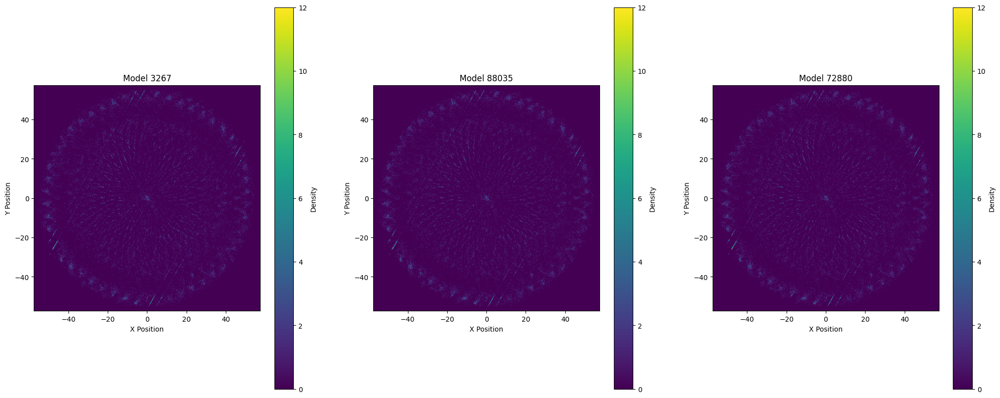

In [28]:
fig, axes = plt.subplots(1, 3, figsize=(25, 10))
for i, ax in enumerate(axes):
    seed = seeds[i]
    plt_pos = train_and_update_pos(pos, patterns, full_models[seed],loss_function, epochs=20, n_iter = 3, verbose=1)
    do_density_plot(ax =ax, pos = pos, title=f'Model {seed}', bins=480)
    np.save(os.path.join(pos_refit_path, f'final_refit_{seed}_Section_5.npy'), plt_pos)
    del plt_pos

# Old things

# Meeting Notes


- Fitted BSpline to good results for radial LCE on MC 
    - For actual data also need to fit I0s - But it seems MC does not get the radial response correct so I guess fit directly on NN / Real Data

- Full Loss function takes very long to evaluate - in looking into options (instead of switching) noticed that NF models are designed for this task 

- NF models are built as invertible so invert Posrec CNF and we got an LCE that will likely perform very well 

- Want to check if NF is usefull for evaluating likelihood/likelihood ratios per PMT

- PhD Pos in Groningen 
    - Daan Meerburg
    - An-Katrin perevoort
    - KM3Net - Paul de Jong


# Next meeting

- Where find when assignment passed or not? - Also sorry for not showing up

- Gave up on any form of analytical fitting
    - BSpline worked but oscillatory behavior made it hard to isolate components reliably

- Good results using isolated models 
    - 3 sub models
        - First Radius input only dense applied on a per pmt basis
        - Second Wall only : Event to wall and pmt to wall distances as input applied on per pmt basis
        - Third uses shenyangs core architecture to fit corrections required - couldnt get it working properly otherwise (may not have used enough data to make it work properly however)
    - Some changes I want to make
        - Pretrain I0s again 

- Require input on correction term how to best model it in a divorced fashion
- Also on how to visualize the residual terms - Probably should start using real data right about now but I would like to find a reasonable form for the above first

- MC Map - After rechecking I have no idea what I was on about - it may be that i checked the wrong MC map but the maximum appears aligned - see last cell  
    - I am going to set aside a day to recheck MC maps I feel every time I look at them i find something different

- CNF 
    - Havent done anything with it yet BSplines have been taking up my time

- Full Loss Network
    - Havent worked on it yet 
    - Want to finish broad structure of this network first 
    - Create the layer then 
        - Train with the model developed on Shenyangs model untrainable
        - Then when starting points for all layers are available train all simultaneously - I assume this model will be subject to numerical instability


# Next meeting

- So tf v 2.15does not have tfp, 2.16 does but 2.16 has Keras v3 not 2, keras v3 breaks everything in my code including loading shenyangs model

- How to deal with < 0  observeration

- How to deal with < 0 prediction : Example std=1 pred = 1 obs = 2 gives -0.004 ~ 0.98 likelihood ratio, for now i do abs as it kind of achieves what I want, obs==pred produces 0



# Next meeting

Fitting Neural Net is harder than expected for loss - For now using shenyang

Next Steps: 
- Fit only Radial Component 
    - Find Minimal size for reasonable and good results
    - Fit multiple times with different seeds -> Try to find the best initializer

- Refit Positions, do this 2 or three times with above

- Repeat for Wall Term 
    - Try multiple seeds, see the output, figure out whats happening with the dual maxima 
- Again refit pos etc etc

- Then anode
    - If it keeps finding nothing try perp wire 



In [4]:
"""
tfp is the wrong version
"""
%pip install tensorflow_probability==0.23

  Using cached tensorflow_probability-0.23.0-py2.py3-none-any.whl.metadata (13 kB)
Using cached tensorflow_probability-0.23.0-py2.py3-none-any.whl (6.9 MB)
  Attempting uninstall: tensorflow_probability
    Found existing installation: tensorflow-probability 0.2.0
    Uninstalling tensorflow-probability-0.2.0:
      Successfully uninstalled tensorflow-probability-0.2.0
Note: you may need to restart the kernel to use updated packages.


In [5]:
# Load basics - Radial LCE + Shenyang
import os, sys
os.environ["XENON_CONFIG"] = "/Code/xenon.config"
import straxen
# Load Own functions
sys.path.append(os.path.join(os.getcwd(), 'ActualThesisWork'))
%load_ext autoreload
%autoreload 2
from functions import *
import numpy as np
def _logl_loss(patterns, likelihood):
    return likelihood[0]
import sys
sys.path.append(os.path.join(os.getcwd(), 'ActualThesisWork'))
%load_ext autoreload
%autoreload 2
from functions import *
def tmp():
    pmt_pos_top = straxen.pmt_positions()[straxen.pmt_positions()['array'] == 'top'].loc[:,['x','y']].to_numpy().astype('float32')
    # Load Neural Nets
    # Load rLCE
    not_dead_pmts = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 157, 158, 159, 160, 161, 162, 163, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252]
    dead_pmts = [28, 108, 121, 144, 156, 164, 177]
    n_pmts = len(not_dead_pmts)+len(dead_pmts)
    from tensorflow import keras
    import tensorflow as tf
    class FilterAlive(keras.layers.Layer):
        def __init__(self, alive_pmt_indices, **kwargs):
            super().__init__(**kwargs)
            self.alive = alive_pmt_indices
        
        def call(self, X):
            return tf.gather(X, self.alive, axis = -1)
        
        def compute_output_shape(self, input_shape):
            return (input_shape[0], self.alive.shape)
        
    # Taken from Shenyang and slightly modified
    import math
    class Likelihood(tf.keras.layers.Layer):
        def __init__(self, n_pmts, **kwargs):
            super().__init__(**kwargs)
            self.n_pmts = n_pmts
        def build(self, input_shape):
            self.sigma = self.add_weight(
                shape=(self.n_pmts, ), dtype=tf.float32, name='sigma',
                initializer=tf.keras.initializers.Ones(),
                trainable=True)
            self.power = self.add_weight(
                shape=(self.n_pmts, ), dtype=tf.float32, name='power',
                initializer=tf.keras.initializers.Ones(),
                trainable=True)
            super().build(input_shape)
        def call(self, inputs):
            cex, cob = inputs[0], inputs[1]
            c = tf.reduce_sum(cob, axis=-1)
            c = tf.reshape(c, (-1, 1))
            cex = cex * c # aex/aob is [events*pmtsize tensor]
            broaden = 1.2
            cons= 0.1
            y = - (
                ((cob * tf.math.log(cex) -tf.math.lgamma(cob + 1)) - 
                    (cex * tf.math.log(cex) - tf.math.lgamma(cex + 1)) 
                )
            * cex / (broaden * cex + (0.1* self.sigma * cex**self.power) ** 2 + cons)
            - 0.5 * tf.math.log(2 * math.pi * ( broaden * cex + (0.1 * self.sigma * cex**self.power) **2 + cons)))
            
            chi2 = - 2 * (
                ((cob * tf.math.log(cex) -tf.math.lgamma(cob + 1)) - 
                    (cex * tf.math.log(cex) - tf.math.lgamma(cex + 1)) 
                )
            * cex / (broaden * cex + (0.1* self.sigma * cex**self.power) ** 2 + cons)
            )
            return tf.reduce_sum(y, axis=1) / self.n_pmts, tf.reduce_sum(chi2, axis=1) / self.n_pmts#, 2*keras.backend.sum(cob*tensorflow.math.log(cob/cex) - (cob - cex), axis=1) / self.n_pmts

    

    with tf.keras.utils.custom_object_scope({'_logl_loss': _logl_loss}):
        try:
            # tf v 2.15
            model = tf.keras.models.load_model("/Code/LCE_SR1/LCE_Neural_SR1")
            model_chi2 = tf.keras.Model(
                model.inputs, model.get_layer("Likelihood").output
            )
            loss_weights = model_chi2.get_layer('Likelihood').get_weights()

            model_pattern = tf.keras.Model(model.inputs[0],
                                            model.get_layer('normalization_1').output)

        except:
            # tf v 2.16 - Why is there so many incompatabilities in tf minor versions 
            # But i cant figure out how to use this piece of trash, WHY IN THE WORLLD DID THEY REMOVE THIS IN MINOR VERSIONS 
            model = keras.layers.TFSMLayer("/Code/LCE_SR1/LCE_Neural_SR1", call_endpoint='serving_default')


    pmt_positions = pmt_pos_top[:,-2:]
    i0s = np.array([4.3321685e-03, 4.8899297e-03, 4.8685744e-03, 5.0057671e-03, 5.0926125e-03, 3.8192207e-03, 5.0742184e-03, 4.5723971e-03, 4.4081882e-03, 4.2195930e-03, 3.8486260e-03, 4.1838391e-03, 4.0647872e-03, 4.7091218e-03, 5.0830012e-03, 3.3815645e-03, 4.4174474e-03, 4.2217500e-03, 3.8883914e-03, 4.1160719e-03, 4.2805159e-03, 3.8807073e-03, 4.0655909e-03, 4.1060778e-03, 4.1315975e-03, 4.7936141e-03, 3.2942444e-03, 4.9037142e-03, 7.7721901e-10, 3.8406078e-03, 4.3384172e-03, 4.0945616e-03, 4.1323849e-03, 3.5376074e-03, 4.1092960e-03, 4.0294765e-03, 4.2530410e-03, 4.3881517e-03, 4.3557761e-03, 5.2265157e-03, 4.7099791e-03, 4.0602549e-03, 3.7400448e-03, 3.7515005e-03, 4.2108428e-03, 3.9731641e-03, 3.8805525e-03, 4.0709740e-03, 4.3926593e-03, 3.8181171e-03, 4.2493315e-03, 4.1600037e-03, 4.4732001e-03, 5.6759203e-03, 5.1910682e-03, 4.2152693e-03, 3.8856652e-03, 3.9358442e-03, 3.9593815e-03, 4.5243143e-03, 3.3824742e-03, 4.2228648e-03, 4.1722674e-03, 4.0427274e-03, 4.0417486e-03, 3.9301920e-03, 3.6303743e-03, 4.8567164e-03, 4.6816585e-03, 4.6605649e-03, 4.1111340e-03, 3.9693397e-03, 3.9644395e-03, 3.6394752e-03, 4.1905139e-03, 3.8725468e-03, 4.0893927e-03, 4.0443619e-03, 3.8839907e-03, 4.1380730e-03, 3.7537001e-03, 3.9355555e-03, 3.7318014e-03, 3.8118435e-03, 5.2085049e-03, 4.2290958e-03, 4.0234900e-03, 3.5676390e-03, 3.9484301e-03, 4.2167031e-03, 4.2368169e-03, 4.1302987e-03, 4.2008958e-03, 4.2801257e-03, 4.1032447e-03, 4.4811480e-03, 4.2696339e-03, 3.6081157e-03, 4.0258458e-03, 3.9694263e-03, 4.5943419e-03, 4.1785482e-03, 4.4084764e-03, 3.7471219e-03, 4.4116797e-03, 4.0504644e-03, 4.1418886e-03, 4.0030433e-03, 1.0424008e-09, 4.2052269e-03, 4.2578629e-03, 4.5622797e-03, 4.0193330e-03, 4.1911956e-03, 4.2375987e-03, 4.2547933e-03, 3.5730435e-03, 4.5289211e-03, 4.9987421e-03, 4.0041506e-03, 3.9206431e-03, 8.3443069e-10, 4.0859459e-03, 4.0822630e-03, 4.1334494e-03, 4.3958416e-03, 4.0311846e-03, 4.0570530e-03, 4.8540146e-03, 4.1181887e-03, 4.2905537e-03, 3.9505828e-03, 4.1115014e-03, 4.2378809e-03, 5.4844008e-03, 5.1576579e-03, 4.2841639e-03, 4.0341225e-03, 3.7783773e-03, 4.0266900e-03, 4.2498759e-03, 4.2951452e-03, 4.3143658e-03, 4.1313837e-03, 2.1348676e-09, 4.1051428e-03, 4.2898878e-03, 4.2597717e-03, 3.8951659e-03, 4.0271045e-03, 4.2793071e-03, 4.0357350e-03, 3.9217505e-03, 3.9514182e-03, 4.1377540e-03, 3.9742026e-03, 1.2402929e-09, 3.9072270e-03, 4.0098960e-03, 4.4543701e-03, 4.4421032e-03, 4.2735850e-03, 4.3578045e-03, 3.8933735e-03, 6.5661332e-10, 4.0731006e-03, 4.1153133e-03, 3.7559553e-03, 5.4024002e-03, 4.3515279e-03, 3.6778662e-03, 4.5253038e-03, 4.1828337e-03, 4.0867706e-03, 4.4803121e-03, 4.2735278e-03, 4.0277829e-03, 3.0061767e-10, 4.3173237e-03, 3.6315513e-03, 3.7630824e-03, 3.9289133e-03, 3.7644394e-03, 4.8030056e-03, 4.8184181e-03, 3.8601037e-03, 4.0834383e-03, 3.8238778e-03, 3.9222855e-03, 4.1271560e-03, 4.2299703e-03, 4.2282301e-03, 4.2152260e-03, 4.2188424e-03, 4.2601079e-03, 4.1266191e-03, 3.9463951e-03, 4.1020829e-03, 5.2572191e-03, 5.6053256e-03, 4.0953509e-03, 4.2140838e-03, 4.0869401e-03, 4.3971362e-03, 3.9943284e-03, 3.9221593e-03, 4.0147733e-03, 3.9175176e-03, 4.2255772e-03, 3.2839905e-03, 3.5796922e-03, 4.3001343e-03, 5.2305199e-03, 5.2561881e-03, 4.1396990e-03, 3.9065215e-03, 4.0462790e-03, 4.4015646e-03, 3.9156144e-03, 4.1807001e-03, 3.7336536e-03, 2.8916472e-03, 4.3796739e-03, 3.7167547e-03, 3.8832054e-03, 4.9040765e-03, 4.0531182e-03, 4.4816649e-03, 4.2975284e-03, 4.2031519e-03, 3.7932515e-03, 3.6113819e-03, 4.0321909e-03, 4.0693702e-03, 3.8203422e-03, 4.2403601e-03, 4.1839005e-03, 4.4256304e-03, 4.6902383e-03, 4.6948199e-03, 4.1613793e-03, 4.3950700e-03, 4.9116057e-03, 4.2219968e-03, 4.4758134e-03, 4.3810243e-03, 5.3808806e-03, 4.1074217e-03, 4.7744270e-03, 5.3171408e-03, 5.0322791e-03, 4.8009814e-03, 4.0162178e-03])[not_dead_pmts]
    rLCE_params = [1.6266745e+00,  9.4918861e+00, -4.2176653e-05,  7.7804564e-03,]

    n_alive_pmts = n_pmts - len(dead_pmts)
    # Model modified for Radial LCE
    input_x = tf.keras.layers.Input(shape=(2,), name='xx', dtype=tf.float32)
    x = tf.keras.layers.RepeatVector(n_alive_pmts, name='repeat_vector')(input_x)
    rho = GetRadius((n_alive_pmts, 1), keras.backend.variable(pmt_positions[not_dead_pmts]), name='Event_Distance')(x)
    #WallDist = GetWallDist((n_alive_pmts, 1),tpc_radius,name="WallDist")(x)
    x = RadialLCELayer(guess=rLCE_params, n_groups=1, group_slices=np.arange(n_alive_pmts).reshape(1,-1),name='radial_LCE')((rho))
    x = I0Layer(n_alive_pmts, name='i0')(x)
    x = NormalizationLayer(name='normalization')(x)
    # We pass the full array
    input_y = tf.keras.layers.Input(shape=(n_pmts,), name='yy', dtype=tf.float32)
    y_mod = FilterAlive(not_dead_pmts, name='aliveFilter')(input_y)
    y, chi2 = Likelihood(n_alive_pmts, name='Likelihood')([x, y_mod])
    radial_mc = tf.keras.models.Model(inputs=[input_x, input_y],
                                        outputs=[y, chi2], name='Radial_mc')

    radial_mc.get_layer('i0').set_weights([np.ones(i0s.shape)]) 
    radial_mc.get_layer('i0').trainable = False
    # No trainable Params but recongized as for some reason
    radial_mc.get_layer('Event_Distance').trainable = False
    #radial_mc.get_layer('WallDist').trainable = False
    radial_mc.get_layer('radial_LCE').trainable = True
    radial_mc.get_layer('Likelihood').trainable = False
    radial_mc.get_layer('Likelihood').set_weights(loss_weights)
    # Def pattern model
    radial_patterns = tf.keras.Model(radial_mc.inputs[0],
                        radial_mc.get_layer('normalization').output ) 

    # Loss Model
    input_x = tf.keras.layers.Input(shape=(n_alive_pmts,), name='xx', dtype=tf.float32)
    input_y = tf.keras.layers.Input(shape=(n_alive_pmts,), name='yy', dtype=tf.float32)
    y, chi2 = Likelihood(n_alive_pmts, name='Likelihood')([input_x, input_y])
    loss_model = tf.keras.Model(inputs=[input_x, input_y],
                                        outputs=[y, chi2], name='Loss_Model') 

    allow_njit = True
    keras_loss = logl_loss_generator(pmt_pos_top[not_dead_pmts,-2:], keras.backend, not_dead_pmts = None, cap=float('inf'), allow_njit=allow_njit)
    return pmt_pos_top, not_dead_pmts, radial_mc, model_chi2, model_pattern, radial_patterns, loss_model, pmt_positions

pmt_pos_top, not_dead_pmts, radial_mc, model_chi2, model_pattern, radial_patterns, loss_model, pmt_positions = tmp()
n_alive_pmts = len(not_dead_pmts)

def gen_data(r, n, min_r=0):
    theta = np.random.uniform(0, 2 * np.pi, n)  # Random angle
    r = r * np.sqrt(np.random.uniform(min_r/r, 1, n))
    x = r * np.cos(theta)
    y = r * np.sin(theta)   
    pos = np.stack([x, y], axis=1)
    patterns = model_pattern.predict(pos)
    # And renormalize
    patterns /= np.sum(patterns, axis=-1)[:,None]
    return pos, patterns


[autoreload of tensorflow_probability.python.bijectors.absolute_value failed: Traceback (most recent call last):
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 475, in superreload
    module = reload(module)
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 613, in _exec
  File "<frozen importlib._bootstrap_external>", line 850, in exec_module
  File "<frozen importlib._bootstrap>", line 228, in _call_with_frames_removed
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/tensorflow_probability/python/bijectors/absolute_value.py", line 19, in <module>
  

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [67]:
# Load layers 

%load_ext autoreload
%autoreload 2
from layer_definitions import *

# -------------------------------- Generate Models ----------------------------------------------#
def gen_direct_detect_model(activation_funcs = ['tanh', 'tanh', 'exponential'], dense_units = [2**4, 2**4]):
    # Generate submodels to easily extract them later
    input_1 = tf.keras.layers.Input(shape=(2,), name='xy_1', dtype=tf.float32)
    # Compute Inpute
    pmt_dim1 = tf.keras.layers.RepeatVector(n_alive_pmts, name='Repeat_to_n_pmts')(input_1)
    get_radius = GetRadius((n_alive_pmts, 1), keras.backend.variable(pmt_positions[not_dead_pmts], dtype='float32'), name='Event_PMT_distance')
    get_radius.trainable = False
    event_PMT_Dist = get_radius(pmt_dim1)
    # Flatten so that each element gets the same operations applied
    x_PMT_dist = FlattenArray(name='Flatten_1')(event_PMT_Dist)
    # Do Network
    if dense_units[0] is not None:
        x_PMT_dist = keras.layers.Dense(dense_units[0], activation=activation_funcs[0], name="PMT_dist_dense_1")(x_PMT_dist)
    if dense_units[1] is not None:
        x_PMT_dist = keras.layers.Dense(dense_units[1], activation=activation_funcs[1], name="PMT_dist_dense_2")(x_PMT_dist)
    if activation_funcs[2] is not None:
        x_PMT_dist = keras.layers.Dense(1  , activation=activation_funcs[2], name="PMT_dist_dense_3")(x_PMT_dist)
    # Reshape And Normalize
    x_PMT_dist = ReshapeArray(n_alive_pmts, name='Reshape_1')(x_PMT_dist)
    x_PMT_dist = NormalizationLayer(name='PMT_dist_norm')(x_PMT_dist)
    model_PMT_Dist = tf.keras.Model(inputs=input_1, outputs=x_PMT_dist, name="PMTDistance_Pattern_Response")
    return model_PMT_Dist
def gen_reflection_model(activation_funcs = ['tanh', 'tanh', 'exponential'], dense_units = [2**4, 2**4]):
    input_2 = tf.keras.layers.Input(shape=(2,), name='xy_2', dtype=tf.float32)
    # Compute Input
    get_wall_dist = GetWallDist((int(n_alive_pmts)+1, 1), keras.backend.variable(pmt_positions[not_dead_pmts], dtype='float32'), tpc_r= keras.backend.variable(66.4 , dtype='float32'),  name='Event_Wall_distance')
    get_wall_dist.trainable = False
    x_Wall_dist = get_wall_dist(input_2)
    # Do Network
    if dense_units[0] is not None:
        x_Wall_dist = keras.layers.Dense(dense_units[0], activation=activation_funcs[0], name="PMT_wall_dense_1")(x_Wall_dist)
    if dense_units[1] is not None:
        x_Wall_dist = keras.layers.Dense(dense_units[1], activation=activation_funcs[1], name="PMT_wall_dense_2")(x_Wall_dist)
    if activation_funcs[2] is not None:
        x_Wall_dist = keras.layers.Dense(1,    activation=activation_funcs[2], name="PMT_wall_dense_3")(x_Wall_dist)
    # Reshape And Normalize
    x_Wall_dist = ReshapeArray(n_alive_pmts, name='Reshape_2')(x_Wall_dist)
    x_Wall_dist = NormalizationLayer(name='Wall_dist_norm')(x_Wall_dist) 
    #x_Wall_dist = keras.layers.Lambda(lambda X: X/(tf.reduce_mean(X, axis=1, keepdims=True)+1e-9))(x_Wall_dist)
    model_Wall_Dist = tf.keras.Model(inputs=input_2, outputs=x_Wall_dist, name="Wall_Reflection_Pattern_Response")
    return model_Wall_Dist
def gen_anode_model(activation_funcs = ['relu', 'relu', 'sigmoid'], dense_units = [2**4, 2**4]):
    input_3 = tf.keras.layers.Input(shape=(2,), name='xy_3', dtype=tf.float32)
    # Compute Input (batch, n_pmts)
    get_anode_inputs = Anode_Parametrization()
    get_anode_inputs.trainable = False
    anode_in = get_anode_inputs(input_3)
    #x_anode = keras.layers.Reshape((246,2))(anode_in)
    # Do Network
    x_anode = keras.layers.Dense(dense_units[0],        activation=activation_funcs[0], name="anode_dense_1")(anode_in)
    #x_anode = keras.layers.Dense(dense_units[1],        activation=activation_funcs[1], name="anode_dense_2")(x_anode)
    x_anode = keras.layers.Dense(1,                     activation=activation_funcs[2], name="anode_dense_3")(x_anode)
    # Reshape And Normalize
    x_anode = keras.layers.Reshape((246,))(x_anode)
    x_anode = NormalizationLayer(name='Anode_norm')(x_anode)
    model_anode = tf.keras.Model(inputs=input_3, outputs=x_anode, name="Anode_Pattern_Response")
    return model_anode
def gen_perp_model(activation_funcs = ['relu', 'relu', 'sigmoid'], dense_units = [2**4, 2**4]):
    input_3 = tf.keras.layers.Input(shape=(2,), name='xy_3', dtype=tf.float32)
    # Compute Input (batch, n_pmts)
    get_perp_inputs = PerpendicularWire_Parametrization()
    get_perp_inputs.trainable = False
    anode_in = get_perp_inputs(input_3)
    #x_anode = keras.layers.Reshape((246,2))(anode_in)
    # Do Network
    x_anode = keras.layers.Dense(dense_units[0],        activation=activation_funcs[0], name="perp_dense_1")(anode_in)
    x_anode = keras.layers.Dense(dense_units[1],        activation=activation_funcs[1], name="perp_dense_2")(x_anode)
    x_anode = keras.layers.Dense(1,                     activation=activation_funcs[2], name="perp_dense_3")(x_anode)
    # Reshape And Normalize
    x_anode = keras.layers.Reshape((246,))(x_anode)
    x_anode = NormalizationLayer(name='Perp_norm')(x_anode)
    model_anode = tf.keras.Model(inputs=input_3, outputs=x_anode, name="PerpendicularWire_Pattern_Response")
    return model_anode
def make_encoder(model, x, y):
    n_to_update = len(x)
    input_x = keras.layers.Input(shape=(1,))
    # Position embedding
    m = keras.layers.Embedding(n_to_update, 2, input_length = 1, name='embed_pos')(input_x)
    # Pattern Embedding
    pat = keras.layers.Embedding(n_to_update, n_alive_pmts, input_length = 1, name='embed_pat')(input_x)
    m = keras.layers.Flatten()(m)
    pat = keras.layers.Flatten()(pat)
    m = model({'xy': m, 'pattern':pat})
    rlce_encoder = keras.models.Model(inputs= input_x, outputs=m, name="Position_Updater")
    # radial mc 
    rlce_encoder.layers[-1].trainable = False
    rlce_encoder.get_layer('embed_pos').set_weights([x])
    rlce_encoder.get_layer('embed_pat').set_weights([y])
    rlce_encoder.get_layer('embed_pat').trainable = False
    return rlce_encoder

def gen_anode_model(activation_funcs = ['relu', 'relu', 'sigmoid'], dense_units = [2**4, 2**4]):
    input_3 = tf.keras.layers.Input(shape=(2,), name='xy_3', dtype=tf.float32)
    # Compute Input (batch, n_pmts)
    get_anode_inputs = Anode_Parametrization(pmt_pos=pmt_pos_top[not_dead_pmts], pmt_r=straxen.tpc_pmt_radius)
    #get_anode_inputs.trainable = False
    anode_in = get_anode_inputs(input_3)
    #anode_in = input_3
    #x_anode = keras.layers.Reshape((246,2))(anode_in)
    # Do Network
    x_anode = keras.layers.Dense(dense_units[0],        activation=activation_funcs[0], name="anode_dense_1")(anode_in)
    x_anode = keras.layers.Dense(dense_units[1],        activation=activation_funcs[1], name="anode_dense_2")(x_anode)
    x_anode = keras.layers.Dense(1,                     activation=activation_funcs[2], name="anode_dense_3")(x_anode)
    x_anode = ReshapeArray(n_alive_pmts, name='Reshape_2')(x_anode)
    # Reshape And Normalize
    #x_anode = keras.layers.Reshape((246,))(x_anode)
    x_anode = NormalizationLayer(name='Anode_norm')(x_anode)
    model_anode = tf.keras.Model(inputs=input_3, outputs=x_anode, name="Anode_Pattern_Response")
    return model_anode
def gen_model_with_anode(seed=0, real_data = False, starting_model=None, loss_func = 'Shenyang'):
    # This model goes nan with a bunch of random initializations so we are doing this 
    tf.keras.utils.set_random_seed(seed)
    # Coordinate input  
    input_xy = tf.keras.layers.Input(shape=(2,), name='xy', dtype=tf.float32)

    x_PMT_dist_ =  gen_direct_detect_model()(input_xy)
    x_Wall_dist_ = gen_reflection_model()(input_xy)
    x_Anode_ = gen_anode_model()(input_xy)

    pattern = MultiplicationLayer((246, ), n=3, name='MultiplicationLayer')([x_PMT_dist_, x_Wall_dist_, x_Anode_]) # x_Mesh_dist
    # I0 Layer
    pattern = I0Layer(n_alive_pmts, name='i0')(pattern)
    # Normalize
    pattern = NormalizationLayer(name='normalization')(pattern)

    # Add Loss layer
    if real_data:
        input_pattern = tf.keras.layers.Input(shape=(246,), name='pattern', dtype=tf.float32)
        # Which Loss Layer
        if loss_func == 'Shenyang':
            loss = LikelihoodMod(246, name="LossLayer")([pattern, input_pattern])
            model = tf.keras.Model(inputs=(input_xy, input_pattern), outputs=loss)
            model.layers[-1].set_weights(model_chi2.layers[-1].get_weights())
            model.layers[-1].trainable = False  
        else:
            loss = LossLayer(n_pmts=246, name="LossLayer")(input_pattern, pattern)
            model = tf.keras.Model(inputs=(input_xy, input_pattern), outputs=loss)
            print("Only loss layer trainable")
            for idx in range(len(model.layers)):
                model.layers[idx].trainable = False
            #Only allow training of last layer
            model.layers[-1].trainable = True
    else:
        model = tf.keras.Model(inputs=input_xy, outputs=pattern)
    
    # Carry weights
    if starting_model is not None:
        model.get_layer('PMTDistance_Pattern_Response').set_weights(starting_model.get_layer('PMTDistance_Pattern_Response').get_weights())
        model.get_layer('Wall_Reflection_Pattern_Response').set_weights(starting_model.get_layer('Wall_Reflection_Pattern_Response').get_weights())            
        # Set I0s 
        model.get_layer('i0').set_weights(starting_model.get_layer('i0').get_weights())
        # Also need to set first subweigth of multiplication layer
        wall_term_weight = starting_model.get_layer('MultiplicationLayer').get_weights()[0][0]
        layer_weight = model.get_layer('MultiplicationLayer').get_weights()[0]
        layer_weight[0] = wall_term_weight
        model.get_layer('MultiplicationLayer').set_weights([layer_weight])
    return model 

def get_radial_LCE():
    pmt_positions = pmt_pos_top[:,-2:]
    i0s = np.array([4.3321685e-03, 4.8899297e-03, 4.8685744e-03, 5.0057671e-03, 5.0926125e-03, 3.8192207e-03, 5.0742184e-03, 4.5723971e-03, 4.4081882e-03, 4.2195930e-03, 3.8486260e-03, 4.1838391e-03, 4.0647872e-03, 4.7091218e-03, 5.0830012e-03, 3.3815645e-03, 4.4174474e-03, 4.2217500e-03, 3.8883914e-03, 4.1160719e-03, 4.2805159e-03, 3.8807073e-03, 4.0655909e-03, 4.1060778e-03, 4.1315975e-03, 4.7936141e-03, 3.2942444e-03, 4.9037142e-03, 7.7721901e-10, 3.8406078e-03, 4.3384172e-03, 4.0945616e-03, 4.1323849e-03, 3.5376074e-03, 4.1092960e-03, 4.0294765e-03, 4.2530410e-03, 4.3881517e-03, 4.3557761e-03, 5.2265157e-03, 4.7099791e-03, 4.0602549e-03, 3.7400448e-03, 3.7515005e-03, 4.2108428e-03, 3.9731641e-03, 3.8805525e-03, 4.0709740e-03, 4.3926593e-03, 3.8181171e-03, 4.2493315e-03, 4.1600037e-03, 4.4732001e-03, 5.6759203e-03, 5.1910682e-03, 4.2152693e-03, 3.8856652e-03, 3.9358442e-03, 3.9593815e-03, 4.5243143e-03, 3.3824742e-03, 4.2228648e-03, 4.1722674e-03, 4.0427274e-03, 4.0417486e-03, 3.9301920e-03, 3.6303743e-03, 4.8567164e-03, 4.6816585e-03, 4.6605649e-03, 4.1111340e-03, 3.9693397e-03, 3.9644395e-03, 3.6394752e-03, 4.1905139e-03, 3.8725468e-03, 4.0893927e-03, 4.0443619e-03, 3.8839907e-03, 4.1380730e-03, 3.7537001e-03, 3.9355555e-03, 3.7318014e-03, 3.8118435e-03, 5.2085049e-03, 4.2290958e-03, 4.0234900e-03, 3.5676390e-03, 3.9484301e-03, 4.2167031e-03, 4.2368169e-03, 4.1302987e-03, 4.2008958e-03, 4.2801257e-03, 4.1032447e-03, 4.4811480e-03, 4.2696339e-03, 3.6081157e-03, 4.0258458e-03, 3.9694263e-03, 4.5943419e-03, 4.1785482e-03, 4.4084764e-03, 3.7471219e-03, 4.4116797e-03, 4.0504644e-03, 4.1418886e-03, 4.0030433e-03, 1.0424008e-09, 4.2052269e-03, 4.2578629e-03, 4.5622797e-03, 4.0193330e-03, 4.1911956e-03, 4.2375987e-03, 4.2547933e-03, 3.5730435e-03, 4.5289211e-03, 4.9987421e-03, 4.0041506e-03, 3.9206431e-03, 8.3443069e-10, 4.0859459e-03, 4.0822630e-03, 4.1334494e-03, 4.3958416e-03, 4.0311846e-03, 4.0570530e-03, 4.8540146e-03, 4.1181887e-03, 4.2905537e-03, 3.9505828e-03, 4.1115014e-03, 4.2378809e-03, 5.4844008e-03, 5.1576579e-03, 4.2841639e-03, 4.0341225e-03, 3.7783773e-03, 4.0266900e-03, 4.2498759e-03, 4.2951452e-03, 4.3143658e-03, 4.1313837e-03, 2.1348676e-09, 4.1051428e-03, 4.2898878e-03, 4.2597717e-03, 3.8951659e-03, 4.0271045e-03, 4.2793071e-03, 4.0357350e-03, 3.9217505e-03, 3.9514182e-03, 4.1377540e-03, 3.9742026e-03, 1.2402929e-09, 3.9072270e-03, 4.0098960e-03, 4.4543701e-03, 4.4421032e-03, 4.2735850e-03, 4.3578045e-03, 3.8933735e-03, 6.5661332e-10, 4.0731006e-03, 4.1153133e-03, 3.7559553e-03, 5.4024002e-03, 4.3515279e-03, 3.6778662e-03, 4.5253038e-03, 4.1828337e-03, 4.0867706e-03, 4.4803121e-03, 4.2735278e-03, 4.0277829e-03, 3.0061767e-10, 4.3173237e-03, 3.6315513e-03, 3.7630824e-03, 3.9289133e-03, 3.7644394e-03, 4.8030056e-03, 4.8184181e-03, 3.8601037e-03, 4.0834383e-03, 3.8238778e-03, 3.9222855e-03, 4.1271560e-03, 4.2299703e-03, 4.2282301e-03, 4.2152260e-03, 4.2188424e-03, 4.2601079e-03, 4.1266191e-03, 3.9463951e-03, 4.1020829e-03, 5.2572191e-03, 5.6053256e-03, 4.0953509e-03, 4.2140838e-03, 4.0869401e-03, 4.3971362e-03, 3.9943284e-03, 3.9221593e-03, 4.0147733e-03, 3.9175176e-03, 4.2255772e-03, 3.2839905e-03, 3.5796922e-03, 4.3001343e-03, 5.2305199e-03, 5.2561881e-03, 4.1396990e-03, 3.9065215e-03, 4.0462790e-03, 4.4015646e-03, 3.9156144e-03, 4.1807001e-03, 3.7336536e-03, 2.8916472e-03, 4.3796739e-03, 3.7167547e-03, 3.8832054e-03, 4.9040765e-03, 4.0531182e-03, 4.4816649e-03, 4.2975284e-03, 4.2031519e-03, 3.7932515e-03, 3.6113819e-03, 4.0321909e-03, 4.0693702e-03, 3.8203422e-03, 4.2403601e-03, 4.1839005e-03, 4.4256304e-03, 4.6902383e-03, 4.6948199e-03, 4.1613793e-03, 4.3950700e-03, 4.9116057e-03, 4.2219968e-03, 4.4758134e-03, 4.3810243e-03, 5.3808806e-03, 4.1074217e-03, 4.7744270e-03, 5.3171408e-03, 5.0322791e-03, 4.8009814e-03, 4.0162178e-03])[not_dead_pmts]
    rLCE_params = [1.6266745e+00,  9.4918861e+00, -4.2176653e-05,  7.7804564e-03,]

    n_alive_pmts = n_pmts - len(dead_pmts)
    # Model modified for Radial LCE
    input_x = tf.keras.layers.Input(shape=(2,), name='xx', dtype=tf.float32)
    x = tf.keras.layers.RepeatVector(n_alive_pmts, name='repeat_vector')(input_x)
    rho = GetRadius((n_alive_pmts, 1), keras.backend.variable(pmt_positions[not_dead_pmts]), name='Event_Distance')(x)
    #WallDist = GetWallDist((n_alive_pmts, 1),tpc_radius,name="WallDist")(x)
    x = RadialLCELayer(guess=rLCE_params, n_groups=1, group_slices=np.arange(n_alive_pmts).reshape(1,-1),name='radial_LCE')((rho))
    x = I0Layer(n_alive_pmts, init_val= 1, name='i0')(x)
    x = NormalizationLayer(name='normalization')(x)
    # We pass the full array
    input_y = tf.keras.layers.Input(shape=(n_alive_pmts,), name='yy', dtype=tf.float32)
    #y_mod = FilterAlive(not_dead_pmts, name='aliveFilter')(input_y)
    chi2 = LikelihoodMod(n_alive_pmts, name='Likelihood')([x, input_y])
    radial_mc = tf.keras.models.Model(inputs=[input_x, input_y],
                                        outputs=chi2, name='Radial_mc')

    radial_mc.get_layer('i0').set_weights([i0s]) 
    radial_mc.get_layer('i0').trainable = False
    # No trainable Params but recongized as for some reason
    radial_mc.get_layer('Event_Distance').trainable = False
    #radial_mc.get_layer('WallDist').trainable = False
    radial_mc.get_layer('radial_LCE').trainable = True
    radial_mc.get_layer('Likelihood').trainable = False
    radial_mc.get_layer('Likelihood').set_weights(model_chi2.layers[-1].get_weights())
    radial_mc.summary()
    return radial_mc
  
## ---------- Local Layer Mod-----------------#

class LikelihoodMod(tf.keras.layers.Layer):
    def __init__(self, n_pmts, **kwargs):
        super().__init__(**kwargs)
        self.n_pmts = n_pmts
    def build(self, input_shape):
        self.sigma = self.add_weight(
            shape=(self.n_pmts, ), dtype=tf.float32, name='sigma',
            initializer=tf.keras.initializers.Ones(),
            trainable=True)
        self.power = self.add_weight(
            shape=(self.n_pmts, ), dtype=tf.float32, name='power',
            initializer=tf.keras.initializers.Ones(),
            trainable=True)
        super().build(input_shape)
    def call(self, inputs):
        cex, cob = inputs[0], inputs[1]
        c = tf.reduce_sum(cob, axis=-1)
        c = tf.reshape(c, (-1, 1))
        cex = cex * c # aex/aob is [events*pmtsize tensor]
        broaden = 1.2
        cons= 0.1
        # Needed for whne the models are predicting nonsense otherwise works just fine
        cex = tf.maximum(cex, 1e-12) # Smaller caause other wise we get log likelihood 0
        cob = tf.maximum(cob, 1e-8)
        #y = - (
        #    ((cob * tf.math.log(cex) -tf.math.lgamma(cob + 1)) - 
        #        (cex * tf.math.log(cex) - tf.math.lgamma(cex + 1)) 
        #    )
        #* cex / (broaden * cex + (0.1* self.sigma * cex**self.power) ** 2 + cons)
        #- 0.5 * tf.math.log(2 * math.pi * ( broaden * cex + (0.1 * self.sigma * cex**self.power) **2 + cons)))
        
        chi2 = - 2 * (
            ((cob * tf.math.log(cex) -tf.math.lgamma(cob + 1)) - 
                (cex * tf.math.log(cex) - tf.math.lgamma(cex + 1)) 
            )
        * cex / (broaden * cex + (0.1* self.sigma * cex**self.power) ** 2 + cons)
        )
        return tf.reduce_sum(chi2, axis=1) / self.n_pmts#, 2*keras.backend.sum(cob*tensorflow.math.log(cob/cex) - (cob - cex), axis=1) / self.n_pmts


from tensorflow.keras.optimizers import Adam

# Full Models 
# Full Models 
def do_pos_refit(model, pos, patterns, loss_function, learning_rates = [0.1, 0.0001], epochs = 5,iterations=5, batch_size=1, init_loss_fun = None):
    n = pos.shape[0]
    new_pos = tf.Variable(pos, dtype=tf.float32)
    if init_loss_fun is not None:
        llayer= get_minimal_Shenyang_Loss()
    else:
        llayer = init_loss_fun
    f_loss = llayer({'prediction':keras.models.Model(inputs=model.get_layer('xy').input, outputs=model.get_layer('normalization').output).predict(pos),'pattern':patterns})
    encoder_model = make_encoder(model, new_pos.numpy(), patterns)
    print("Initial mean loss:", np.mean(f_loss))
    for i in range(iterations):
        # Reset
        encoder_model.get_layer('embed_pos').set_weights([new_pos.numpy()])

        # Iterate learning rates to allow large shifts
        for lr in learning_rates: # 
            encoder_model.compile(optimizer=Adam(learning_rate=lr), loss=loss_function)
            encoder_model.fit(np.arange(n), patterns, epochs=epochs, batch_size=batch_size)

        updated_pos = encoder_model.get_layer('embed_pos').get_weights()[0]

        tmp_loss = llayer.predict({
            'prediction': keras.models.Model(
                inputs=model.get_layer('xy').input,
                outputs=model.get_layer('normalization').output
            ).predict(updated_pos),
            'pattern': patterns
        }, batch_size=16)

        #return f_loss, tmp_loss, updated_pos
        # Directly update the TensorFlow variable
        update_mask = (tmp_loss < f_loss)[:, None]
        new_pos.assign(tf.where(update_mask, updated_pos, new_pos))  # Use tf.assign to update values directly
        f_loss = tf.where(update_mask[:, 0], tmp_loss, f_loss)
        print("Updated mean loss:", np.mean(f_loss))

    return new_pos

def gen_model_starter(seed=0, real_data = False, starting_model=None, loss_func = 'Shenyang', direct_model_params = [['tanh', 'tanh', 'exponential'], [2**4, 2**4]], reflection_model_params =[['tanh', 'tanh', 'exponential'], [2**4, 2**4]]):
    # This model goes nan with a bunch of random initializations so we are doing this 
    tf.keras.utils.set_random_seed(seed)
    # Coordinate input  
    input_xy = tf.keras.layers.Input(shape=(2,), name='xy', dtype=tf.float32)
    #
    x_PMT_dist_ =  gen_direct_detect_model(activation_funcs = direct_model_params[0], dense_units = direct_model_params[1])(input_xy)
    #tf.debugging.check_numerics(x_PMT_dist_, "NaN in PMT Direct")

    x_Wall_dist_ = gen_reflection_model(activation_funcs = reflection_model_params[0], dense_units = reflection_model_params[1])(input_xy)
    #tf.debugging.check_numerics(x_Wall_dist_, "NaN in Reflect")

    mult = MultiplicationLayer((246, ), n=2, name='MultiplicationLayer')([x_PMT_dist_, x_Wall_dist_]) # x_Mesh_dist
    # I0 Layer
    i0out = I0Layer(n_alive_pmts,init_val=1, name='i0')(mult)
    # Normalize
    pattern = NormalizationLayer(name='normalization')(i0out)
    #tf.debugging.check_numerics(pattern, "NaN in Normalization")

    # Add Loss layer
    if real_data:
        input_pattern = tf.keras.layers.Input(shape=(246,), name='pattern', dtype=tf.float32)
        # Which Loss Layer
        if loss_func == 'Shenyang':
            loss = LikelihoodMod(246, name="LossLayer")([pattern, input_pattern])
            model = tf.keras.Model(inputs=(input_xy, input_pattern), outputs=loss)
            model.layers[-1].set_weights(model_chi2.layers[-1].get_weights())
            model.layers[-1].trainable = False  
        elif loss_func == "Analytical":
            loss = LossLayer(n_pmts=246, name="LossLayer")(input_pattern, pattern)
            model = tf.keras.Model(inputs=(input_xy, input_pattern), outputs=loss)
            print("Only loss layer trainable")
            for idx in range(len(model.layers)):
                model.layers[idx].trainable = False
            #Only allow training of last layer
            model.layers[-1].trainable = True
        else:
            # Load Model TODO REtrain For gains
            res = LossLayerWDense(model_path="Likelihood_yay", switching_signal=40)(pattern,input_pattern)
            model = tf.keras.Model(inputs=(input_xy, input_pattern), outputs=res)
    else:
        model = tf.keras.Model(inputs=input_xy, outputs=pattern)
    
    # Carry weights
    if starting_model is not None:
        model.get_layer('PMTDistance_Pattern_Response').set_weights(starting_model.get_layer('PMTDistance_Pattern_Response').get_weights())
        model.get_layer('Wall_Reflection_Pattern_Response').set_weights(starting_model.get_layer('Wall_Reflection_Pattern_Response').get_weights())            
        # Set I0s 
        model.get_layer('i0').set_weights(starting_model.get_layer('i0').get_weights())
        # Also need to set first subweigth of multiplication layer
        wall_term_weight = starting_model.get_layer('MultiplicationLayer').get_weights()[0][0]
        layer_weight = model.get_layer('MultiplicationLayer').get_weights()[0]
        layer_weight[0] = wall_term_weight
        model.get_layer('MultiplicationLayer').set_weights([layer_weight])
    return model 

def get_minimal_Shenyang_Loss():
    x = keras.layers.Input(shape=(246,),name='prediction')
    y = keras.layers.Input(shape=(246,),name='pattern')
    out = LikelihoodMod(246, name="LossLayer")([x, y])
    model = keras.models.Model(inputs=(x, y), outputs=out)
    model.layers[-1].set_weights(model_chi2.layers[-1].get_weights())
    model.compile(optimizer='adam', loss=_logl_loss)
    return model



_ = gen_model_starter()
_.summary()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Model: "model_42"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 xy (InputLayer)             [(None, 2)]                  0         []                            
                                                                                                  
 PMTDistance_Pattern_Respon  (None, 246)                  813       ['xy[0][0]']                  
 se (Functional)                                                                                  
                                                                                                  
 Wall_Reflection_Pattern_Re  (None, 246)                  830       ['xy[0][0]']                  
 sponse (Functional)                                                                              
   

In [7]:
# Load Real Data
def tmp(reduce = 1):
    all_data_df = pd.read_pickle('/Code/processed_data/all_data_min_filter.pkl.gz', compression='gzip')
    all_data_df = all_data_df.loc[all_data_df.Source=='Kr']
    patterns = all_data_df.loc[:,'s2_area_per_channel']
    patterns = np.vstack(patterns.to_numpy())[:,not_dead_pmts].astype("float32")
    patterns = patterns[:len(patterns)//reduce]
    pos = np.array(all_data_df.position.to_list()).astype('float32')[:len(patterns)]
    return patterns, pos
#patterns, pos = tmp(reduce=3)
def tmp():
    # SR2 Processed data 
    tmp = []
    for i in os.listdir("/Code/processed_data/new_Kr"):
        tmp +=  [np.load(f"/Code/processed_data/new_Kr/{i}")['arr_0']]
    tmp = np.concatenate(tmp)
    return np.column_stack([tmp['s2_x_cnf'], tmp['s2_y_cnf']]), tmp['s2_area_per_channel'][:,not_dead_pmts]
pos, patterns = tmp()

"""
I am unsure how to deal with negative patterns, and constant patterns
"""
bmap = ((patterns<0).any(axis=1) | np.all(np.isclose(patterns, patterns[:,0,None]), axis=1))
pos = pos[~bmap]
patterns = patterns[~bmap]

In [164]:
# ------------------------------   Do Data -------------------------------#
tf.keras.mixed_precision.set_global_policy('float32')
n = 100000
indices = np.arange(n)
np.random.shuffle(indices)
train_split = 0.8
train_idx = indices[:int(train_split*n)]
val_idx = indices[int(train_split*n):]
X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]

# ------------------------- Loss & Compile -------------------------------#
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

def loss_function(y_true, y_pred):
    return y_pred[0]
def tmp(direct_model_params = [['tanh', 'tanh', 'exponential'], [2**4, 2**4]], reflection_model_params =[['tanh', 'tanh', 'exponential'], [2**4, 2**4]], seed=1, batch_size= 32*32, epochs=3):
    """Wrapping everything in functions because later tensorflow keeps running out of ram or CPU memory for no apparent reason, I assume its doing this thing where its not clearing assets properly"""
    real_data_base = gen_model_starter(seed=seed, real_data=True, starting_model=None, direct_model_params = direct_model_params, reflection_model_params =reflection_model_params, loss_func="")
    # Turn off Wall term and set coeff to 0
    real_data_base.get_layer('Wall_Reflection_Pattern_Response').trainable = False
    real_data_base.get_layer('MultiplicationLayer').trainable = False
    real_data_base.get_layer('MultiplicationLayer').set_weights([np.array([0.])])

    real_data_base.compile(optimizer=Adam(learning_rate=0.001), 
                        loss=loss_function,)

    early_stopping = EarlyStopping(monitor='val_loss', patience=2, min_delta=0.1, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=1, min_delta=0.2)
    # And train 
    real_data_base.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=epochs, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=batch_size,
                        )
    
    # And equivalent Metric
    tmp = keras.models.Model(inputs=real_data_base.get_layer('xy').input, outputs=real_data_base.get_layer('normalization').output)
    #print("Shenyang Loss: ", np.mean(llayer({'prediction':tmp.predict(pos),'pattern':patterns})))
    # Using OG Pos 1.0437273
    return real_data_base

In [41]:


# Lets try a number of combinations 
direct_layers = [[2**4, 2**4],[2**8, 2**4], [2**8, 2**8], [2**8, None], [2**6, None], [2**6, 2**2]]
res = []
llayer=get_minimal_Shenyang_Loss()

for i in direct_layers:
    restmp = []
    print(i)
    for j in range(3):
        seed= np.random.randint(0, 1000000)
        real_data_base = tmp(direct_model_params = [['tanh', 'tanh', 'exponential'], i], reflection_model_params =[['tanh', 'tanh', 'exponential'], [2**4, 2**4]], seed = seed)
        pred = llayer({'prediction':keras.models.Model(inputs=real_data_base.get_layer('xy').input, outputs=real_data_base.get_layer('normalization').output).predict(pos[:len(pos)//3]),'pattern':patterns[:len(pos)//3]})
        restmp += [[seed, np.mean(pred), np.std(pred)]]
    res += [restmp]

[16, 16]
Epoch 1/20
79/79 [==============================] - 2s 17ms/step - loss: 21.0420 - val_loss: 10.1702 - lr: 0.0010
Epoch 2/20
79/79 [==============================] - 1s 16ms/step - loss: 3.8877 - val_loss: 1.3685 - lr: 0.0010
Epoch 3/20
79/79 [==============================] - 1s 15ms/step - loss: 1.1831 - val_loss: 1.2865 - lr: 0.0010
Epoch 4/20
18731/18731 [==============================] - 40s 2ms/step
Epoch 1/20
79/79 [==============================] - 2s 16ms/step - loss: 26.0402 - val_loss: 18.8624 - lr: 0.0010
Epoch 2/20
79/79 [==============================] - 1s 15ms/step - loss: 10.1878 - val_loss: 2.6508 - lr: 0.0010
Epoch 3/20
79/79 [==============================] - 1s 15ms/step - loss: 1.3954 - val_loss: 1.2766 - lr: 0.0010
Epoch 4/20
79/79 [==============================] - 1s 15ms/step - loss: 1.1323 - val_loss: 1.2383 - lr: 0.0010
Epoch 5/20
18731/18731 [==============================] - 37s 2ms/step
Epoch 1/20
79/79 [==============================] - 2s 16ms/

In [64]:
seed = 181332
np.random.seed(seed)
n = len(pos)
indices = np.arange(n)
np.random.shuffle(indices)
train_split = 0.8
train_idx = indices[:int(train_split*n)]
val_idx = indices[int(train_split*n):]
X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]

In [65]:
# Fit Again, do pos refit, fit again, and continue with next layer
# Less parameters preferred so we actually use the second best
# I ran this a few times to find a good seed and placed it in here 
# Note that np.random.seed is legacy but still works as intended if called constantly
#seed= np.random.randint(0, 1000000) 
# 100 000 datapoints : 
# 181332 : 1.0625 , 1.0675 
# 355507 :loss: 1.0760 - val_loss: 1.0200 
from layer_definitions import *

# Enabling disable check numerics is not enough for some reason
#tf.debugging.disable_check_numerics() # There have to be infinites for this to work
#tf.config.experimental_run_functions_eagerly(False)
#tf.get_logger().setLevel('ERROR'
real_data_base = tmp(direct_model_params = [['tanh', 'tanh', 'exponential'], [256,None]], reflection_model_params =[['tanh', 'tanh', 'exponential'], [2**4, 2**4]], seed = seed, batch_size= 32*32)
llayer=get_minimal_Shenyang_Loss()
pred = llayer({'prediction':keras.models.Model(inputs=real_data_base.get_layer('xy').input, outputs=real_data_base.get_layer('normalization').output).predict(pos[:len(pos)//3]),'pattern':patterns[:len(pos)//3]})
print(np.mean(pred), np.sort(pred)[len(pred)//2], seed)
del pred

Epoch 1/3
1405/1405 [==============================] - 279s 198ms/step - loss: 1.1426 - val_loss: 1.0165 - lr: 0.0010
Epoch 2/3
1405/1405 [==============================] - 359s 256ms/step - loss: 1.0320 - val_loss: 1.0141 - lr: 0.0010
Epoch 3/3
18730/18730 [==============================] - 80s 4ms/step
1.2953032 1.285544 181332


313/313 [==============================] - 1s 4ms/step


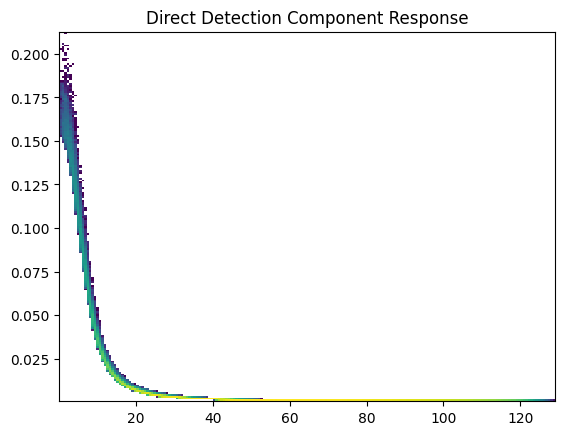

In [66]:
rad = np.linalg.norm(pos[:10000,None,:] - pmt_pos_top[not_dead_pmts][None,:,:],axis=-1)
from matplotlib.colors import LogNorm
plt.hist2d(rad.flatten(), real_data_base.layers[1].predict(pos[:10000]).flatten(),bins=200,norm=LogNorm())
plt.title("Direct Detection Component Response")
plt.show()


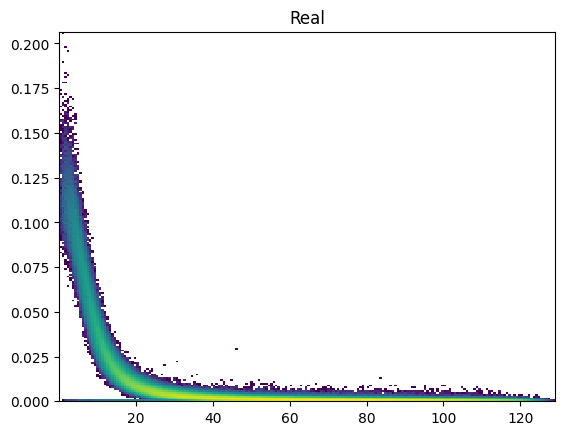

In [63]:
rad = np.linalg.norm(pos[:10000,None,:] - pmt_pos_top[not_dead_pmts][None,:,:],axis=-1)
from matplotlib.colors import LogNorm
real_resp = (patterns[:10000]/patterns[:10000].sum(axis=-1)[:,None]).flatten()
plt.hist2d(rad.flatten(), real_resp,bins=200,norm=LogNorm())
plt.title("Real")
plt.show()


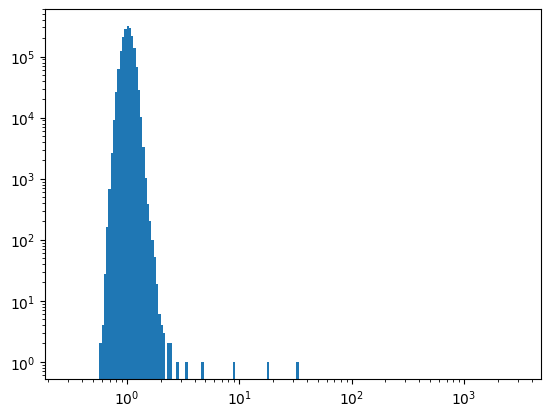

In [ ]:
tmp_res = real_data_base.predict({'xy':pos, 'pattern':patterns})
tmp_res2 = tmp_res.mean(axis=-1)
plt.hist(tmp_res2.flatten(), bins=np.logspace(np.log(tmp_res2[tmp_res2>0].min()),np.log(tmp_res2.max()),200))
plt.xscale('log')
plt.yscale('log')
plt.show()


Operating on 0.5698603105248756 of data (n=1024602)
32019/32019 [==============================] - 143s 4ms/step
Initial mean loss: 1.3333417
Epoch 1/5
16010/16010 [==============================] - 311s 19ms/step - loss: 1.0975
Epoch 2/5
16010/16010 [==============================] - 294s 18ms/step - loss: 1.0972
Epoch 3/5
16010/16010 [==============================] - 290s 18ms/step - loss: 1.0969
Epoch 4/5
16010/16010 [==============================] - 300s 19ms/step - loss: 1.0966
Epoch 5/5
16010/16010 [==============================] - 288s 18ms/step - loss: 1.0968
Epoch 1/5
16010/16010 [==============================] - 283s 18ms/step - loss: 1.0917
Epoch 2/5
16010/16010 [==============================] - 277s 17ms/step - loss: 1.0913
Epoch 3/5
16010/16010 [==============================] - 286s 18ms/step - loss: 1.0910
Epoch 4/5
16010/16010 [==============================] - 283s 18ms/step - loss: 1.0908
Epoch 5/5
64038/64038 [==============================] - 55s 856us/step
Upd

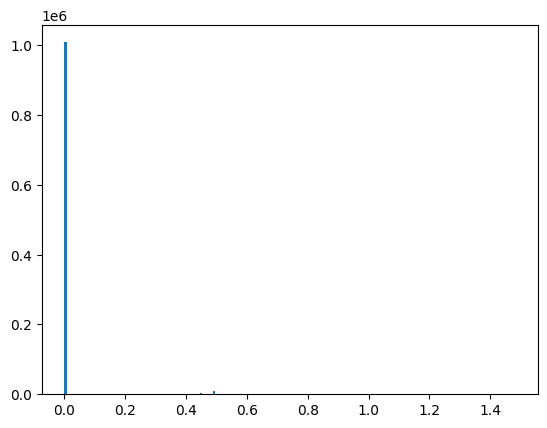

In [149]:
x = keras.layers.Input(shape=(246,),name='prediction')
y = keras.layers.Input(shape=(246,),name='pattern')
out = LossLayerWDense(model_path="Likelihood_yay", switching_signal=40, name="LossLayer")(x, y)
loss_model = keras.models.Model(inputs=(x, y), outputs=out)
loss_model.compile(optimizer='adam', loss=lambda x: x)


# FOr some reason this adds a singleton
print("Operating on {} of data (n={})".format((tmp_res2 > 1).mean(), (tmp_res2 > 1).sum()))
elems = np.argwhere(tmp_res2 > 1)
# Does n iterations of m learning rates of i epochs
pos_refit = do_pos_refit(real_data_base, pos[elems][:,0,:], patterns[elems][:,0,:], loss_function,
                         learning_rates = [0.01, 0.001], epochs = 4,iterations=1, batch_size = 64, init_loss_fun = loss_model)
pos_refit = pos_refit.numpy()
plt.hist(np.linalg.norm(pos[elems][:,0,:] - pos_refit, axis=-1), bins = 200)
plt.show()

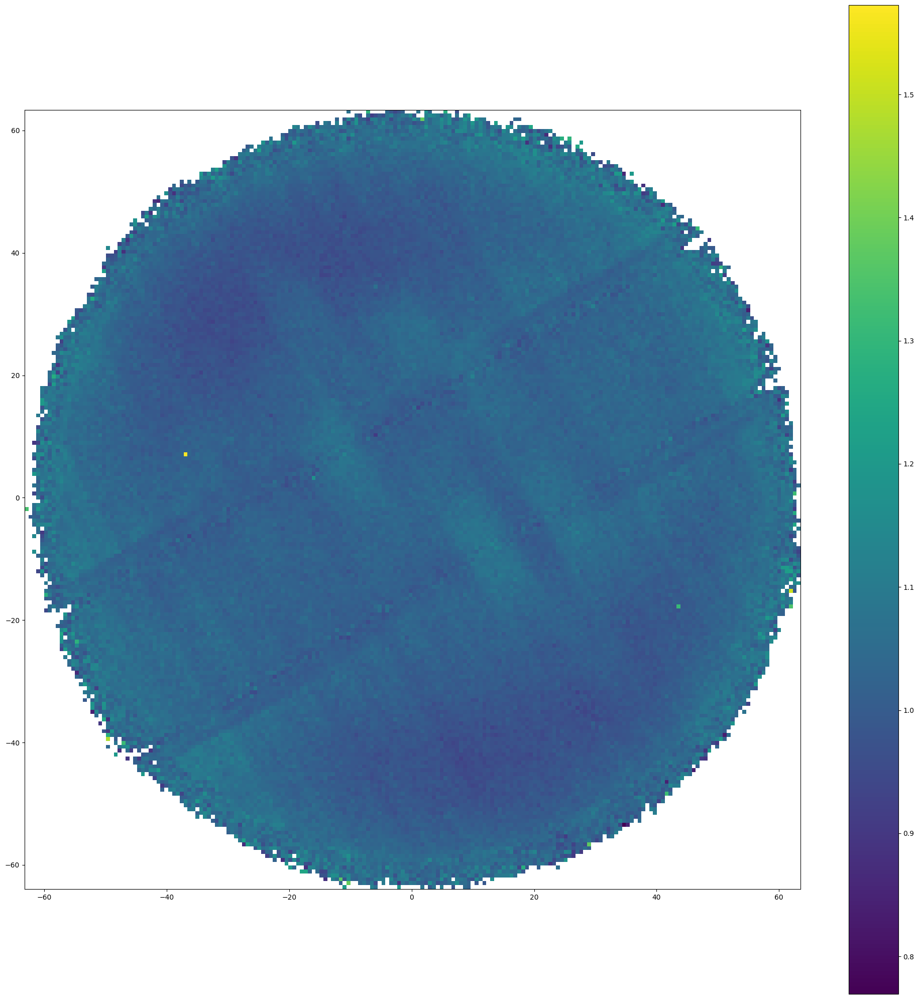

In [154]:
from scipy.stats import binned_statistic_2d

# Do loss map from tmp_res2 and pos

res = binned_statistic_2d(pos[:,0], pos[:,1], tmp_res2, bins=200, statistic='mean')
plt.figure(figsize=(20,20))
plt.imshow(res.statistic, extent=[res.x_edge.min(), res.x_edge.max(), res.y_edge.min(), res.y_edge.max()], origin='lower')
plt.colorbar()
plt.tight_layout()

Text(0.5, 1.0, 'With the Pos Refit elements (n=1024602)')

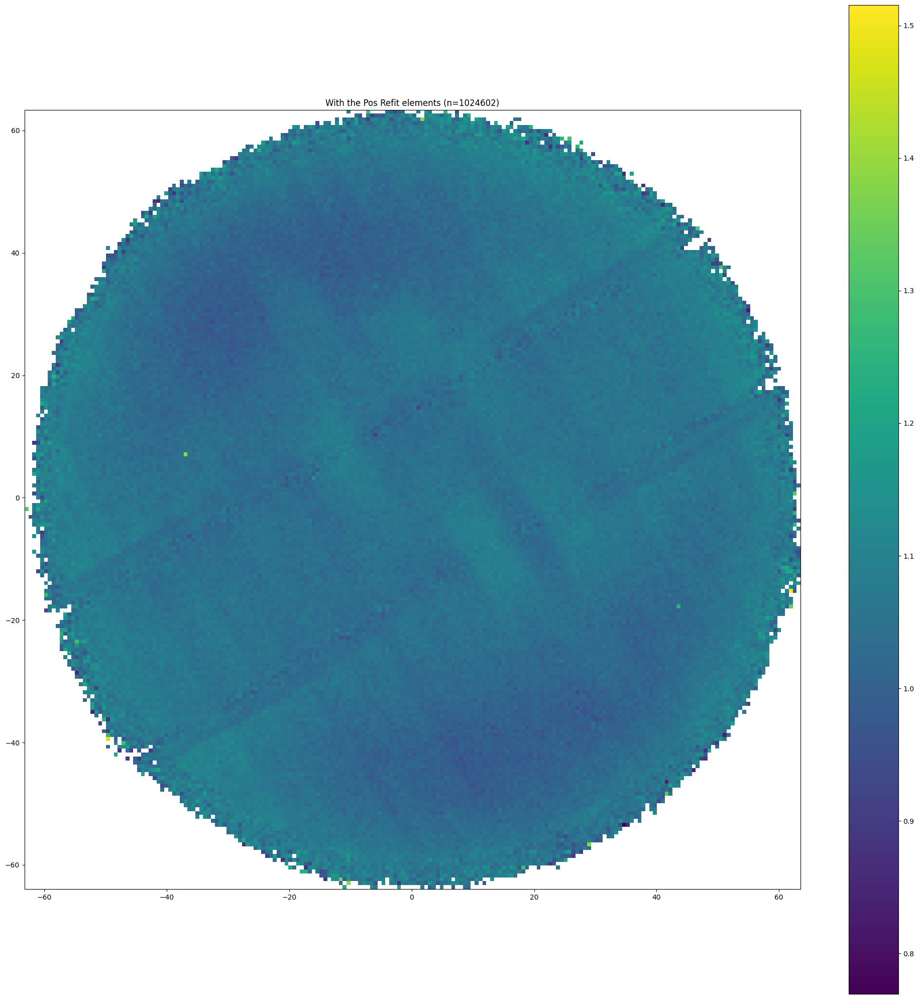

In [155]:
from scipy.stats import binned_statistic_2d

# Do loss map from tmp_res2 and pos



res = binned_statistic_2d(np.hstack([pos[(np.argwhere(~(tmp_res2 > 1.3))[:,0]),0], pos[elems][:,0,0]]), 
                          np.hstack([pos[(np.argwhere(~(tmp_res2 > 1.3))[:,0]),1], pos[elems][:,0,1]]), 
                          np.hstack([tmp_res2[(np.argwhere(~(tmp_res2 > 1.3))[:,0])], tmp_res2[elems][:,0]]), 
                          bins=200, statistic='mean')
plt.figure(figsize=(20,20))
plt.imshow(res.statistic, extent=[res.x_edge.min(), res.x_edge.max(), res.y_edge.min(), res.y_edge.max()], origin='lower')
plt.colorbar()
plt.tight_layout()
plt.title("With the Pos Refit elements (n={})".format(len(elems)))


## It doesnt seem tensorflow actually frees memory properly

TODO:
- Make a function that gets the minimal set running (load data including refitted and required models)
- Find the command to restart the kernel
- And then hopefuly fitting will work
- Likely will have to do one or two cracks at wall reflection since CNF

In [166]:
# And Retrain 
seed = 181332

# Replace refitted
pos[elems][:,0,:] = pos_refit


np.random.seed(seed)
indices = np.arange(len(pos))
np.random.shuffle(indices)
train_split = 0.8
train_idx = indices[:int(train_split*n)]
val_idx = indices[int(train_split*n):]
X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]

real_data_base = tmp(direct_model_params = [['tanh', 'tanh', 'exponential'], [256,None]], reflection_model_params =[['tanh', 'tanh', 'exponential'], [2**4, 2**4]], seed = seed,epochs=5)
llayer=get_minimal_Shenyang_Loss()
pred = llayer({'prediction':keras.amodels.Model(inputs=real_data_base.get_layer('xy').input, outputs=real_data_base.get_layer('normalization').output).predict(pos[:len(pos)//3]),'pattern':patterns[:len(pos)//3]})
print("Shenyang")
print(np.mean(pred), np.sort(pred)[len(pred)//2], seed)
del pred
pred = loss_model({'prediction':keras.models.Model(inputs=real_data_base.get_layer('xy').input, outputs=real_data_base.get_layer('normalization').output).predict(pos[:len(pos)//3]),'pattern':patterns[:len(pos)//3]})
print("New")
print(np.mean(pred), np.sort(pred)[len(pred)//2], seed)

del pred

Epoch 1/5
79/79 [==============================] - 165s 2s/step - loss: 2.1845 - val_loss: 1.1217 - lr: 0.0010
Epoch 2/5
79/79 [==============================] - 155s 2s/step - loss: 1.0966 - val_loss: 1.1035 - lr: 0.0010
Epoch 3/5
18730/18730 [==============================] - 62s 3ms/step
Shenyang
1.3566846 1.3098484 181332
18730/18730 [==============================] - 66s 4ms/step


2025-03-10 19:59:53.964075: W external/local_tsl/tsl/framework/bfc_allocator.cc:485] Allocator (mklcpu) ran out of memory trying to allocate 31.71GiB (rounded to 34052113920)requested by op _MklMatMul
If the cause is memory fragmentation maybe the environment variable 'TF_GPU_ALLOCATOR=cuda_malloc_async' will improve the situation. 
Current allocation summary follows.
Current allocation summary follows.
2025-03-10 19:59:53.974806: I external/local_tsl/tsl/framework/bfc_allocator.cc:1039] BFCAllocator dump for mklcpu
2025-03-10 19:59:53.974828: I external/local_tsl/tsl/framework/bfc_allocator.cc:1046] Bin (256): 	Total Chunks: 0, Chunks in use: 0. 0B allocated for chunks. 0B in use in bin. 0B client-requested in use in bin.
2025-03-10 19:59:53.974834: I external/local_tsl/tsl/framework/bfc_allocator.cc:1046] Bin (512): 	Total Chunks: 0, Chunks in use: 0. 0B allocated for chunks. 0B in use in bin. 0B client-requested in use in bin.
2025-03-10 19:59:53.974840: I external/local_tsl/tsl/fra

ResourceExhaustedError: Exception encountered when calling layer 'dense_42' (type Dense).

{{function_node __wrapped____MklMatMul_device_/job:localhost/replica:0/task:0/device:CPU:0}} OOM when allocating tensor with shape[133016070,64] and type float on /job:localhost/replica:0/task:0/device:CPU:0 by allocator mklcpu [Op:MatMul] name: 

Call arguments received by layer 'dense_42' (type Dense):
  • inputs=tf.Tensor(shape=(133016070, 2), dtype=float32)

313/313 [==============================] - 1s 2ms/step


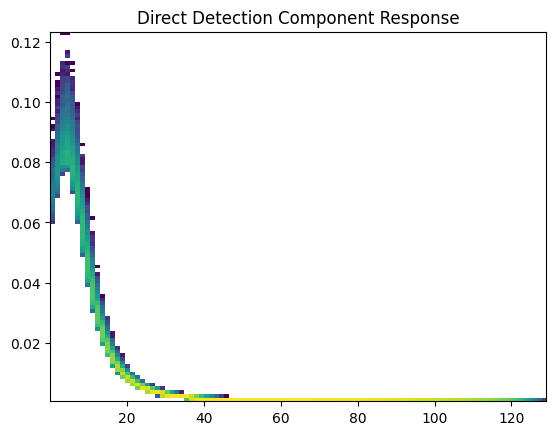

In [169]:
rad = np.linalg.norm(pos[:10000,None,:] - pmt_pos_top[not_dead_pmts][None,:,:],axis=-1)
from matplotlib.colors import LogNorm
plt.hist2d(rad.flatten(), real_data_base.layers[1].predict(pos[:10000]).flatten(),bins=100,norm=LogNorm())
plt.title("Direct Detection Component Response")
plt.show()

In [16]:
# Tunring off Radial term act doesnt work, needs to be trained simultaneously 
real_data_base.get_layer('Wall_Reflection_Pattern_Response').trainable = True
real_data_base.get_layer('MultiplicationLayer').trainable = True
real_data_base.get_layer('PMTDistance_Pattern_Response').trainable = True
def tmp():
    # And Fit again 
    real_data_base.compile(optimizer=Adam(learning_rate=0.0001), 
                        loss=loss_function,)

    early_stopping = EarlyStopping(monitor='val_loss', patience=5, min_delta=0.01, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=1, min_delta=0.02)
    # And train 
    real_data_base.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=32*32,
                        )
    # And equivalent Metric
    tmp = keras.models.Model(inputs=real_data_base.get_layer('xy').input, outputs=real_data_base.get_layer('normalization').output)
    llayer=get_minimal_Shenyang_Loss()
    print("Shenyang Loss: ", np.mean(llayer({'prediction':tmp.predict(pos),'pattern':patterns})))
# Using OG Pos 1.0111359
tmp()

Epoch 1/100
 40/782 [>.............................] - ETA: 58s - loss: nan

KeyboardInterrupt: 

In [ ]:
with tf.device('/cpu:0'):
    new_pos = do_pos_refit(real_data_base, pos_refit, patterns, loss_function)
new_pos = new_pos.astype("float32")

56191/56191 [==============================] - 142s 3ms/step
1.0301238
112382/112382 [==============================] - 92s 819us/step
1.02923
112382/112382 [==============================] - 96s 852us/step
1.0284433
112382/112382 [==============================] - 94s 833us/step
1.0277569
112382/112382 [==============================] - 106s 938us/step
1.0271597
112382/112382 [==============================] - 91s 806us/step
1.0266439


In [119]:
def tmp():
    real_data_with_anode = gen_model_with_anode(seed=seed, real_data=True, starting_model=real_data_base)
    # Make everything but I0 and anode untrainable
    real_data_with_anode.get_layer('Wall_Reflection_Pattern_Response').trainable = True
    real_data_with_anode.get_layer('PMTDistance_Pattern_Response').trainable = True
    real_data_with_anode.get_layer('MultiplicationLayer').trainable = True

    real_data_with_anode.compile(optimizer=Adam(learning_rate=0.001), 
                        loss=loss_function,)

    early_stopping = EarlyStopping(monitor='val_loss', patience=5, min_delta=0.01, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=1, min_delta=0.02)
    # And train 
    real_data_with_anode.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=32*32,
                        )
    # And equivalent Metric
    tmp = keras.models.Model(inputs=real_data_with_anode.get_layer('xy').input, outputs=real_data_with_anode.get_layer('normalization').output)
    llayer=get_minimal_Shenyang_Loss()
    #print("Shenyang Loss: ", np.mean(llayer({'prediction':tmp.predict(pos),'pattern':patterns})))
    return real_data_with_anode
real_data_with_anode = tmp()

Epoch 1/100
79/79 [==============================] - 5s 44ms/step - loss: 1.0188 - val_loss: 1.0132 - lr: 0.0010
Epoch 2/100
79/79 [==============================] - 3s 37ms/step - loss: 0.9983 - val_loss: 1.0130 - lr: 0.0010
Epoch 3/100
79/79 [==============================] - 3s 35ms/step - loss: 1.0059 - val_loss: 1.0042 - lr: 1.0000e-04
Epoch 4/100
79/79 [==============================] - 3s 34ms/step - loss: 1.0578 - val_loss: 1.0049 - lr: 1.0000e-05
Epoch 5/100
79/79 [==============================] - 3s 34ms/step - loss: 1.0081 - val_loss: 1.0049 - lr: 1.0000e-06
Epoch 6/100
79/79 [==============================] - 3s 35ms/step - loss: 1.0095 - val_loss: 1.0049 - lr: 1.0000e-07


In [120]:
# FUCK TENSORFLWO WHY DOES IT FAIL NOW IT WORKED BEFORE WITH THE SAME SHAPES
new_pos2 = np.zeros(pos.shape, dtype='float32')
chunk_size = len(pos) // 5
for i in range(5):
    start = i * chunk_size
    stop = min((i + 1) * chunk_size, len(pos))
    new_pos2[start:stop] = do_pos_refit(real_data_with_anode, pos[start:stop], patterns[start:stop], loss_function)
new_pos2 = new_pos2.astype("float32")

11239/11239 [==============================] - 30s 3ms/step
1.0262173
22477/22477 [==============================] - 20s 867us/step
1.0253913
22477/22477 [==============================] - 20s 882us/step
1.024671
22477/22477 [==============================] - 24s 1ms/step
1.0240489
22477/22477 [==============================] - 26s 1ms/step
1.0235108
22477/22477 [==============================] - 25s 1ms/step
1.0230407
11239/11239 [==============================] - 46s 4ms/step
1.0266241
22477/22477 [==============================] - 26s 1ms/step
1.0257951
22477/22477 [==============================] - 24s 1ms/step
1.0250747
22477/22477 [==============================] - 25s 1ms/step
1.0244488
22477/22477 [==============================] - 24s 1ms/step
1.0239028
22477/22477 [==============================] - 20s 891us/step
1.0234326
11239/11239 [==============================] - 32s 3ms/step
1.025991
22477/22477 [==============================] - 26s 1ms/step
1.0251632
22477/22477 [===

In [121]:
X_train, Y_train = {'xy':new_pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
X_val, Y_val =     {'xy':new_pos[val_idx],   'pattern':patterns[val_idx]},   patterns[val_idx]
def tmp():
    real_data_with_anode_np = gen_model_with_anode(seed=seed, real_data=True, starting_model=real_data_base)
    # Make everything but I0 and anode untrainable
    real_data_with_anode_np.get_layer('Wall_Reflection_Pattern_Response').trainable = False
    real_data_with_anode_np.get_layer('PMTDistance_Pattern_Response').trainable = False
    real_data_with_anode_np.get_layer('MultiplicationLayer').trainable = False

    real_data_with_anode_np.compile(optimizer=Adam(learning_rate=0.00), 
                        loss=loss_function,)

    early_stopping = EarlyStopping(monitor='val_loss', patience=5, min_delta=0.01, restore_best_weights=True)
    lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=1, min_delta=0.02)
    # And train 
    real_data_with_anode_np.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, 
                    callbacks=[
                        early_stopping, 
                        lr_reduce
                        ],
                        batch_size=32*32,
                        )
    # And equivalent Metric
    tmp = keras.models.Model(inputs=real_data_with_anode_np.get_layer('xy').input, outputs=real_data_with_anode_np.get_layer('normalization').output)
    llayer=get_minimal_Shenyang_Loss()
    print("Shenyang Loss: ", np.mean(llayer({'prediction':tmp.predict(pos),'pattern':patterns})))
    return real_data_with_anode_np
real_data_with_anode_np = tmp()

Epoch 1/100
79/79 [==============================] - 2s 21ms/step - loss: 1.0080 - val_loss: 1.0143 - lr: 0.0000e+00
Epoch 2/100
79/79 [==============================] - 1s 19ms/step - loss: 0.9897 - val_loss: 1.0143 - lr: 0.0000e+00
Epoch 3/100
79/79 [==============================] - 1s 18ms/step - loss: 1.0093 - val_loss: 1.0143 - lr: 0.0000e+00
Epoch 4/100
79/79 [==============================] - 1s 18ms/step - loss: 1.0649 - val_loss: 1.0143 - lr: 0.0000e+00
Epoch 5/100
79/79 [==============================] - 1s 18ms/step - loss: 1.0165 - val_loss: 1.0143 - lr: 0.0000e+00
Epoch 6/100
56191/56191 [==============================] - 228s 4ms/step
Shenyang Loss:  1.030124


In [122]:
new_pos3 = do_pos_refit(real_data_with_anode_np, new_pos, patterns, loss_function)
new_pos3 = new_pos3.astype("float32")

56191/56191 [==============================] - 196s 3ms/step
1.0266439
112382/112382 [==============================] - 115s 1ms/step
1.0261965
112382/112382 [==============================] - 113s 1ms/step
1.0258074
112382/112382 [==============================] - 107s 949us/step
1.0254728
112382/112382 [==============================] - 103s 918us/step
1.0251837
112382/112382 [==============================] - 104s 909us/step
1.024932


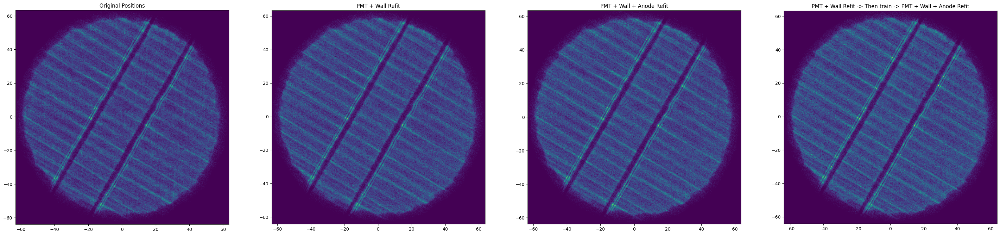

In [ ]:
from scipy.stats import binned_statistic_2d
# Do 2D binning on test
def tmp():
    fig,ax = plt.subplots(1,4,figsize=(40,10))
    stat = binned_statistic_2d(pos[:,0], pos[:,1], np.ones((len(pos))),statistic='sum', bins=480) # Min bins for anode shadow
    ax[0].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[0].set_title('Original Positions')
    stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], np.ones((len(pos))),statistic='sum', bins=480)
    ax[1].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[1].set_title('PMT + Wall Refit')
    stat = binned_statistic_2d(new_pos2[:,0], new_pos2[:,1], np.ones((len(pos))),statistic='sum', bins=480)
    ax[2].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[2].set_title('PMT + Wall + Anode Refit')
    stat = binned_statistic_2d(new_pos3[:,0], new_pos3[:,1], np.ones((len(pos))),statistic='sum', bins=480)
    ax[3].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[3].set_title('PMT + Wall Refit -> Then train -> PMT + Wall + Anode Refit')
tmp()
plt.show()

56191/56191 [==============================] - 133s 2ms/step


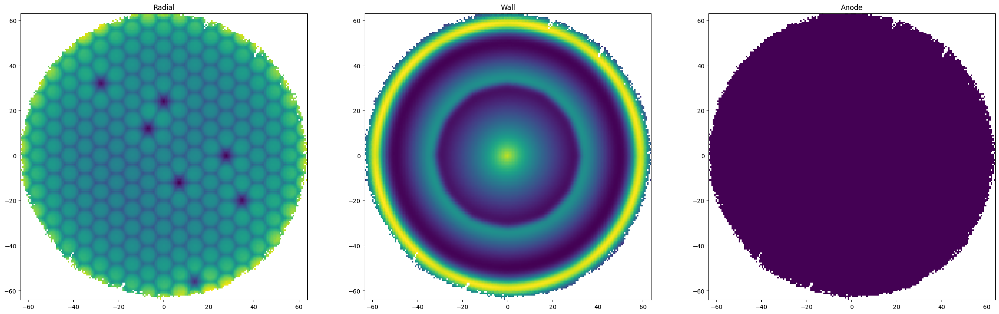

In [124]:
# Check what each submodel predicts 
def tmp():
    fig,ax = plt.subplots(1,3,figsize=(30,10))

    stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], np.max(real_data_with_anode.layers[1].predict(new_pos),axis=-1),statistic='mean', bins=200) # Min bins for anode shadow 480
    ax[0].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[0].set_title('Radial')
    stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], np.max(real_data_with_anode.layers[2].predict(new_pos),axis=-1),statistic='mean', bins=200)
    ax[1].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[1].set_title('Wall')
    stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], np.max(real_data_with_anode.layers[3].predict(new_pos),axis=-1),statistic='mean', bins=200)
    ax[2].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[2].set_title('Anode')
tmp()
plt.show()

56191/56191 [==============================] - 147s 3ms/step


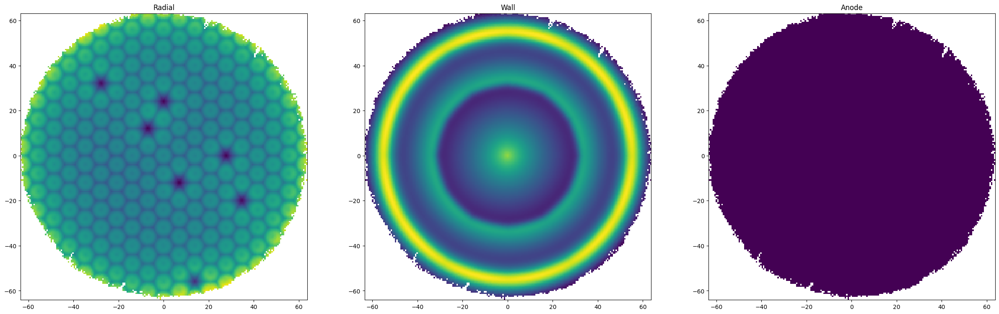

In [125]:
# Check what each submodel predicts 
def tmp():
    fig,ax = plt.subplots(1,3,figsize=(30,10))

    stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], np.max(real_data_with_anode_np.layers[1].predict(new_pos),axis=-1),statistic='mean', bins=200) # Min bins for anode shadow 480
    ax[0].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[0].set_title('Radial')
    stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], np.max(real_data_with_anode_np.layers[2].predict(new_pos),axis=-1),statistic='mean', bins=200)
    ax[1].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[1].set_title('Wall')
    stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], np.max(real_data_with_anode_np.layers[3].predict(new_pos),axis=-1),statistic='mean', bins=200)
    ax[2].imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])
    ax[2].set_title('Anode')
tmp()
plt.show()

56191/56191 [==============================] - 125s 2ms/step


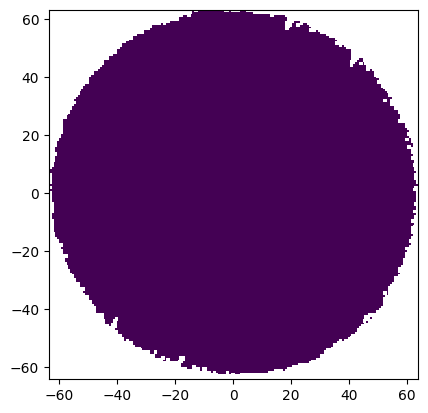

In [130]:
stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], real_data_with_anode_np.layers[3].predict(new_pos)[:,122],statistic='mean', bins=200)
plt.imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0], stat.x_edge[-1], stat.y_edge[0], stat.y_edge[-1]])

56191/56191 [==============================] - 150s 3ms/step


(array([[0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 6.0000e+00, 1.0000e+01,
         4.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 1.0000e+01, 7.0000e+00,
         1.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2032e+04, 0.0000e+00, 0.0000e+00, ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.0030e+03, 0.0000e+00, 0.0000e+00, ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.8600e+02, 0.0000e+00, 0.0000e+00, ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]]),
 array([9.05308500e-03, 1.30936233e+00, 2.60967158e+00, 3.90998083e+00,
        5.21029008e+00, 6.51059933e+00, 7.81090858e+00, 9.11121783e+00,
        1.04115271e+01, 1.17118363e+01, 1.30121456e+01, 1.43124548e+01,
        1.56127641e+01, 1.69130733e+01, 1.82133826e+01, 1.95136918e+01,
        2.08140011e+01, 2.21143103e+01, 2.34146196e+01, 2.47149288e+01,
        2.60152381e+01, 2.73155473e+01, 2.8615856

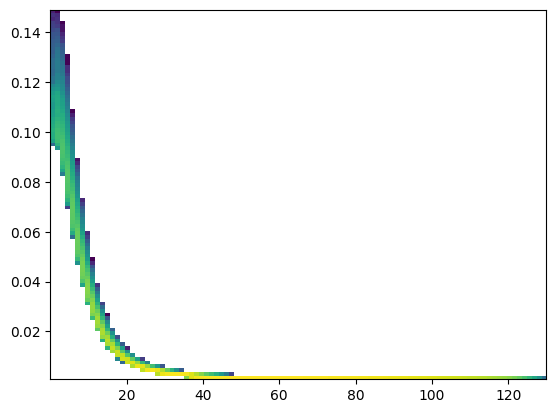

In [126]:
rad = np.linalg.norm(new_pos[:,None,:] - pmt_pos_top[not_dead_pmts][None,:,:],axis=-1)
from matplotlib.colors import LogNorm
plt.hist2d(rad.flatten(), real_data_with_anode.layers[1].predict(new_pos).flatten(),bins=100,norm=LogNorm())

## TODO

Right now pretrain the refit

Next: Refit then train anode then refit 



In [14]:
# Do Position Refinement
new_pos = pos.copy()
llayer=get_minimal_Shenyang_Loss()
f_loss = llayer({'prediction':keras.models.Model(inputs=real_data_with_anode.get_layer('xy').input, outputs=real_data_with_anode.get_layer('normalization').output).predict(pos),'pattern':patterns})
print(np.mean(f_loss))
for i in range(5):
    encoder_model = make_encoder(real_data_with_anode, new_pos + np.random.normal(0, 0.1, pos.shape), patterns)
    encoder_model.compile(optimizer='adam', loss=loss_function)
    encoder_model.fit(np.arange(len(new_pos)), patterns, epochs=1, batch_size=32*16)

    tmp = encoder_model.get_layer('embed_pos').get_weights()[0]
    tmp_loss = llayer({'prediction':
                       keras.models.Model(inputs=real_data_with_anode.get_layer('xy').input, outputs=real_data_with_anode.get_layer('normalization').output).predict(tmp),
                       'pattern':patterns})

    new_pos = np.where((tmp_loss < f_loss)[:,None], tmp, new_pos)
    f_loss = np.where((tmp_loss < f_loss), tmp_loss, f_loss)
    print(np.mean(f_loss))
del tmp, tmp_loss
# Using OG Pos 1.0087492
# Using Shenyang Pos 

40317/40317 [==============================] - 106s 3ms/step
1.0140556
40317/40317 [==============================] - 112s 3ms/step
1.0084003
40317/40317 [==============================] - 109s 3ms/step
1.0057906
40317/40317 [==============================] - 121s 3ms/step
1.0039628
40317/40317 [==============================] - 121s 3ms/step
1.0024912
40317/40317 [==============================] - 118s 3ms/step


2025-03-01 16:12:56.307995: W external/local_tsl/tsl/framework/bfc_allocator.cc:485] Allocator (mklcpu) ran out of memory trying to allocate 1.18GiB (rounded to 1269477120)requested by op Lgamma
If the cause is memory fragmentation maybe the environment variable 'TF_GPU_ALLOCATOR=cuda_malloc_async' will improve the situation. 
Current allocation summary follows.
Current allocation summary follows.
2025-03-01 16:12:56.310298: I external/local_tsl/tsl/framework/bfc_allocator.cc:1039] BFCAllocator dump for mklcpu
2025-03-01 16:12:56.310407: I external/local_tsl/tsl/framework/bfc_allocator.cc:1046] Bin (256): 	Total Chunks: 0, Chunks in use: 0. 0B allocated for chunks. 0B in use in bin. 0B client-requested in use in bin.
2025-03-01 16:12:56.310440: I external/local_tsl/tsl/framework/bfc_allocator.cc:1046] Bin (512): 	Total Chunks: 0, Chunks in use: 0. 0B allocated for chunks. 0B in use in bin. 0B client-requested in use in bin.
2025-03-01 16:12:56.310465: I external/local_tsl/tsl/framework

ResourceExhaustedError: Exception encountered when calling layer 'LossLayer' (type LikelihoodMod).

{{function_node __wrapped__Lgamma_device_/job:localhost/replica:0/task:0/device:CPU:0}} OOM when allocating tensor with shape[1290119,246] and type float on /job:localhost/replica:0/task:0/device:CPU:0 by allocator mklcpu [Op:Lgamma] name: 

Call arguments received by layer 'LossLayer' (type LikelihoodMod):
  • inputs=['tf.Tensor(shape=(1290119, 246), dtype=float32)', 'tf.Tensor(shape=(1290119, 246), dtype=float32)']

In [16]:
r_resp = real_data_base.layers[1].predict(new_pos)
wall_resp = real_data_base.layers[2].predict(new_pos)* real_data_base.get_layer("MultiplicationLayer").weights[0][-1].numpy()
full_resp = r_resp + wall_resp
r_resp = r_resp / np.sum(full_resp,axis=-1)[:,None]
wall_resp = wall_resp / np.sum(full_resp,axis=-1)[:,None]

remainder = (patterns/patterns.sum(axis=-1)[:,None])/full_resp

40317/40317 [==============================] - 114s 3ms/step


KeyboardInterrupt: 

In [18]:
full_resp = keras.models.Model(inputs=real_data_with_anode.get_layer('xy').input, outputs=real_data_with_anode.get_layer('normalization').output).predict(new_pos)

remainder = (patterns/patterns.sum(axis=-1)[:,None])/full_resp

40317/40317 [==============================] - 118s 3ms/step


Text(0.5, 1.0, 'Per PMT Remainder (pattern/full_resp)')

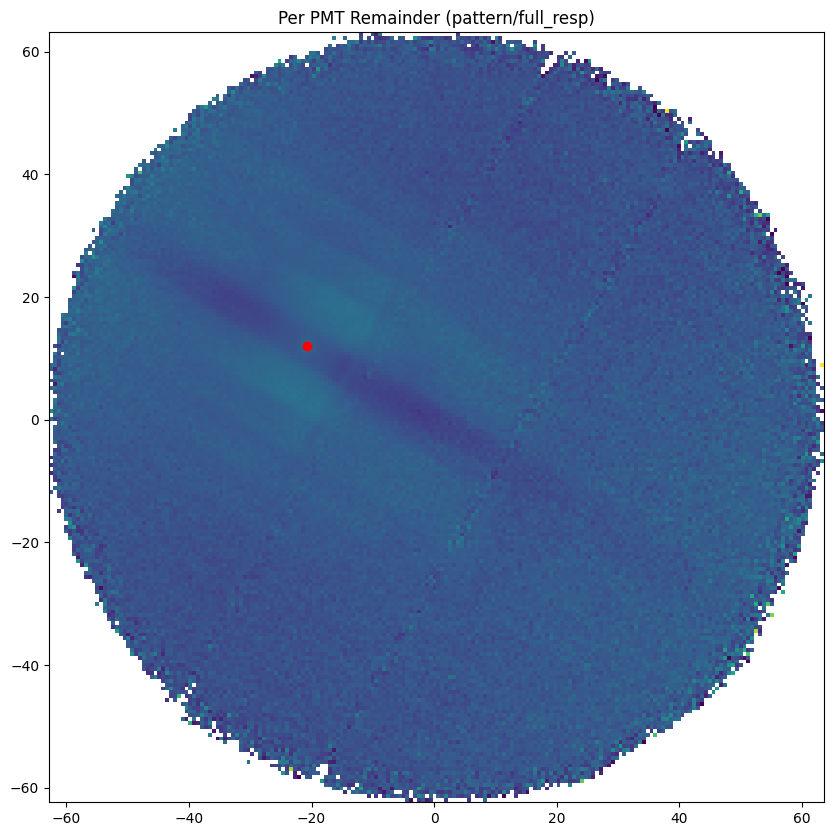

In [19]:
# 2d histogram binning
from scipy.stats import binned_statistic_2d
test = remainder[:,126]
# Do 2D binning on test
stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower',extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][126,0],pmt_pos_top[not_dead_pmts][126,1], c='r')
plt.title("Per PMT Remainder (pattern/full_resp)")


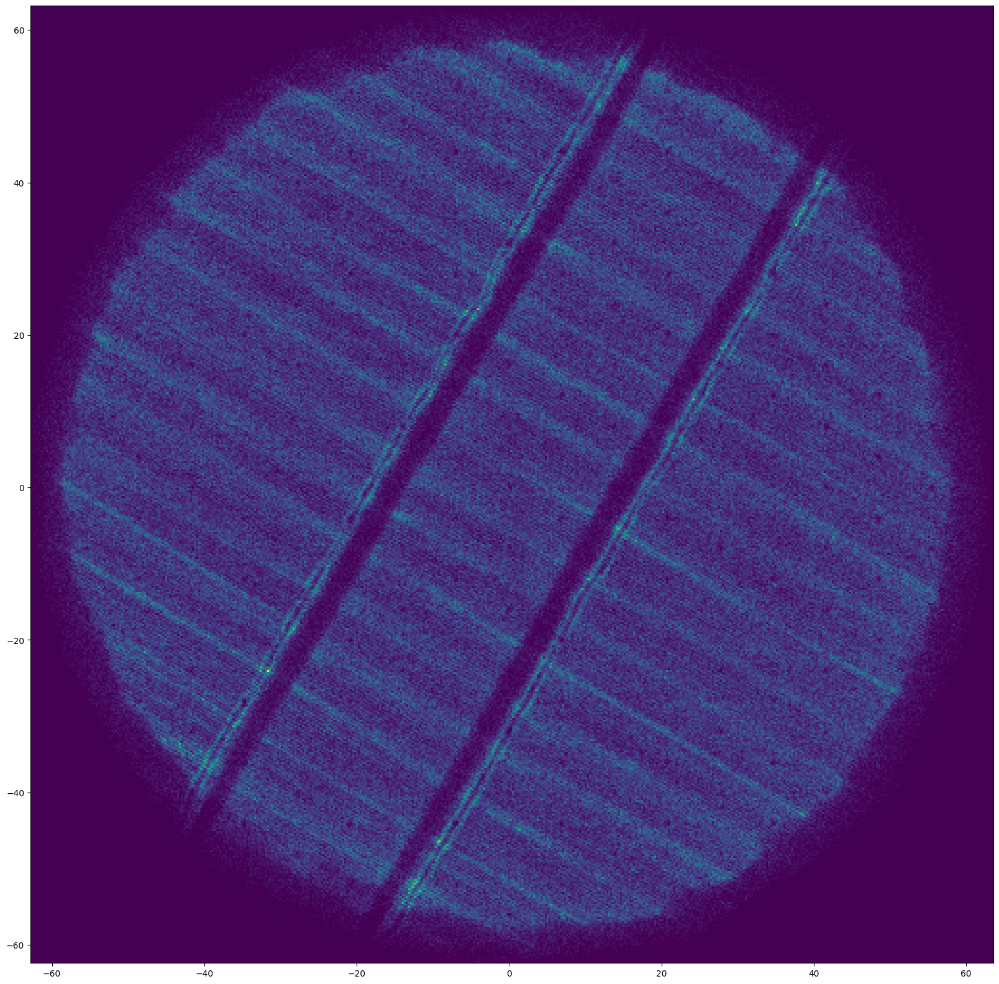

In [24]:
plt.figure(figsize=(20,20))

plt.hist2d(new_pos[:,0], new_pos[:,1] ,bins=500)
# Equal axis scaling
plt.gca().set_aspect('equal', adjustable='box')

Text(0.5, 1.0, 'Per PMT Remainder (pattern/full_resp)')

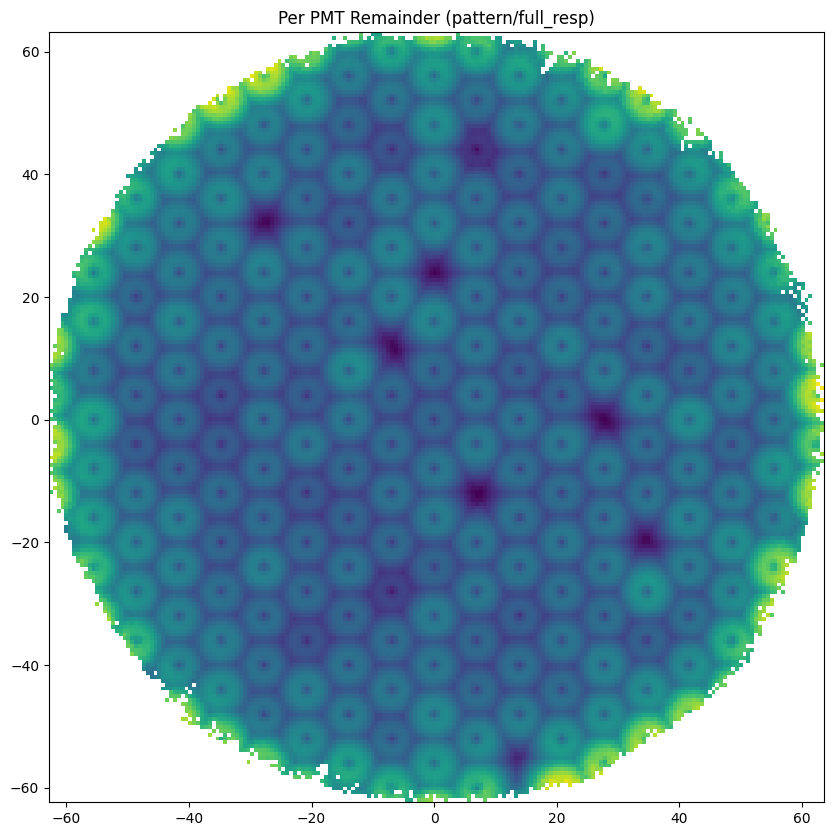

In [26]:
# 2d histogram binning
from scipy.stats import binned_statistic_2d
test = np.max(full_resp,axis=-1)
# Do 2D binning on test
stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower',extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.title("Per PMT Remainder (pattern/full_resp)")


In [ ]:
# Quick Radial MC Comparison - Full Dataset

radial_mc = get_radial_LCE()
np.mean(radial_mc.predict({'xx':pos, 'yy':patterns}))

Model: "Radial_mc"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 xx (InputLayer)             [(None, 2)]                  0         []                            
                                                                                                  
 repeat_vector (RepeatVecto  (None, 246, 2)               0         ['xx[0][0]']                  
 r)                                                                                               
                                                                                                  
 Event_Distance (GetRadius)  (None, 246)                  492       ['repeat_vector[0][0]']       
                                                                                                  
 radial_LCE (RadialLCELayer  (None, 246)                  4         ['Event_Distance[0][0]

1.035985

1/1 [==============================] - 0s 102ms/step


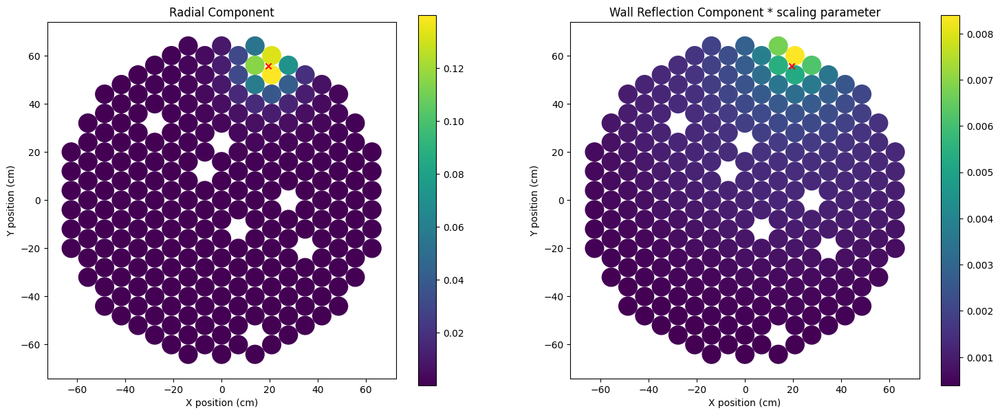

In [372]:
# Plotting 
fig, ax =plt.subplots(1,2, figsize=(18,7))

# Try to use the same index
if 'idx' not in locals():
    idx = np.random.randint(0, len(X_val))

pos_idxd = X_val['xy'][idx]
r_resp = real_data_base.layers[1].predict(pos_idxd.reshape(1,2))[0]
wall_resp = real_data_base.layers[2].predict(pos_idxd.reshape(1,2))[0]
plot_pmt_response(pmt_pos_top[not_dead_pmts], r_resp, ax=ax[0],mark_spot=pos_idxd, title="Radial Component")
plot_pmt_response(pmt_pos_top[not_dead_pmts], wall_resp * real_data_base.get_layer("MultiplicationLayer").weights[0][-1].numpy(), ax=ax[1],mark_spot=pos_idxd, title="Wall Reflection Component * scaling parameter")
plt.show()

1/1 [==============================] - 0s 20ms/step


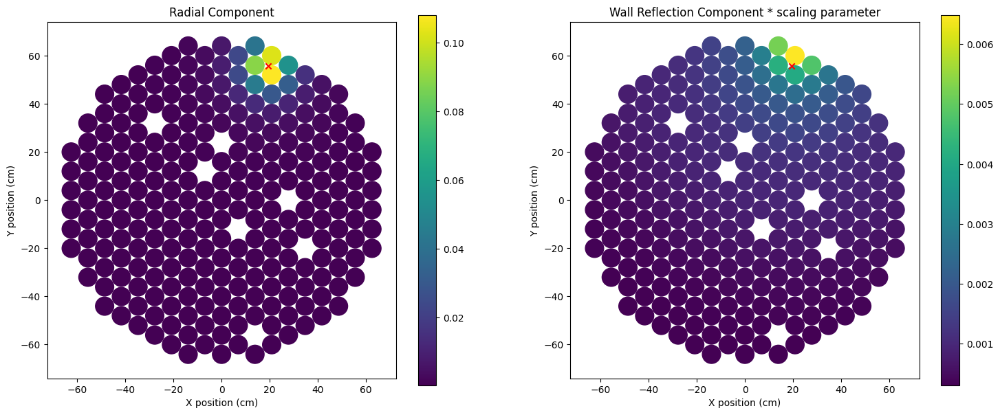

In [373]:
# Plotting 
fig, ax =plt.subplots(1,2, figsize=(18,7))

# Try to use the same index
if 'idx' not in locals():
    idx = np.random.randint(0, len(X_val))

pos_idxd = X_val['xy'][idx]
r_resp = real_data_base.layers[1].predict(pos_idxd.reshape(1,2))[0]
wall_resp = real_data_base.layers[2].predict(pos_idxd.reshape(1,2))[0]* real_data_base.get_layer("MultiplicationLayer").weights[0][-1].numpy()
full_resp = r_resp + wall_resp
r_resp = r_resp / np.sum(full_resp,axis=-1)
wall_resp = wall_resp / np.sum(full_resp,axis=-1)
plot_pmt_response(pmt_pos_top[not_dead_pmts], r_resp, ax=ax[0],mark_spot=pos_idxd, title="Radial Component")
plot_pmt_response(pmt_pos_top[not_dead_pmts], wall_resp , ax=ax[1],mark_spot=pos_idxd, title="Wall Reflection Component * scaling parameter")
plt.show()

[autoreload of layer_definitions failed: Traceback (most recent call last):
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 500, in superreload
    update_generic(old_obj, new_obj)
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 397, in update_generic
    update(a, b)
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 349, in update_class
    if update_generic(old_obj, new_obj):
  File "/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 397, in update_generic
    update(a, b)
  File "/opt/XENONnT/anaconda/envs/XENONn

<Axes: title={'center': 'PMT Area blocked'}, xlabel='X position (cm)', ylabel='Y position (cm)'>

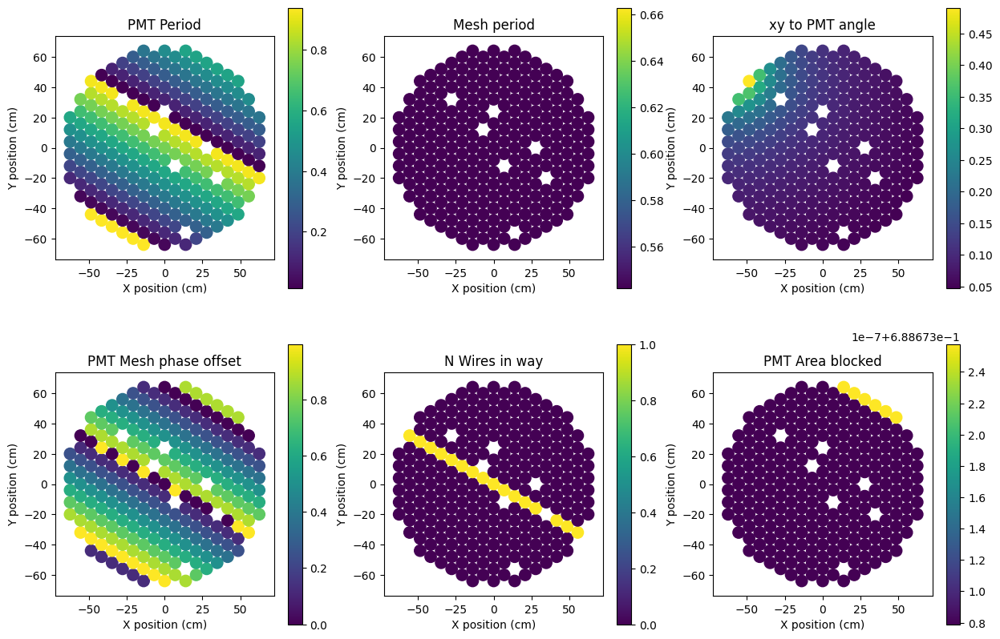

In [406]:
# Plot Anode Shadow

res = Anode_Parametrization(pmt_pos_top[not_dead_pmts], straxen.tpc_pmt_radius)(tf.convert_to_tensor([[-60,50.]])).numpy()[0]
fig,ax = plt.subplots(2,3, figsize=(15,10))
ax= ax.flatten()

plot_pmt_response(pmt_pos_top[not_dead_pmts], res[:,0], ax=ax[0], title="PMT Period")
plot_pmt_response(pmt_pos_top[not_dead_pmts], res[:,1], ax=ax[1], title="Mesh period")
plot_pmt_response(pmt_pos_top[not_dead_pmts], res[:,2], ax=ax[2], title="xy to PMT angle")
plot_pmt_response(pmt_pos_top[not_dead_pmts], res[:,3], ax=ax[3], title="PMT Mesh phase offset")
plot_pmt_response(pmt_pos_top[not_dead_pmts], res[:,4], ax=ax[4], title="N Wires in way")
plot_pmt_response(pmt_pos_top[not_dead_pmts], res[:,5], ax=ax[5], title="PMT Area blocked")

In [397]:
### And now we can train our Loss Function

"""
Problem: Gradient always goes NaN and Im not sure why 
- Even if we can fix this, just training this layer for 288 elements takes around 2 minutes 

So this is not a solution

Potential Solutions:
- Fit model std's based on shenyangs parametrization - Train neural net and use that for computing loss
- Use Shenyangs Parametrization directly and then deal with this if there is time
    - Potentially by enforcing Chi squared distribution -> This will take a few days (to run) and will have to assume perfect model
        - This can then be done iteratively with : Fit Model -> Refine Pos -> Fit Model -> Refine Std -> Repeat
    - Alternatively need to find a way to force the mdoel to not over estimate the standard deviations 


Other issues:
- Anode Shadow Layer
    - My favorite parametrization uses the number of PMTs in the way but I have not observed a position yet that has more than one row of PMTs affectd which seems very weird  
- Perpendicular Wire Layer
    - Same logic can be applied
    - However, for both layers I feel we maybe should also be emulating electric field efects moving electrons around before the S2
- What Other Layers
    - I feel some effect is missign but I cant think of anything

    
Other things i can try:
- Feature importance analysis of Shenyangs model
    - Takes a lot of time
- Try to apply layer using Shenyangs inputs and see if it works
    - THen try to isolate which parts actually help and which dont -> Allthough I vaguely feel like I tried this before 
- Invert CNF sounds farly interesting as suggested in pres, but given its similarity with radial LCE refinement I assume it will produce a similar LCE

    
"""





# Now Real Data - With Shenyangs Likelihood - All is set to train false except loss 
real_full_l_base = gen_model_starter(seed=seed, real_data=True, starting_model=sim_data_base, loss_func = 'full')

# ------------------------------   Do Data -------------------------------#
indices = np.arange(n)
np.random.shuffle(indices)
train_split = 0.8
train_idx = indices[:int(train_split*n)]
val_idx = indices[int(train_split*n):]
X_train, Y_train = {'xy':pos[train_idx], 'pattern':patterns[train_idx]}, patterns[train_idx]
X_val, Y_val = {'xy':pos[val_idx], 'pattern':patterns[val_idx]}, patterns[val_idx]

# ------------------------- Loss & Compile -------------------------------#
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
def loss_function(y_true, y_pred):
    return y_pred[0]

real_full_l_base.compile(optimizer=Adam(learning_rate=1e-35,clipnorm=1, epsilon=1), 
                       loss=loss_function,)

early_stopping = EarlyStopping(monitor='val_loss', patience=6, min_delta=0.5, restore_best_weights=True)
lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor = 0.1, patience=3, min_delta=1)
# And train 
real_full_l_base.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, 
                   callbacks=[
                       early_stopping, 
                       lr_reduce
                       ],
                    batch_size=32*4
                    )
# And equivalent Metric
tmp = keras.models.Model(inputs=real_full_l_base.get_layer('xy').input, outputs=real_full_l_base.get_layer('normalization').output)
llayer=get_minimal_Shenyang_Loss()
print("Scaled MSE: ", loss_function_MSE_scaled(Y / np.sum(Y, axis=-1)[:,None], tmp.predict(X)).numpy())
print("Shenyang Loss: ", np.mean(llayer({'prediction':tmp.predict(pos),'pattern':patterns})))

Only loss layer trainable
Epoch 1/100
  2/625 [..............................] - ETA: 7:08:11 - loss: nan      

KeyboardInterrupt: 

In [8]:
r_resp = real_data_base.layers[1].predict(pos)
wall_resp = real_data_base.layers[2].predict(pos)* real_data_base.get_layer("MultiplicationLayer").weights[0][-1].numpy()
full_resp = r_resp + wall_resp
r_resp = r_resp / np.sum(full_resp,axis=-1)[:,None]
wall_resp = wall_resp / np.sum(full_resp,axis=-1)[:,None]

remainder = (patterns/patterns.sum(axis=-1)[:,None])/full_resp



40317/40317 [==============================] - 77s 2ms/step


Text(0.5, 1.0, 'Per PMT Remainder (pattern/full_resp)')

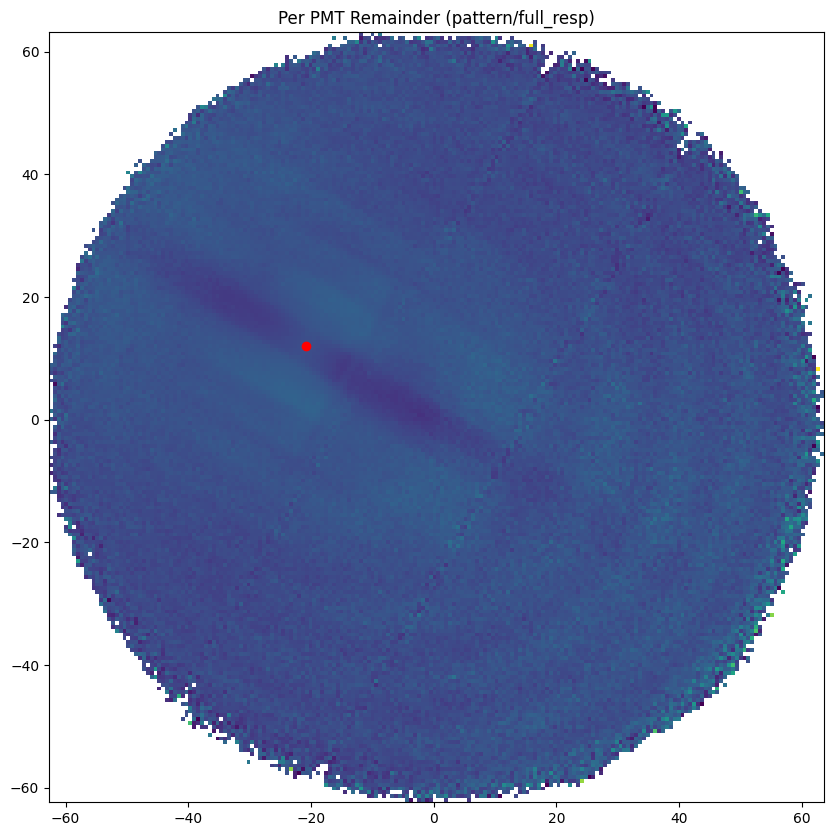

In [18]:
# 2d histogram binning
from scipy.stats import binned_statistic_2d
test = remainder[:,126]
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower',extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][126,0],pmt_pos_top[not_dead_pmts][126,1], c='r')
plt.title("Per PMT Remainder (pattern/full_resp)")


Text(0.5, 1.0, 'Per PMT Remainder (pattern/full_resp)')

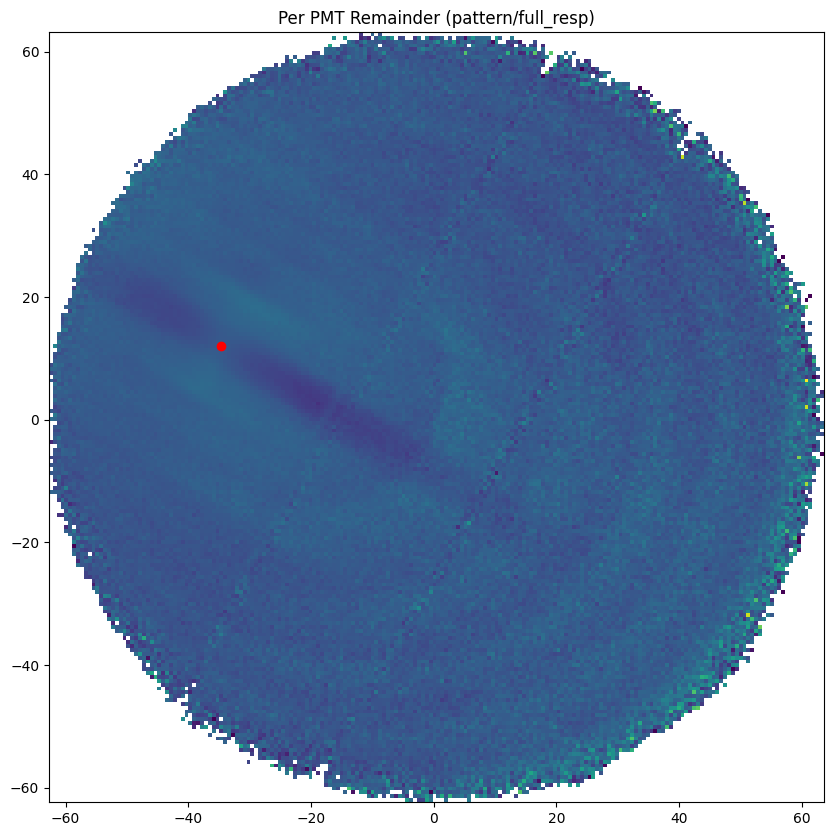

In [17]:
test = remainder[:,112]
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][112,0],pmt_pos_top[not_dead_pmts][112,1], c='r')
plt.title("Per PMT Remainder (pattern/full_resp)")


Text(0.5, 1.0, 'Per PMT Remainder (pattern/full_resp)')

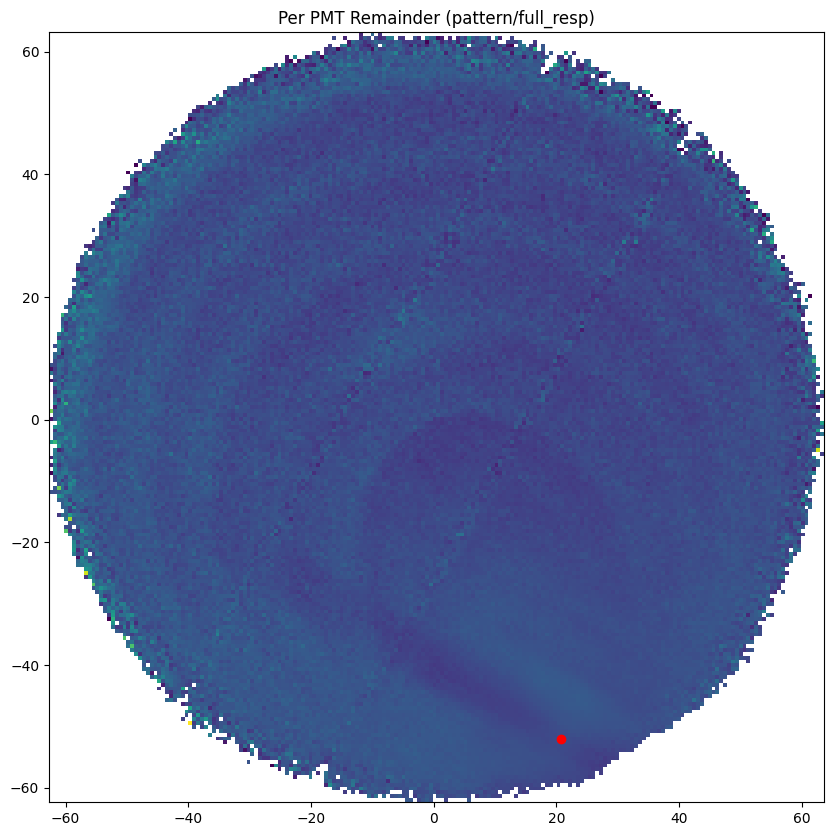

In [16]:
pmt_idx = 40
test = remainder[:,pmt_idx]
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][pmt_idx,0],pmt_pos_top[not_dead_pmts][pmt_idx,1], c='r')
plt.title("Per PMT Remainder (pattern/full_resp)")

Text(0.5, 1.0, 'Per PMT Remainder (pattern / r_response)')

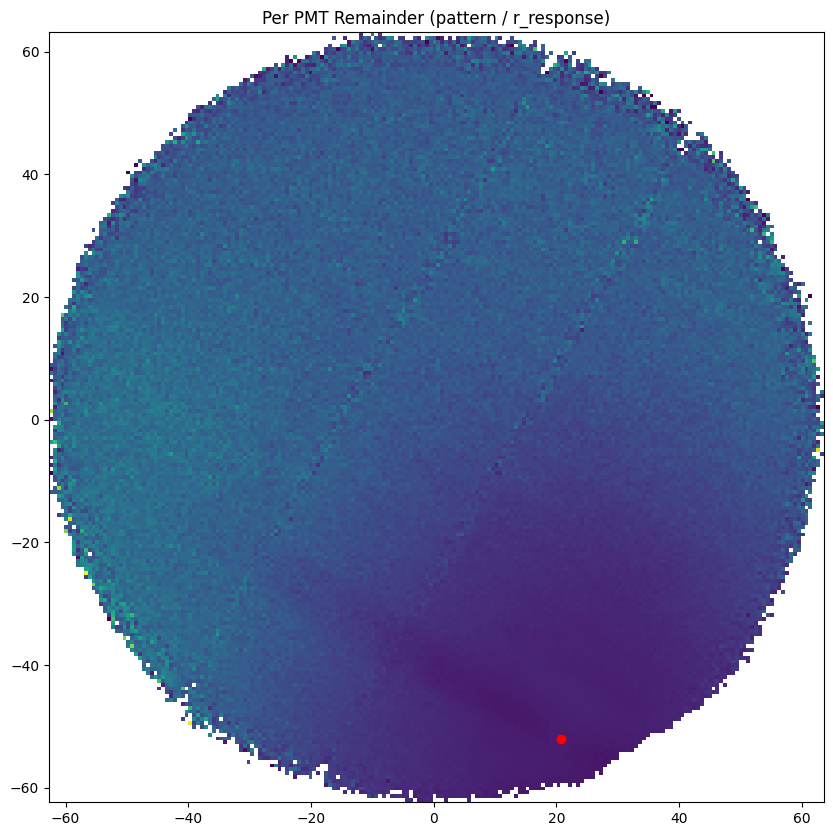

In [14]:
pmt_idx = 40
test = ((patterns/patterns.sum(axis=-1)[:,None])/r_resp)[:,pmt_idx]
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][pmt_idx,0],pmt_pos_top[not_dead_pmts][pmt_idx,1], c='r')
plt.title("Per PMT Remainder (pattern / r_response)")

Text(0.5, 1.0, 'Per PMT Remainder (pattern / wall_response)')

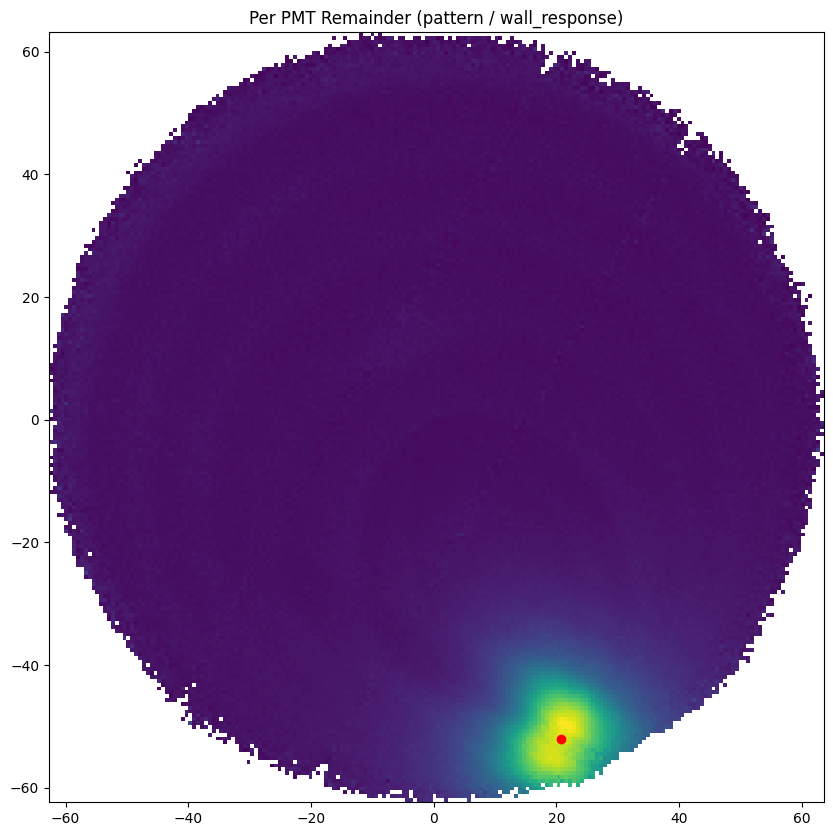

In [15]:
pmt_idx = 40
test = ((patterns/patterns.sum(axis=-1)[:,None])/wall_resp)[:,pmt_idx]
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][pmt_idx,0],pmt_pos_top[not_dead_pmts][pmt_idx,1], c='r')
plt.title("Per PMT Remainder (pattern / wall_response)")

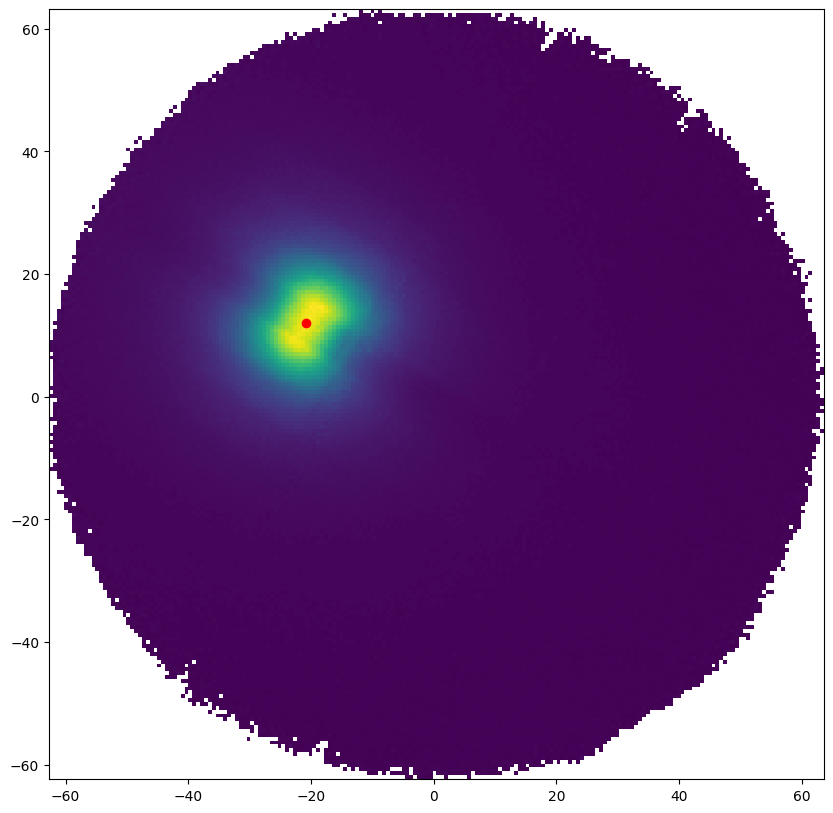

In [6]:
# 2d histogram binning
from scipy.stats import binned_statistic_2d
test = patterns[:,126] / patterns.sum(axis=-1)
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower',extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][126,0],pmt_pos_top[not_dead_pmts][126,1], c='r')

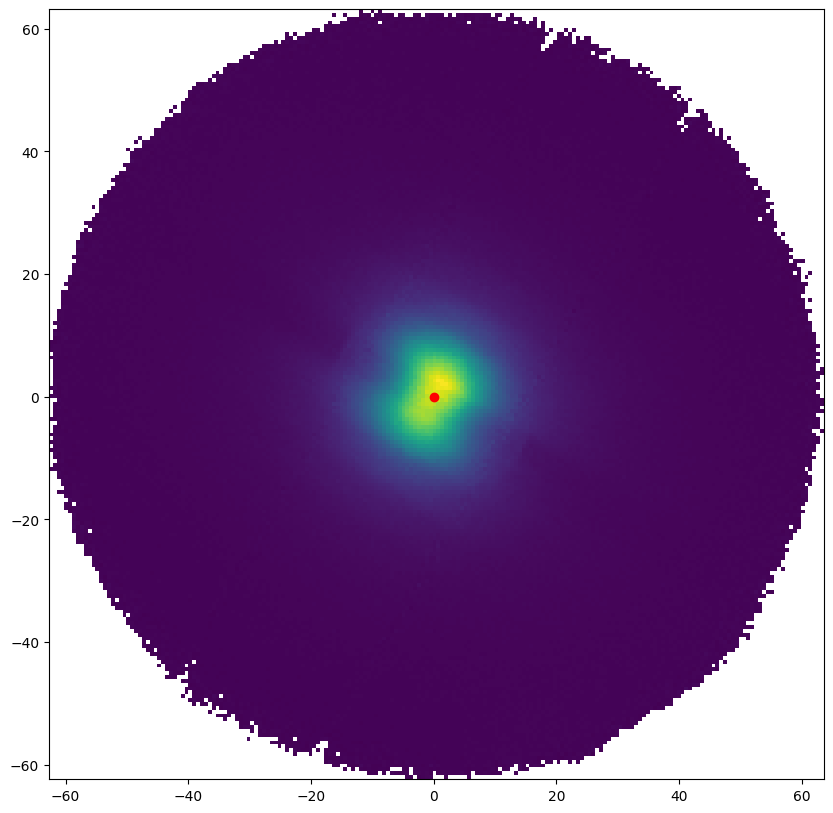

In [24]:
# 2d histogram binning
cidx = np.argwhere(np.array(not_dead_pmts)==126)
from scipy.stats import binned_statistic_2d
idx = np.argwhere(not_dead_pmts==126)
test = patterns[:,cidx[0,0]] / patterns.sum(axis=-1)
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower',extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][cidx[0,0],0],pmt_pos_top[not_dead_pmts][cidx[0,0],1], c='r')

In [27]:
radial_mc.summary()

Model: "Radial_mc"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 xx (InputLayer)             [(None, 2)]                  0         []                            
                                                                                                  
 repeat_vector (RepeatVecto  (None, 246, 2)               0         ['xx[0][0]']                  
 r)                                                                                               
                                                                                                  
 Event_Distance (GetRadius)  (None, 246)                  492       ['repeat_vector[0][0]']       
                                                                                                  
 radial_LCE (RadialLCELayer  (None, 246)                  4         ['Event_Distance[0][0]

In [19]:
r_mc_predict = keras.Model(inputs=radial_mc.get_layer('xx').input, outputs=radial_mc.get_layer('normalization').output).predict(pos)
remainder_norm =(patterns/np.sum(patterns, axis=-1)[:,None]) / r_mc_predict 

40317/40317 [==============================] - 40s 983us/step


Text(0.5, 1.0, 'Per PMT Remainder (pattern/Radial LCE)')

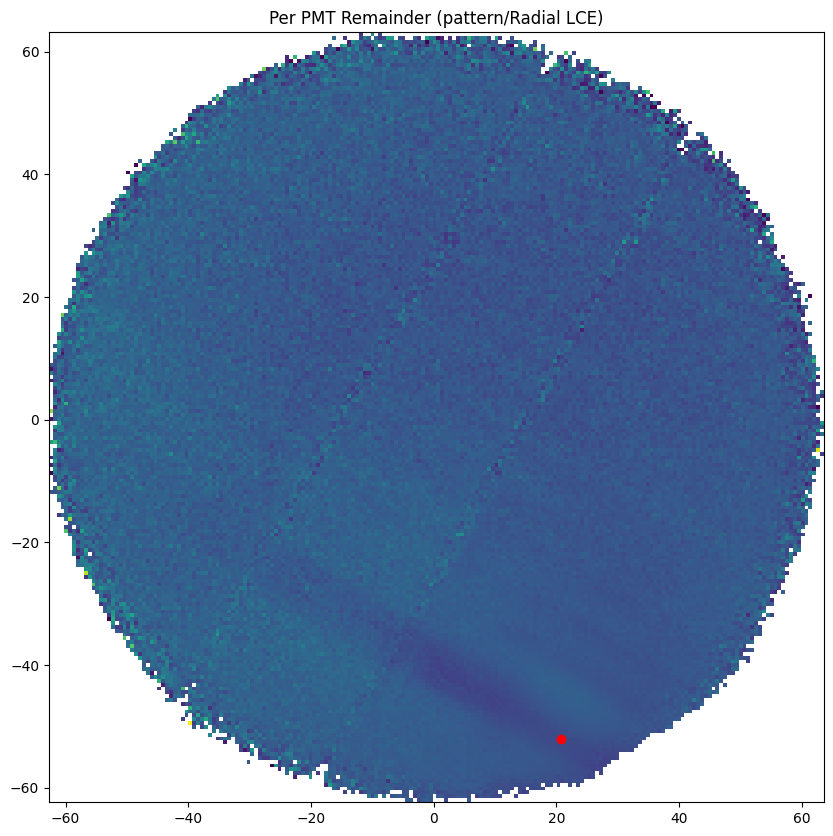

In [22]:
pmt_idx = 40
test = remainder_norm[:,pmt_idx]
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][pmt_idx,0],pmt_pos_top[not_dead_pmts][pmt_idx,1], c='r')
plt.title("Per PMT Remainder (pattern/Radial LCE)")

In [31]:
# Trials using only radial component
def tmp(seed, starting_model):
    tf.keras.utils.set_random_seed(seed)
    # Coordinate input  
    input_xy = tf.keras.layers.Input(shape=(2,), name='xy', dtype=tf.float32)
    x_PMT_dist_ =  gen_direct_detect_model()(input_xy)
    pattern = I0Layer(n_alive_pmts, name='i0')(x_PMT_dist_)
    pattern = NormalizationLayer(name='normalization')(pattern)
    input_pattern = tf.keras.layers.Input(shape=(246,), name='pattern', dtype=tf.float32)
    loss = LikelihoodMod(246, name="LossLayer")([pattern, input_pattern])
    model = tf.keras.Model(inputs=(input_xy, input_pattern), outputs=loss)
    model.layers[-1].set_weights(model_chi2.layers[-1].get_weights())
    model.layers[-1].trainable = False  
    model.get_layer('PMTDistance_Pattern_Response').set_weights(starting_model.get_layer('PMTDistance_Pattern_Response').get_weights())
    model.get_layer('i0').set_weights(starting_model.get_layer('i0').get_weights())
    return model
radial_only = tmp(seed, sim_data_base)
def loss_function(y_true, y_pred):
    return tf.reduce_mean(y_pred,axis=-1)
radial_only.compile(optimizer='adam', loss=loss_function)
radial_only.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100,
                callbacks=[
                    early_stopping, 
                    lr_reduce
                    ],
                )
tmp = keras.models.Model(inputs=radial_only.get_layer('xy').input, outputs=radial_only.get_layer('normalization').output)
llayer=get_minimal_Shenyang_Loss()
print("Scaled MSE: ", loss_function_MSE_scaled(Y / np.sum(Y, axis=-1)[:,None], tmp.predict(X)).numpy())
print("Shenyang Loss: ", np.mean(llayer({'prediction':tmp.predict(pos),'pattern':patterns})))

Epoch 1/100
2500/2500 [==============================] - 13s 4ms/step - loss: 1.0344 - val_loss: 1.0173 - lr: 0.0010
Epoch 2/100
2500/2500 [==============================] - 9s 4ms/step - loss: 1.0177 - val_loss: 1.0165 - lr: 0.0010
Epoch 3/100
2500/2500 [==============================] - 9s 4ms/step - loss: 1.0164 - val_loss: 1.0145 - lr: 0.0010
Epoch 4/100
2500/2500 [==============================] - 8s 3ms/step - loss: 1.0156 - val_loss: 1.0147 - lr: 0.0010
Epoch 5/100
2500/2500 [==============================] - 7s 3ms/step - loss: 1.0106 - val_loss: 1.0100 - lr: 1.0000e-04
Epoch 6/100
2500/2500 [==============================] - 7s 3ms/step - loss: 1.0106 - val_loss: 1.0105 - lr: 1.0000e-04
Epoch 7/100
3125/3125 [==============================] - 3s 1ms/step
Scaled MSE:  4.4668994
40317/40317 [==============================] - 55s 1ms/step
Shenyang Loss:  1.0172743


40317/40317 [==============================] - 50s 1ms/step


Text(0.5, 1.0, 'Per PMT Remainder (pattern / r_response (trained r only))')

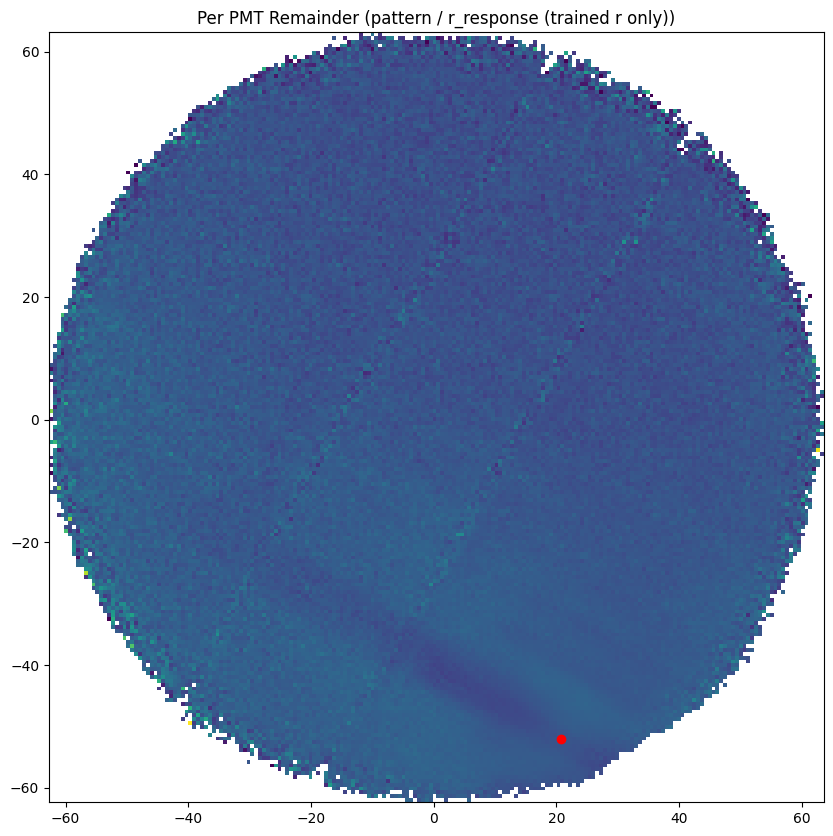

In [32]:
pmt_idx = 40
test = ((patterns/patterns.sum(axis=-1)[:,None])/tmp.predict(pos))[:,pmt_idx]
# Do 2D binning on test
stat = binned_statistic_2d(pos[:,0], pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][pmt_idx,0],pmt_pos_top[not_dead_pmts][pmt_idx,1], c='r')
plt.title("Per PMT Remainder (pattern / r_response (trained r only))")

In [ ]:
"""
So it seems adding a wall reflection term actually makes the predictions worse by 0.007 only but still 

And this prediction is virtually identical to the Radial LCE - TODO check proper

So what is this missing term

We have darkened responses along the PMT Row, question is why 
-> Maybe refit pos, refit network, refit pos will actually get rid of this 

A basic model for anode shadow might do something, however, its improvement magnitude will be very small 

I assume a model for perp wire shadowing will be usefull, however, again, magnitude will be very small

For both selecting only events below them will likely increase the effect
"""

In [37]:
def make_encoder(model, x, y):
    n_to_update = len(x)
    input_x = keras.layers.Input(shape=(1,))
    # Position embedding
    m = keras.layers.Embedding(n_to_update, 2, input_length = 1, name='embed_pos')(input_x)
    # Pattern Embedding
    pat = keras.layers.Embedding(n_to_update, n_alive_pmts, input_length = 1, name='embed_pat')(input_x)
    m = keras.layers.Flatten()(m)
    pat = keras.layers.Flatten()(pat)
    m = model({'xy': m, 'pattern':pat})
    rlce_encoder = keras.models.Model(inputs= input_x, outputs=m, name="Position_Updater")
    # radial mc 
    rlce_encoder.layers[-1].trainable = False
    rlce_encoder.get_layer('embed_pos').set_weights([x])
    rlce_encoder.get_layer('embed_pat').set_weights([y])
    rlce_encoder.get_layer('embed_pat').trainable = False
    return rlce_encoder
early_stopping = EarlyStopping(monitor='loss', patience=6, min_delta=0.5, restore_best_weights=True)
lr_reduce = ReduceLROnPlateau(monitor='loss', factor = 0.1, patience=3, min_delta=1)
encoder_model = make_encoder(radial_only, pos, patterns)
encoder_model.compile(optimizer='adam', loss=loss_function)
encoder_model.fit(np.arange(len(pos)), patterns, epochs=100, batch_size=32*4
                  ,callbacks=[
                      early_stopping, 
                        lr_reduce
                        ],
                      )

Epoch 1/100
10080/10080 [==============================] - 94s 9ms/step - loss: 1.0173 - lr: 0.0010
Epoch 2/100
10080/10080 [==============================] - 89s 9ms/step - loss: 1.0161 - lr: 0.0010
Epoch 3/100
10080/10080 [==============================] - 87s 9ms/step - loss: 1.0151 - lr: 0.0010
Epoch 4/100
10080/10080 [==============================] - 88s 9ms/step - loss: 1.0143 - lr: 0.0010
Epoch 5/100
10080/10080 [==============================] - 90s 9ms/step - loss: 1.0137 - lr: 1.0000e-04
Epoch 6/100
10080/10080 [==============================] - 86s 9ms/step - loss: 1.0137 - lr: 1.0000e-04
Epoch 7/100
10080/10080 [==============================] - 92s 9ms/step - loss: 1.0136 - lr: 1.0000e-04


40317/40317 [==============================] - 77s 2ms/step


Text(0.5, 1.0, 'Per PMT Remainder (pattern / r_response (trained r only))')

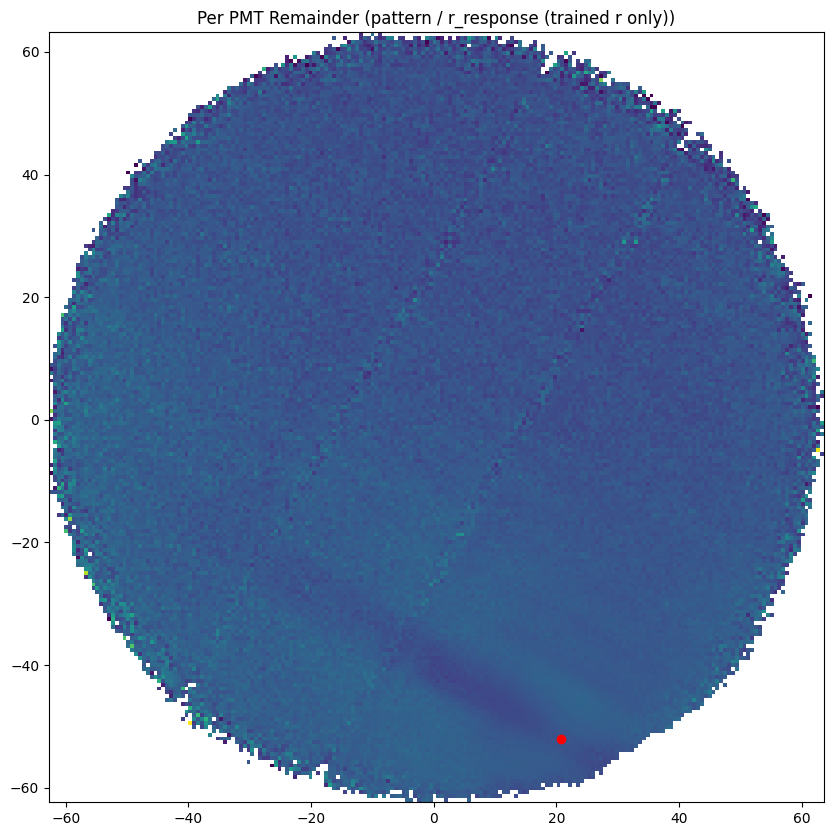

In [38]:
new_pos = encoder_model.get_layer('embed_pos').get_weights()[0]
tmp = keras.models.Model(inputs=radial_only.get_layer('xy').input, outputs=radial_only.get_layer('normalization').output)

pmt_idx = 40
test = ((patterns/patterns.sum(axis=-1)[:,None])/tmp.predict(new_pos))[:,pmt_idx]
# Do 2D binning on test
stat = binned_statistic_2d(new_pos[:,0], new_pos[:,1], test, statistic='mean', bins=200)
# Plot stat
fig, ax = plt.subplots(1,1, figsize=(10,10))
im = ax.imshow(stat.statistic.T, origin='lower', extent=[stat.x_edge[0],stat.x_edge[-1],stat.y_edge[0],stat.y_edge[-1]])
plt.scatter(pmt_pos_top[not_dead_pmts][pmt_idx,0],pmt_pos_top[not_dead_pmts][pmt_idx,1], c='r')
plt.title("Per PMT Remainder (pattern / r_response (trained r only))")

In [ ]:
pattern_model_in_parts = keras.Model(inputs = model_in_parts.input, outputs=model_in_parts.layers[-3].output)
pred_tmp = model_in_parts.predict(X_val)
if type(pred_tmp)==tuple:
    pred = pred_tmp[1]
else:
    pred = pred_tmp

63/63 [==============================] - 0s 3ms/step


IndexError: invalid index to scalar variable.

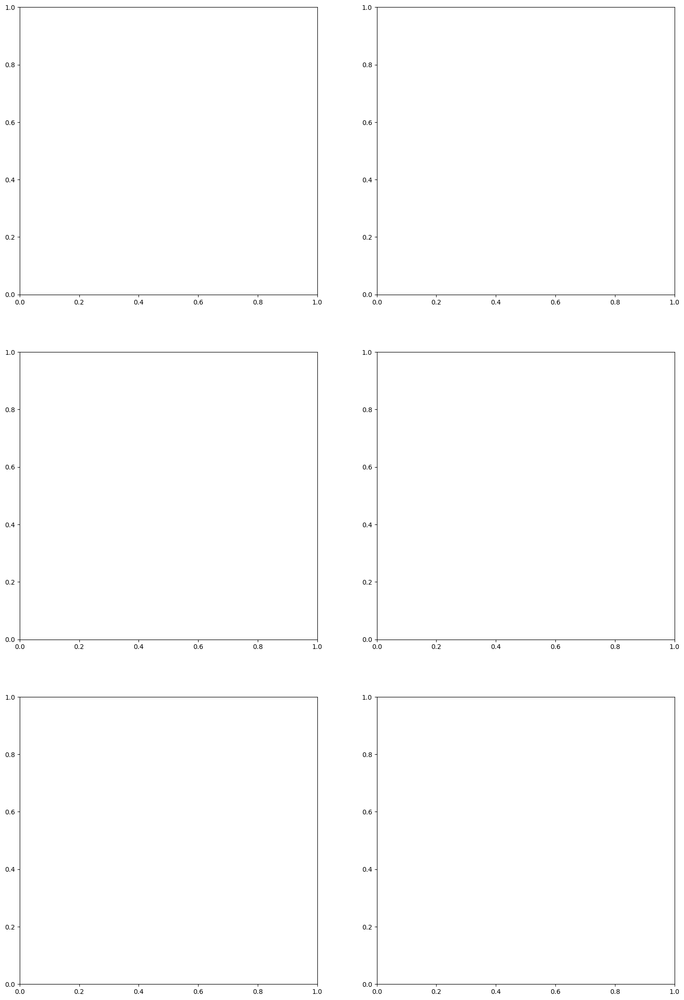

In [207]:
fig, ax =plt.subplots(3,2, figsize=(18,27))

# Random idx from validation set
idx = np.random.randint(0, len(X_val)) # np.argwhere(np.sum(X_val**2, axis=-1) > 60**2)[0][0]#

plot_pmt_response(pmt_pos_top[not_dead_pmts], pred[idx], ax=ax[0,0],mark_spot=X_val['xy'][idx], title="Prediction")
plot_pmt_response(pmt_pos_top[not_dead_pmts], Y_val[idx], ax=ax[0,1],mark_spot=X_val['xy'][idx], title="Y")

r_resp = model_in_parts.layers[1].predict(X_val['xy'][idx].reshape(1,2))[0]
wall_resp = model_in_parts.layers[2].predict(X_val['xy'][idx].reshape(1,2))[0]
plot_pmt_response(pmt_pos_top[not_dead_pmts], r_resp, ax=ax[1,0],mark_spot=X_val['xy'][idx], title="Radial Component")
plot_pmt_response(pmt_pos_top[not_dead_pmts], wall_resp * model_in_parts.get_layer("MultiplicationLayer").weights[0][-1].numpy(), ax=ax[1,1],mark_spot=X_val['xy'][idx], title="Wall Reflection Component * scaling parameter")

ax[2,0].hist(r_resp, bins=100)
ax[2,1].hist(wall_resp, bins=100)

plt.tight_layout()
plt.show()

In [332]:
model_in_parts2 = gen_model_full(seed=seed, starting_model=model_in_parts)
# Anode Layer n wires seems very wrong but could eb the case im not sure 
print(model_in_parts2.layers[-3].get_weights())
model_in_parts2.summary()

[array([0.25746173], dtype=float32)]
Model: "model_102"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 xy (InputLayer)             [(None, 2)]                  0         []                            
                                                                                                  
 PMTDistance_Pattern_Respon  (None, 246)                  813       ['xy[0][0]']                  
 se (Functional)                                                                                  
                                                                                                  
 Wall_Reflection_Pattern_Re  (None, 246)                  830       ['xy[0][0]']                  
 sponse (Functional)                                                                              
                                                     

In [333]:
# We need to disable training on the trained params
model_in_parts2.layers[1].trainable = False
model_in_parts2.layers[2].trainable = False

In [334]:
model_in_parts2.layers[3].summary()

Model: "PerpendicularWire_Pattern_Response"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 xy_3 (InputLayer)           [(None, 2)]               0         
                                                                 
 perpendicular_wire__parame  (None, 246, 7)            0         
 trization_6 (Perpendicular                                      
 Wire_Parametrization)                                           
                                                                 
 perp_dense_1 (Dense)        (None, 246, 16)           128       
                                                                 
 perp_dense_2 (Dense)        (None, 246, 16)           272       
                                                                 
 perp_dense_3 (Dense)        (None, 246, 1)            17        
                                                                 
 reshape_39 (Reshape)        (No

Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [335]:
model_in_parts2.compile(optimizer=Adam(learning_rate=0.01), loss=loss_function)
model_in_parts2.fit(X_train, Y_train, validation_data=(X_val, Y_val), epochs=100, callbacks=[early_stopping, lr_reduce], batch_size=128)

Epoch 1/100
625/625 [==============================] - 4s 5ms/step - loss: 17.9936 - val_loss: 10.3657 - lr: 0.0100
Epoch 2/100
625/625 [==============================] - 3s 5ms/step - loss: 9.6576 - val_loss: 7.6592 - lr: 0.0100
Epoch 3/100
625/625 [==============================] - 3s 5ms/step - loss: 8.8750 - val_loss: 8.5111 - lr: 0.0100
Epoch 4/100
625/625 [==============================] - 3s 6ms/step - loss: 8.0193 - val_loss: 7.4563 - lr: 0.0100
Epoch 5/100
625/625 [==============================] - 3s 5ms/step - loss: 8.0980 - val_loss: 7.2378 - lr: 0.0100
Epoch 6/100
625/625 [==============================] - 3s 5ms/step - loss: 5.8268 - val_loss: 4.7305 - lr: 1.0000e-03
Epoch 7/100
625/625 [==============================] - 3s 5ms/step - loss: 4.7692 - val_loss: 4.5540 - lr: 1.0000e-03
Epoch 8/100
625/625 [==============================] - 3s 5ms/step - loss: 4.7235 - val_loss: 4.5525 - lr: 1.0000e-03
Epoch 9/100
625/625 [==============================] - 3s 5ms/step - loss:

In [336]:
pred = model_in_parts2.predict(X_val)

625/625 [==============================] - 1s 2ms/step


1/1 [==============================] - 0s 11ms/step


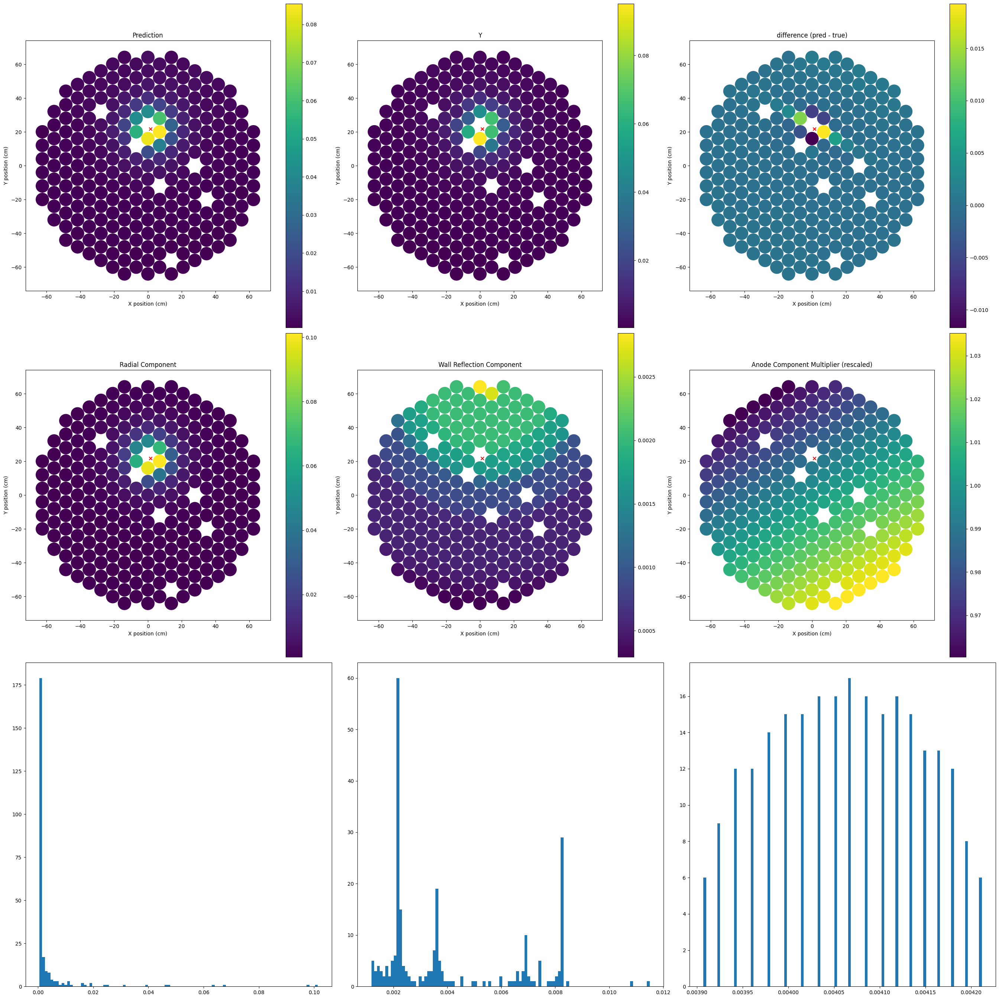

In [340]:
fig, ax =plt.subplots(3,3, figsize=(27,27))

# Random idx from validation set
idx = np.random.randint(0, len(pred))

plot_pmt_response(pmt_pos_top[not_dead_pmts], pred[idx], ax=ax[0,0],mark_spot=X_val[idx], title="Prediction")
plot_pmt_response(pmt_pos_top[not_dead_pmts], Y_val[idx], ax=ax[0,1],mark_spot=X_val[idx], title="Y")
plot_pmt_response(pmt_pos_top[not_dead_pmts], pred[idx]-Y_val[idx], ax=ax[0,2],mark_spot=X_val[idx], title="difference (pred - true)")

r_resp = model_in_parts2.layers[1].predict(X_val[idx].reshape(1,2))[0]
wall_resp = model_in_parts2.layers[2].predict(X_val[idx].reshape(1,2))[0]
anode_resp = model_in_parts2.layers[3].predict(X_val[idx].reshape(1,2))[0]
plot_pmt_response(pmt_pos_top[not_dead_pmts], r_resp, ax=ax[1,0],mark_spot=X_val[idx], title="Radial Component")
plot_pmt_response(pmt_pos_top[not_dead_pmts], wall_resp * model_in_parts2.get_layer("MultiplicationLayer").weights[0][-1].numpy(), ax=ax[1,1],mark_spot=X_val[idx], title="Wall Reflection Component")
plot_pmt_response(pmt_pos_top[not_dead_pmts], anode_resp / np.sort(anode_resp)[len(anode_resp)//2], ax=ax[1,2],mark_spot=X_val[idx], title="Anode Component Multiplier (rescaled)")

ax[2,0].hist(r_resp, bins=100)
ax[2,1].hist(wall_resp, bins=100)
ax[2,2].hist(anode_resp, bins=100)

plt.tight_layout()
plt.show()

<Axes: title={'center': 'Perc Diff'}, xlabel='X position (cm)', ylabel='Y position (cm)'>

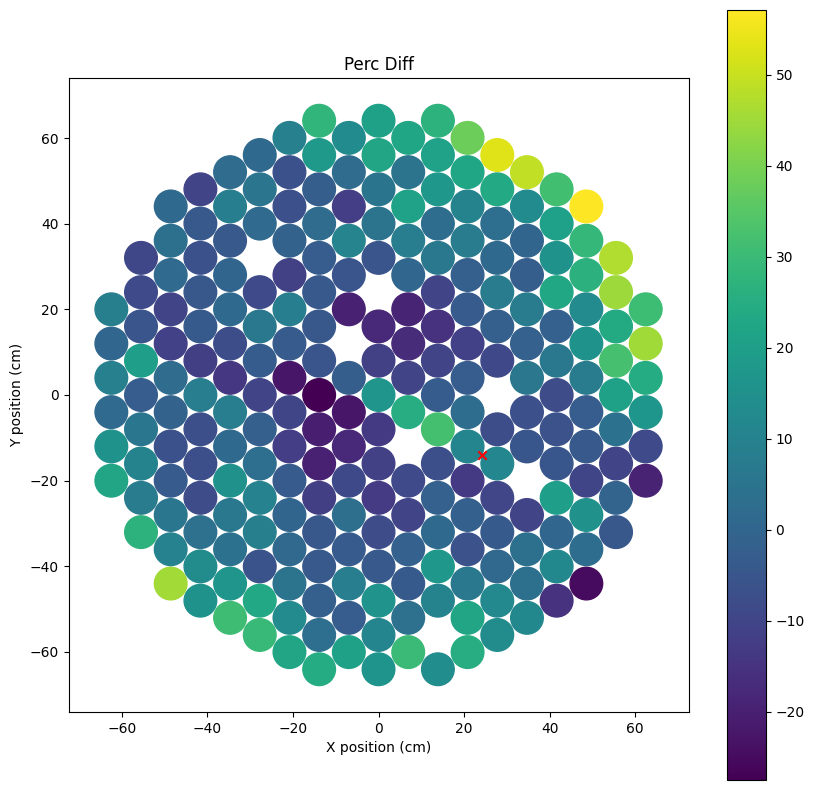

In [14]:
plot_pmt_response(pmt_pos_top[not_dead_pmts], 100*(pred[idx]-Y_val[idx])/Y_val[idx],mark_spot=X_val[idx], title="Perc Diff")

24493/24493 [==============================] - 49s 2ms/step


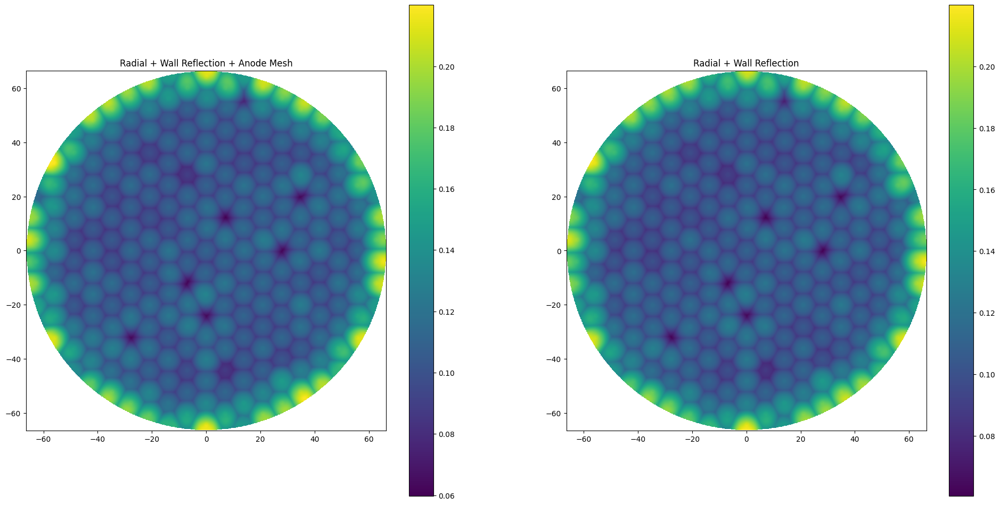

In [83]:
# Plot as image for coordinates in pos

fig,ax = plt.subplots(1,2, figsize=(24,12))
grid = np.linspace(-66.4, 66.4, 1000)
X,Y = np.meshgrid(grid,grid)
# Make shape n,2
pos_tmp = np.stack([X.flatten(),Y.flatten()], axis=1)
tmp = np.zeros((len(pos_tmp)))

tmp[(np.linalg.norm(pos_tmp,axis=-1) < 66.4)] = np.max(model_in_parts2.predict(pos_tmp[(np.linalg.norm(pos_tmp,axis=-1) < 66.4)]), axis=-1)
tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4)] = np.nan
tmp = np.reshape(tmp, X.shape)
# Plot 
tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4).reshape(tmp.shape)] = np.nan
ax[0].set_title("Radial + Wall Reflection + Anode Mesh")
ax[0].imshow(tmp, extent=(-66.4,66.4,-66.4,66.4),aspect='equal')
# Add cmap bar
# Add colorbar for axes
cbar = plt.colorbar(ax[0].imshow(tmp, extent=(-66.4,66.4,-66.4,66.4),aspect='equal'))

tmp = np.zeros((len(pos_tmp)))
tmp[(np.linalg.norm(pos_tmp,axis=-1) < 66.4)] = np.max(model_in_parts.predict(pos_tmp[(np.linalg.norm(pos_tmp,axis=-1) < 66.4)]), axis=-1)
tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4)] = np.nan
tmp = np.reshape(tmp, X.shape)
# Plot 
tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4).reshape(tmp.shape)] = np.nan
ax[1].imshow(tmp, extent=(-66.4,66.4,-66.4,66.4),aspect='equal')
cbar = plt.colorbar(ax[1].imshow(tmp, extent=(-66.4,66.4,-66.4,66.4),aspect='equal'))
ax[1].set_title("Radial + Wall Reflection")
plt.show()

24493/24493 [==============================] - 44s 2ms/step


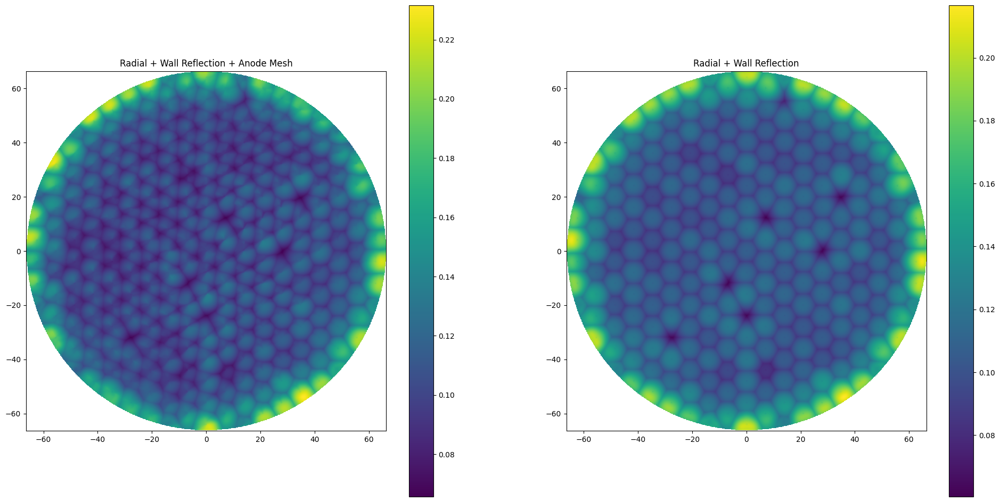

In [92]:
# Plot as image for coordinates in pos

"""
Generated with Shenyangs Variable inputs
and per PMT convolutional Layers

Also Anode shadow was a direct multiplier to the entire pattern rather than *(1+anode_shadow*scale_param)


"""

fig,ax = plt.subplots(1,2, figsize=(24,12))
grid = np.linspace(-66.4, 66.4, 1000)
X,Y = np.meshgrid(grid,grid)
# Make shape n,2
pos_tmp = np.stack([X.flatten(),Y.flatten()], axis=1)
tmp = np.zeros((len(pos_tmp)))

tmp[(np.linalg.norm(pos_tmp,axis=-1) < 66.4)] = np.max(model_in_parts2.predict(pos_tmp[(np.linalg.norm(pos_tmp,axis=-1) < 66.4)]), axis=-1)
tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4)] = np.nan
tmp = np.reshape(tmp, X.shape)
# Plot 
tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4).reshape(tmp.shape)] = np.nan
ax[0].set_title("Radial + Wall Reflection + Anode Mesh")
ax[0].imshow(tmp, extent=(-66.4,66.4,-66.4,66.4),aspect='equal')
# Add cmap bar
# Add colorbar for axes
cbar = plt.colorbar(ax[0].imshow(tmp, extent=(-66.4,66.4,-66.4,66.4),aspect='equal'))

tmp = np.zeros((len(pos_tmp)))
tmp[(np.linalg.norm(pos_tmp,axis=-1) < 66.4)] = np.max(model_in_parts.predict(pos_tmp[(np.linalg.norm(pos_tmp,axis=-1) < 66.4)]), axis=-1)
tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4)] = np.nan
tmp = np.reshape(tmp, X.shape)
# Plot 
tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4).reshape(tmp.shape)] = np.nan
ax[1].imshow(tmp, extent=(-66.4,66.4,-66.4,66.4),aspect='equal')
cbar = plt.colorbar(ax[1].imshow(tmp, extent=(-66.4,66.4,-66.4,66.4),aspect='equal'))
ax[1].set_title("Radial + Wall Reflection")
plt.show()

625/625 [==============================] - 1s 1ms/step


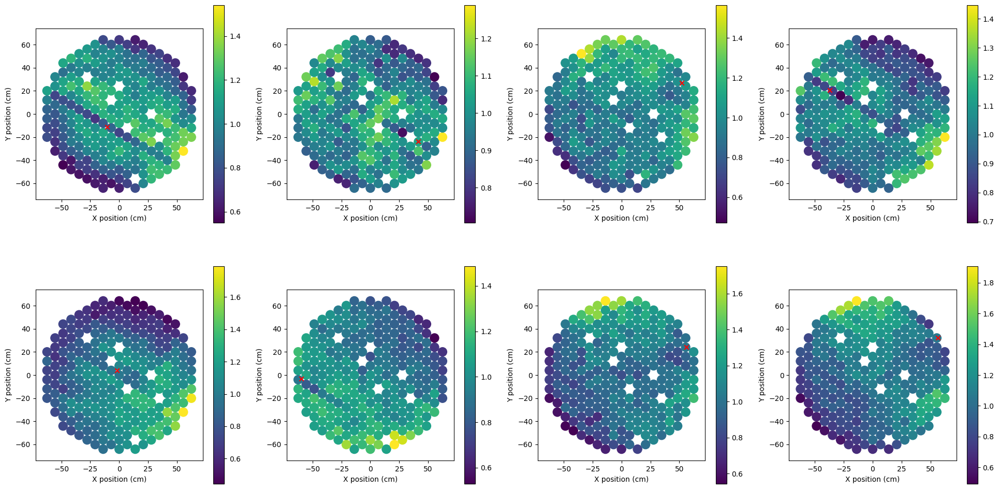

In [ ]:
# Try Dividing out Model 1

model1_pred = model_in_parts.predict(X_val)

residual = Y_val / model1_pred

fig, ax = plt.subplots(2,4, figsize=(24,12))

ax = ax.flatten()

for i in ax:
    idx = np.random.randint(0, len(Y_val))
    plot_pmt_response(pmt_pos_top[not_dead_pmts], residual[idx], ax=i, mark_spot=X_val[idx])

In [ ]:
# Lets see what happens if we select closest PMT modulation and make a heat plot
grid = np.linspace(-66.4, 66.4, 1000)
X,Y = np.meshgrid(grid,grid)
pos_tmp = np.stack([X.flatten(),Y.flatten()], axis=1)

tmp = np.zeros((len(pos_tmp)))
in_circle = (np.linalg.norm(pos_tmp,axis=-1) < 66.4)

# Compute ratio for closest PMT 
closest_pmts = np.argmin(np.linalg.norm(pmt_pos_top[not_dead_pmts][None,:,:] - pos_tmp[in_circle][:,None,:], axis=-1), axis=-1)
tmp[in_circle] = model_pattern.predict(pos_tmp[in_circle])[np.arange(len(tmp[in_circle])),closest_pmts] / model_in_parts.predict(pos_tmp[in_circle])[np.arange(len(tmp[in_circle])),closest_pmts]

tmp[(np.linalg.norm(pos_tmp,axis=-1) > 66.4)] = np.nan
tmp = np.reshape(tmp, X.shape)

Text(0.5, 1.0, 'Closest PMT Modulation by residual')

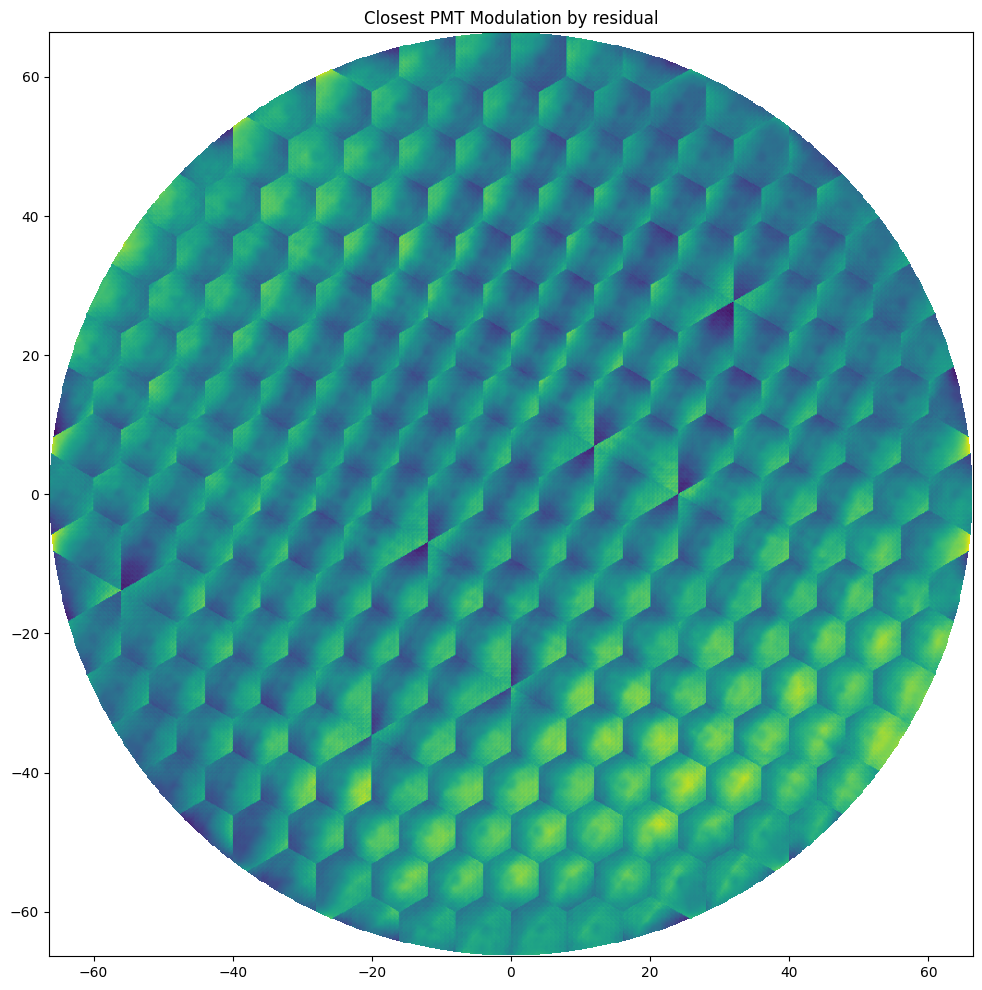

In [114]:
fig = plt.figure(figsize=(12,12))

plt.imshow(tmp.T, extent=(-66.4,66.4,-66.4,66.4),aspect='equal')
plt.title("Closest PMT Modulation by residual")

# New Loss


The following variables are required and potentially unknown:
- probability double photon emission : 0.2 - Check in literature but 0.2 should be fine - could also do as a secondary fit param per PMT  
- 1 sigma photoelectron ie guassian standard deviation 
- minimum for clipping 0 is fine 

# MC Interlude - Move to New File maybe redo official LCE note keepin all results

In [2]:
realish_data = model_pattern.predict(pos)
downloader = straxen.MongoDownloader()
map_file = downloader.download_single("XENONnT_s2_xy_patterns_LCE_corrected_qes_MCva43fa9b_wires.pkl")
map_data = straxen.get_resource(map_file, fmt="pkl")
map_interp = straxen.InterpolatingMap(map_data,method='RegularGridInterpolator') 

mc_map_data = map_interp(pos)[:,not_dead_pmts] 
mc_map_data /= np.sum(mc_map_data,axis=-1)[:,None]

3125/3125 [==============================] - 7s 2ms/step


/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/core/events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/core/events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/XENONnT/anaconda/envs/XENONnT_el9.2024.10.4/lib/python3.9/site-packages/IPython/core/pylabtools.p

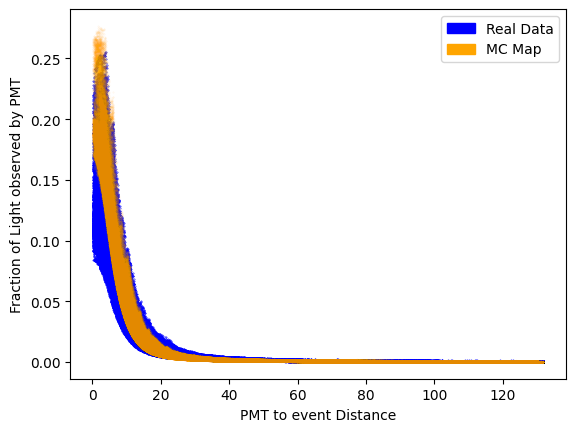

In [3]:
# Event PMT distance
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt




shapely_pmt_pos = np.reshape(pmt_pos_top[not_dead_pmts,:], (1,246,2))
rdist = np.linalg.norm(pos[:,None] - shapely_pmt_pos,axis=-1)

plt.scatter(rdist.flatten(), realish_data.flatten(), label="Real Data", c= 'blue',s=0.1)
# Add custom handles to legend
red_patch = mpatches.Patch(color='blue', label='Real Data')

plt.scatter(rdist.flatten(), mc_map_data.flatten(), label="Monte Carlo Data",c='orange', s=0.1, alpha=0.1)
red_patch2 = mpatches.Patch(color='orange', label='MC Map')
plt.xlabel("PMT to event Distance")
plt.ylabel("Fraction of Light observed by PMT")
plt.legend(handles=[red_patch, red_patch2])

In [ ]:
# TODO Check Real Data